In [1]:
import requests
import collections
import pandas as pd
import scipy as sc
import sklearn
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import xml.etree.ElementTree as ET
%matplotlib inline

In [2]:
import keras
import tensorflow as tf
from keras.layers import *
from keras.optimizers import Adam

Using TensorFlow backend.


In [5]:
df_love = pd.read_csv("save_love.csv")
df_science = pd.read_csv("save_science.csv")
df_poetry = pd.read_csv("save_poetry.csv")
df_detective = pd.read_csv("save_detective.csv", encoding = "ISO-8859-1") 

In [7]:
choice = [i for i in range(1,24)]
array_love = df_love.iloc[:,choice]
array_love = array_love.values
rating_love = df_love.iloc[:,24]
rating_love = rating_love.values
array_science = df_science.iloc[:,choice]
array_science = array_science.values
rating_science = df_science.iloc[:,24]
rating_science = rating_science.values
array_poetry = df_poetry.iloc[:,choice]
array_poetry = array_poetry.values
rating_poetry = df_poetry.iloc[:,24]
rating_poetry = rating_poetry.values
array_detective = df_detective.iloc[:, choice]
array_detective = array_detective.values
rating_detective = df_detective.iloc[:,24]
rating_detective = rating_detective.values

In [8]:
print(array_love.shape)
print(rating_love.shape)
print(array_science.shape)
print(rating_science.shape)
print(array_poetry.shape)
print(rating_poetry.shape)
print(array_detective.shape)
print(rating_detective.shape)

(534, 23)
(534,)
(1295, 23)
(1295,)
(817, 23)
(817,)
(517, 23)
(517,)


In [9]:
array_x_1 = np.append(array_love.reshape(-1,23,1), array_science.reshape(-1,23,1), axis=0)
array_y_1 = np.append(rating_love.reshape(-1,1), rating_science.reshape(-1,1), axis=0)
array_x_2 = np.append(array_poetry.reshape(-1,23,1), array_detective.reshape(-1,23,1), axis=0)
array_y_2 = np.append(rating_poetry.reshape(-1,1), rating_science.reshape(-1,1), axis=0)
array_x = np.append(array_x_1, array_x_2, axis=0)
array_y = np.append(array_y_1, array_y_2, axis=0)

In [10]:
# normlize the x 
array_x_norm = (array_x - array_x.min(axis=0)) / (array_x.max(axis=0) - array_x.min(axis=0))

In [11]:
rating_mean = array_y.mean(axis=0)
rating_mean = rating_mean

In [12]:
import math
def rating_norm(x):
    x_norm = (x - rating_mean)
    sigmoid = 1 / (1 + math.exp(-x_norm))
    return sigmoid
def rating_back(y):
    try:
        x_norm = -1 * math.log((1/y - 1))
        x = x_norm + rating_mean
        return x
    except:
        return 5.0

In [14]:
array_y_norm = [rating_norm(x) for x in array_y]
array_y_norm =  np.array(array_y_norm).reshape(-1,1)

In [15]:
import random
index = [i for i in range(len(array_x))]  
random.shuffle(index) 
a = int(len(index)*0.95)
train_index = index[:a]
test_index = index[a:]

x_train_norm = array_x_norm[train_index]
x_test_norm = array_x_norm[test_index]
y_train_norm = array_y_norm[train_index]
y_test_norm = array_y_norm[test_index]

In [17]:
print(x_train_norm.shape)
print(y_train_norm.shape)
print(x_test_norm.shape)
print(y_test_norm.shape)

(3004, 23, 1)
(3004, 1)
(159, 23, 1)
(159, 1)


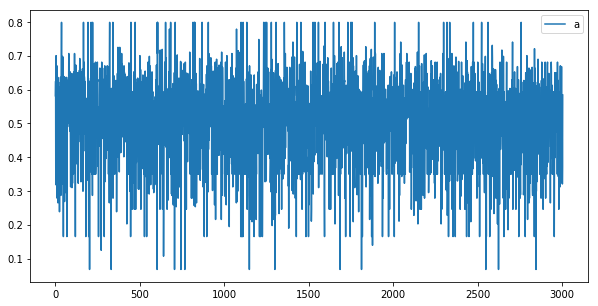

In [19]:
pd.DataFrame(y_train_norm,columns=["a"]).plot(figsize=(10,5))

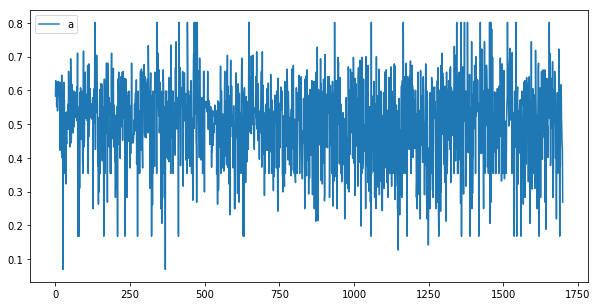

In [52]:
pd.DataFrame(y_train_norm,columns=["a"]).plot(figsize=(10,5))

In [28]:
model = keras.Sequential()
model.add(Dense(32, activation='relu',kernel_initializer="uniform", input_shape=(23, 1)))
model.add(Dense(64, activation='relu',kernel_initializer="uniform"))
model.add(Dense(32, activation='relu', kernel_initializer="uniform"))
model.add(Dense(16, activation='relu', kernel_initializer="uniform"))
model.add(Flatten())
model.add(Dense(8, activation='relu', kernel_initializer="uniform"))
# model.add(Flatten())
model.add(Dense(1, kernel_initializer="uniform"))
# model.add(Activation("relu"))
adam = Adam(lr=0.001)

In [29]:
model.compile(optimizer=adam,loss='mean_squared_error',metrics=['mae', 'mse'])
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_7 (Dense)              (None, 23, 32)            64        
_________________________________________________________________
dense_8 (Dense)              (None, 23, 64)            2112      
_________________________________________________________________
dense_9 (Dense)              (None, 23, 32)            2080      
_________________________________________________________________
dense_10 (Dense)             (None, 23, 16)            528       
_________________________________________________________________
flatten_2 (Flatten)          (None, 368)               0         
_________________________________________________________________
dense_11 (Dense)             (None, 8)                 2952      
_________________________________________________________________
dense_12 (Dense)             (None, 1)                 9         
Total para

In [30]:
# import random
# index = [i for i in range(len(x_train_norm))]  
# random.shuffle(index) 
# x_train_shuffle = x_train_norm[index]
# y_train_shuffle = y_train_norm[index]
# x_train_shuffle = np.append(x_train_shuffle, x_test_norm, axis=0)
# y_train_shuffle = np.append(y_train_shuffle, y_test_norm, axis=0)

In [33]:
from keras.callbacks import ReduceLROnPlateau
reduce_lr = ReduceLROnPlateau(monitor='mean_squared_error', patience=3000, mode='auto', min_lr=0.000001)
tensorboard = keras.callbacks.TensorBoard(
    log_dir='./logs', histogram_freq=0, batch_size=128, write_graph=True, write_grads=False, write_images=False, embeddings_freq=0, embeddings_layer_names=None, embeddings_metadata=None, embeddings_data=None, update_freq='epoch')

In [34]:
model.fit(x_train_norm, y_train_norm, batch_size=128, epochs=100000, callbacks=[tensorboard, reduce_lr])

Epoch 1/100000
3004/3004 [==============================] - 0s 137us/step - loss: 0.0156 - mean_absolute_error: 0.0979 - mean_squared_error: 0.0156
Epoch 2/100000
3004/3004 [==============================] - 0s 39us/step - loss: 0.0157 - mean_absolute_error: 0.0985 - mean_squared_error: 0.0157
Epoch 3/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0156 - mean_absolute_error: 0.0982 - mean_squared_error: 0.0156
Epoch 4/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0156 - mean_absolute_error: 0.0977 - mean_squared_error: 0.0156
Epoch 5/100000
3004/3004 [==============================] - 0s 39us/step - loss: 0.0156 - mean_absolute_error: 0.0984 - mean_squared_error: 0.0156
Epoch 6/100000
3004/3004 [==============================] - 0s 38us/step - loss: 0.0156 - mean_absolute_error: 0.0983 - mean_squared_error: 0.0156
Epoch 7/100000
3004/3004 [==============================] - 0s 39us/step - loss: 0.0156 - mean_absolute_error: 0.0981

3004/3004 [==============================] - 0s 40us/step - loss: 0.0155 - mean_absolute_error: 0.0975 - mean_squared_error: 0.0155
Epoch 57/100000
3004/3004 [==============================] - 0s 39us/step - loss: 0.0156 - mean_absolute_error: 0.0985 - mean_squared_error: 0.0156
Epoch 58/100000
3004/3004 [==============================] - 0s 36us/step - loss: 0.0156 - mean_absolute_error: 0.0985 - mean_squared_error: 0.0156
Epoch 59/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0156 - mean_absolute_error: 0.0980 - mean_squared_error: 0.0156
Epoch 60/100000
3004/3004 [==============================] - 0s 38us/step - loss: 0.0155 - mean_absolute_error: 0.0981 - mean_squared_error: 0.0155
Epoch 61/100000
3004/3004 [==============================] - 0s 37us/step - loss: 0.0155 - mean_absolute_error: 0.0977 - mean_squared_error: 0.0155
Epoch 62/100000
3004/3004 [==============================] - 0s 37us/step - loss: 0.0155 - mean_absolute_error: 0.0981 - mean_sq

3004/3004 [==============================] - 0s 42us/step - loss: 0.0155 - mean_absolute_error: 0.0979 - mean_squared_error: 0.0155
Epoch 111/100000
3004/3004 [==============================] - 0s 37us/step - loss: 0.0155 - mean_absolute_error: 0.0977 - mean_squared_error: 0.0155
Epoch 112/100000
3004/3004 [==============================] - 0s 37us/step - loss: 0.0155 - mean_absolute_error: 0.0979 - mean_squared_error: 0.0155
Epoch 113/100000
3004/3004 [==============================] - 0s 36us/step - loss: 0.0155 - mean_absolute_error: 0.0979 - mean_squared_error: 0.0155
Epoch 114/100000
3004/3004 [==============================] - 0s 35us/step - loss: 0.0155 - mean_absolute_error: 0.0978 - mean_squared_error: 0.0155
Epoch 115/100000
3004/3004 [==============================] - 0s 35us/step - loss: 0.0155 - mean_absolute_error: 0.0979 - mean_squared_error: 0.0155
Epoch 116/100000
3004/3004 [==============================] - 0s 34us/step - loss: 0.0155 - mean_absolute_error: 0.0979 - m

3004/3004 [==============================] - 0s 50us/step - loss: 0.0154 - mean_absolute_error: 0.0972 - mean_squared_error: 0.0154
Epoch 165/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0154 - mean_absolute_error: 0.0975 - mean_squared_error: 0.0154
Epoch 166/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0156 - mean_absolute_error: 0.0979 - mean_squared_error: 0.0156
Epoch 167/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0154 - mean_absolute_error: 0.0979 - mean_squared_error: 0.0154
Epoch 168/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0154 - mean_absolute_error: 0.0972 - mean_squared_error: 0.0154
Epoch 169/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0154 - mean_absolute_error: 0.0974 - mean_squared_error: 0.0154
Epoch 170/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0154 - mean_absolute_error: 0.0975 - m

3004/3004 [==============================] - 0s 59us/step - loss: 0.0153 - mean_absolute_error: 0.0971 - mean_squared_error: 0.0153
Epoch 220/100000
3004/3004 [==============================] - 0s 78us/step - loss: 0.0153 - mean_absolute_error: 0.0972 - mean_squared_error: 0.0153
Epoch 221/100000
3004/3004 [==============================] - 0s 73us/step - loss: 0.0153 - mean_absolute_error: 0.0968 - mean_squared_error: 0.0153
Epoch 222/100000
3004/3004 [==============================] - 0s 72us/step - loss: 0.0153 - mean_absolute_error: 0.0974 - mean_squared_error: 0.0153
Epoch 223/100000
3004/3004 [==============================] - 0s 75us/step - loss: 0.0154 - mean_absolute_error: 0.0971 - mean_squared_error: 0.0154
Epoch 224/100000
3004/3004 [==============================] - 0s 72us/step - loss: 0.0154 - mean_absolute_error: 0.0974 - mean_squared_error: 0.0154
Epoch 225/100000
3004/3004 [==============================] - 0s 72us/step - loss: 0.0154 - mean_absolute_error: 0.0974 - m

3004/3004 [==============================] - 0s 37us/step - loss: 0.0153 - mean_absolute_error: 0.0969 - mean_squared_error: 0.0153
Epoch 274/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0153 - mean_absolute_error: 0.0973 - mean_squared_error: 0.0153
Epoch 275/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0153 - mean_absolute_error: 0.0968 - mean_squared_error: 0.0153
Epoch 276/100000
3004/3004 [==============================] - 0s 39us/step - loss: 0.0153 - mean_absolute_error: 0.0972 - mean_squared_error: 0.0153
Epoch 277/100000
3004/3004 [==============================] - 0s 39us/step - loss: 0.0153 - mean_absolute_error: 0.0969 - mean_squared_error: 0.0153
Epoch 278/100000
3004/3004 [==============================] - 0s 39us/step - loss: 0.0153 - mean_absolute_error: 0.0973 - mean_squared_error: 0.0153
Epoch 279/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0153 - mean_absolute_error: 0.0968 - m

3004/3004 [==============================] - 0s 42us/step - loss: 0.0153 - mean_absolute_error: 0.0967 - mean_squared_error: 0.0153
Epoch 329/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0152 - mean_absolute_error: 0.0968 - mean_squared_error: 0.0152
Epoch 330/100000
3004/3004 [==============================] - 0s 39us/step - loss: 0.0152 - mean_absolute_error: 0.0970 - mean_squared_error: 0.0152
Epoch 331/100000
3004/3004 [==============================] - 0s 38us/step - loss: 0.0152 - mean_absolute_error: 0.0968 - mean_squared_error: 0.0152
Epoch 332/100000
3004/3004 [==============================] - 0s 39us/step - loss: 0.0152 - mean_absolute_error: 0.0966 - mean_squared_error: 0.0152
Epoch 333/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0152 - mean_absolute_error: 0.0969 - mean_squared_error: 0.0152
Epoch 334/100000
3004/3004 [==============================] - 0s 39us/step - loss: 0.0152 - mean_absolute_error: 0.0967 - m

3004/3004 [==============================] - 0s 35us/step - loss: 0.0151 - mean_absolute_error: 0.0966 - mean_squared_error: 0.0151
Epoch 384/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0154 - mean_absolute_error: 0.0971 - mean_squared_error: 0.0154
Epoch 385/100000
3004/3004 [==============================] - 0s 39us/step - loss: 0.0152 - mean_absolute_error: 0.0967 - mean_squared_error: 0.0152
Epoch 386/100000
3004/3004 [==============================] - 0s 36us/step - loss: 0.0152 - mean_absolute_error: 0.0971 - mean_squared_error: 0.0152
Epoch 387/100000
3004/3004 [==============================] - 0s 35us/step - loss: 0.0153 - mean_absolute_error: 0.0972 - mean_squared_error: 0.0153
Epoch 388/100000
3004/3004 [==============================] - 0s 36us/step - loss: 0.0151 - mean_absolute_error: 0.0965 - mean_squared_error: 0.0151
Epoch 389/100000
3004/3004 [==============================] - 0s 36us/step - loss: 0.0152 - mean_absolute_error: 0.0966 - m

3004/3004 [==============================] - 0s 46us/step - loss: 0.0153 - mean_absolute_error: 0.0968 - mean_squared_error: 0.0153
Epoch 439/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0151 - mean_absolute_error: 0.0965 - mean_squared_error: 0.0151
Epoch 440/100000
3004/3004 [==============================] - 0s 60us/step - loss: 0.0152 - mean_absolute_error: 0.0970 - mean_squared_error: 0.0152
Epoch 441/100000
3004/3004 [==============================] - 0s 53us/step - loss: 0.0151 - mean_absolute_error: 0.0963 - mean_squared_error: 0.0151
Epoch 442/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0151 - mean_absolute_error: 0.0962 - mean_squared_error: 0.0151
Epoch 443/100000
3004/3004 [==============================] - 0s 60us/step - loss: 0.0151 - mean_absolute_error: 0.0966 - mean_squared_error: 0.0151
Epoch 444/100000
3004/3004 [==============================] - 0s 52us/step - loss: 0.0151 - mean_absolute_error: 0.0963 - m

3004/3004 [==============================] - 0s 57us/step - loss: 0.0150 - mean_absolute_error: 0.0963 - mean_squared_error: 0.0150
Epoch 493/100000
3004/3004 [==============================] - 0s 52us/step - loss: 0.0151 - mean_absolute_error: 0.0963 - mean_squared_error: 0.0151
Epoch 494/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0151 - mean_absolute_error: 0.0964 - mean_squared_error: 0.0151
Epoch 495/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0151 - mean_absolute_error: 0.0965 - mean_squared_error: 0.0151
Epoch 496/100000
3004/3004 [==============================] - 0s 53us/step - loss: 0.0150 - mean_absolute_error: 0.0962 - mean_squared_error: 0.0150
Epoch 497/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0150 - mean_absolute_error: 0.0960 - mean_squared_error: 0.0150
Epoch 498/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0150 - mean_absolute_error: 0.0961 - m

3004/3004 [==============================] - 0s 50us/step - loss: 0.0150 - mean_absolute_error: 0.0962 - mean_squared_error: 0.0150
Epoch 548/100000
3004/3004 [==============================] - ETA: 0s - loss: 0.0149 - mean_absolute_error: 0.0959 - mean_squared_error: 0.01 - 0s 49us/step - loss: 0.0150 - mean_absolute_error: 0.0961 - mean_squared_error: 0.0150
Epoch 549/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0149 - mean_absolute_error: 0.0959 - mean_squared_error: 0.0149
Epoch 550/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0150 - mean_absolute_error: 0.0961 - mean_squared_error: 0.0150
Epoch 551/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0150 - mean_absolute_error: 0.0959 - mean_squared_error: 0.0150
Epoch 552/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0150 - mean_absolute_error: 0.0962 - mean_squared_error: 0.0150
Epoch 553/100000
3004/3004 [=============

3004/3004 [==============================] - 0s 50us/step - loss: 0.0150 - mean_absolute_error: 0.0958 - mean_squared_error: 0.0150
Epoch 602/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0150 - mean_absolute_error: 0.0960 - mean_squared_error: 0.0150
Epoch 603/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0150 - mean_absolute_error: 0.0956 - mean_squared_error: 0.0150
Epoch 604/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0149 - mean_absolute_error: 0.0954 - mean_squared_error: 0.0149
Epoch 605/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0149 - mean_absolute_error: 0.0955 - mean_squared_error: 0.0149
Epoch 606/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0150 - mean_absolute_error: 0.0962 - mean_squared_error: 0.0150
Epoch 607/100000
3004/3004 [==============================] - 0s 51us/step - loss: 0.0149 - mean_absolute_error: 0.0957 - m

3004/3004 [==============================] - 0s 47us/step - loss: 0.0148 - mean_absolute_error: 0.0952 - mean_squared_error: 0.0148
Epoch 657/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0149 - mean_absolute_error: 0.0956 - mean_squared_error: 0.0149
Epoch 658/100000
3004/3004 [==============================] - 0s 60us/step - loss: 0.0148 - mean_absolute_error: 0.0954 - mean_squared_error: 0.0148
Epoch 659/100000
3004/3004 [==============================] - 0s 53us/step - loss: 0.0148 - mean_absolute_error: 0.0954 - mean_squared_error: 0.0148
Epoch 660/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0148 - mean_absolute_error: 0.0953 - mean_squared_error: 0.0148
Epoch 661/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0149 - mean_absolute_error: 0.0958 - mean_squared_error: 0.0149
Epoch 662/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0149 - mean_absolute_error: 0.0955 - m

3004/3004 [==============================] - 0s 48us/step - loss: 0.0149 - mean_absolute_error: 0.0955 - mean_squared_error: 0.0149
Epoch 712/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0148 - mean_absolute_error: 0.0956 - mean_squared_error: 0.0148
Epoch 713/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0148 - mean_absolute_error: 0.0956 - mean_squared_error: 0.0148
Epoch 714/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0148 - mean_absolute_error: 0.0950 - mean_squared_error: 0.0148
Epoch 715/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0148 - mean_absolute_error: 0.0953 - mean_squared_error: 0.0148
Epoch 716/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0148 - mean_absolute_error: 0.0954 - mean_squared_error: 0.0148
Epoch 717/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0147 - mean_absolute_error: 0.0948 - m

3004/3004 [==============================] - 0s 50us/step - loss: 0.0148 - mean_absolute_error: 0.0954 - mean_squared_error: 0.0148
Epoch 767/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0148 - mean_absolute_error: 0.0955 - mean_squared_error: 0.0148
Epoch 768/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0148 - mean_absolute_error: 0.0949 - mean_squared_error: 0.0148
Epoch 769/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0148 - mean_absolute_error: 0.0953 - mean_squared_error: 0.0148
Epoch 770/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0147 - mean_absolute_error: 0.0954 - mean_squared_error: 0.0147
Epoch 771/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0149 - mean_absolute_error: 0.0951 - mean_squared_error: 0.0149
Epoch 772/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0148 - mean_absolute_error: 0.0951 - m

3004/3004 [==============================] - 0s 48us/step - loss: 0.0147 - mean_absolute_error: 0.0949 - mean_squared_error: 0.0147
Epoch 822/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0148 - mean_absolute_error: 0.0951 - mean_squared_error: 0.0148
Epoch 823/100000
3004/3004 [==============================] - 0s 53us/step - loss: 0.0147 - mean_absolute_error: 0.0949 - mean_squared_error: 0.0147
Epoch 824/100000
3004/3004 [==============================] - 0s 53us/step - loss: 0.0147 - mean_absolute_error: 0.0948 - mean_squared_error: 0.0147
Epoch 825/100000
3004/3004 [==============================] - 0s 60us/step - loss: 0.0147 - mean_absolute_error: 0.0948 - mean_squared_error: 0.0147
Epoch 826/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0147 - mean_absolute_error: 0.0947 - mean_squared_error: 0.0147
Epoch 827/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0147 - mean_absolute_error: 0.0948 - m

3004/3004 [==============================] - 0s 48us/step - loss: 0.0147 - mean_absolute_error: 0.0950 - mean_squared_error: 0.0147
Epoch 877/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0148 - mean_absolute_error: 0.0951 - mean_squared_error: 0.0148
Epoch 878/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0147 - mean_absolute_error: 0.0946 - mean_squared_error: 0.0147
Epoch 879/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0147 - mean_absolute_error: 0.0947 - mean_squared_error: 0.0147
Epoch 880/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0148 - mean_absolute_error: 0.0953 - mean_squared_error: 0.0148
Epoch 881/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0147 - mean_absolute_error: 0.0949 - mean_squared_error: 0.0147
Epoch 882/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0148 - mean_absolute_error: 0.0951 - m

3004/3004 [==============================] - 0s 52us/step - loss: 0.0146 - mean_absolute_error: 0.0949 - mean_squared_error: 0.0146
Epoch 932/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0147 - mean_absolute_error: 0.0947 - mean_squared_error: 0.0147
Epoch 933/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0147 - mean_absolute_error: 0.0948 - mean_squared_error: 0.0147
Epoch 934/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0146 - mean_absolute_error: 0.0949 - mean_squared_error: 0.0146
Epoch 935/100000
3004/3004 [==============================] - 0s 60us/step - loss: 0.0147 - mean_absolute_error: 0.0947 - mean_squared_error: 0.0147
Epoch 936/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0148 - mean_absolute_error: 0.0951 - mean_squared_error: 0.0148
Epoch 937/100000
3004/3004 [==============================] - 0s 58us/step - loss: 0.0148 - mean_absolute_error: 0.0952 - m

3004/3004 [==============================] - 0s 42us/step - loss: 0.0146 - mean_absolute_error: 0.0945 - mean_squared_error: 0.0146
Epoch 986/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0146 - mean_absolute_error: 0.0946 - mean_squared_error: 0.0146
Epoch 987/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0147 - mean_absolute_error: 0.0949 - mean_squared_error: 0.0147
Epoch 988/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0147 - mean_absolute_error: 0.0947 - mean_squared_error: 0.0147
Epoch 989/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0149 - mean_absolute_error: 0.0953 - mean_squared_error: 0.0149
Epoch 990/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0147 - mean_absolute_error: 0.0950 - mean_squared_error: 0.0147
Epoch 991/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0147 - mean_absolute_error: 0.0948 - m

3004/3004 [==============================] - 0s 45us/step - loss: 0.0148 - mean_absolute_error: 0.0952 - mean_squared_error: 0.0148
Epoch 1040/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0146 - mean_absolute_error: 0.0943 - mean_squared_error: 0.0146
Epoch 1041/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0146 - mean_absolute_error: 0.0947 - mean_squared_error: 0.0146
Epoch 1042/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0146 - mean_absolute_error: 0.0945 - mean_squared_error: 0.0146
Epoch 1043/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0146 - mean_absolute_error: 0.0945 - mean_squared_error: 0.0146
Epoch 1044/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0146 - mean_absolute_error: 0.0945 - mean_squared_error: 0.0146
Epoch 1045/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0147 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 52us/step - loss: 0.0147 - mean_absolute_error: 0.0947 - mean_squared_error: 0.0147
Epoch 1094/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0147 - mean_absolute_error: 0.0946 - mean_squared_error: 0.0147
Epoch 1095/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0146 - mean_absolute_error: 0.0947 - mean_squared_error: 0.0146
Epoch 1096/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0145 - mean_absolute_error: 0.0942 - mean_squared_error: 0.0145
Epoch 1097/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0146 - mean_absolute_error: 0.0942 - mean_squared_error: 0.0146
Epoch 1098/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0145 - mean_absolute_error: 0.0941 - mean_squared_error: 0.0145
Epoch 1099/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0146 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 48us/step - loss: 0.0145 - mean_absolute_error: 0.0938 - mean_squared_error: 0.0145
Epoch 1148/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0146 - mean_absolute_error: 0.0942 - mean_squared_error: 0.0146
Epoch 1149/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0146 - mean_absolute_error: 0.0948 - mean_squared_error: 0.0146
Epoch 1150/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0145 - mean_absolute_error: 0.0942 - mean_squared_error: 0.0145
Epoch 1151/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0145 - mean_absolute_error: 0.0939 - mean_squared_error: 0.0145
Epoch 1152/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0146 - mean_absolute_error: 0.0948 - mean_squared_error: 0.0146
Epoch 1153/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0146 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 42us/step - loss: 0.0145 - mean_absolute_error: 0.0941 - mean_squared_error: 0.0145
Epoch 1202/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0146 - mean_absolute_error: 0.0940 - mean_squared_error: 0.0146
Epoch 1203/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0146 - mean_absolute_error: 0.0951 - mean_squared_error: 0.0146
Epoch 1204/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0148 - mean_absolute_error: 0.0954 - mean_squared_error: 0.0148
Epoch 1205/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0146 - mean_absolute_error: 0.0939 - mean_squared_error: 0.0146
Epoch 1206/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0145 - mean_absolute_error: 0.0942 - mean_squared_error: 0.0145
Epoch 1207/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0145 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 45us/step - loss: 0.0145 - mean_absolute_error: 0.0941 - mean_squared_error: 0.0145
Epoch 1256/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0145 - mean_absolute_error: 0.0941 - mean_squared_error: 0.0145
Epoch 1257/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0146 - mean_absolute_error: 0.0941 - mean_squared_error: 0.0146
Epoch 1258/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0144 - mean_absolute_error: 0.0938 - mean_squared_error: 0.0144
Epoch 1259/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0144 - mean_absolute_error: 0.0941 - mean_squared_error: 0.0144
Epoch 1260/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0144 - mean_absolute_error: 0.0936 - mean_squared_error: 0.0144
Epoch 1261/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0146 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 42us/step - loss: 0.0145 - mean_absolute_error: 0.0941 - mean_squared_error: 0.0145
Epoch 1310/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0145 - mean_absolute_error: 0.0941 - mean_squared_error: 0.0145
Epoch 1311/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0144 - mean_absolute_error: 0.0937 - mean_squared_error: 0.0144
Epoch 1312/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0144 - mean_absolute_error: 0.0937 - mean_squared_error: 0.0144
Epoch 1313/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0145 - mean_absolute_error: 0.0944 - mean_squared_error: 0.0145
Epoch 1314/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0145 - mean_absolute_error: 0.0940 - mean_squared_error: 0.0145
Epoch 1315/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0145 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 46us/step - loss: 0.0145 - mean_absolute_error: 0.0942 - mean_squared_error: 0.0145
Epoch 1364/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0145 - mean_absolute_error: 0.0940 - mean_squared_error: 0.0145
Epoch 1365/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0144 - mean_absolute_error: 0.0938 - mean_squared_error: 0.0144
Epoch 1366/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0144 - mean_absolute_error: 0.0937 - mean_squared_error: 0.0144
Epoch 1367/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0144 - mean_absolute_error: 0.0936 - mean_squared_error: 0.0144
Epoch 1368/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0144 - mean_absolute_error: 0.0938 - mean_squared_error: 0.0144
Epoch 1369/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0145 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 48us/step - loss: 0.0145 - mean_absolute_error: 0.0936 - mean_squared_error: 0.0145
Epoch 1418/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0145 - mean_absolute_error: 0.0949 - mean_squared_error: 0.0145
Epoch 1419/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0145 - mean_absolute_error: 0.0934 - mean_squared_error: 0.0145
Epoch 1420/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0144 - mean_absolute_error: 0.0938 - mean_squared_error: 0.0144
Epoch 1421/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0143 - mean_absolute_error: 0.0933 - mean_squared_error: 0.0143
Epoch 1422/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0144 - mean_absolute_error: 0.0939 - mean_squared_error: 0.0144
Epoch 1423/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0145 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 44us/step - loss: 0.0144 - mean_absolute_error: 0.0938 - mean_squared_error: 0.0144
Epoch 1472/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0143 - mean_absolute_error: 0.0931 - mean_squared_error: 0.0143
Epoch 1473/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0143 - mean_absolute_error: 0.0933 - mean_squared_error: 0.0143
Epoch 1474/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0144 - mean_absolute_error: 0.0940 - mean_squared_error: 0.0144
Epoch 1475/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0144 - mean_absolute_error: 0.0936 - mean_squared_error: 0.0144
Epoch 1476/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0144 - mean_absolute_error: 0.0933 - mean_squared_error: 0.0144
Epoch 1477/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0143 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 46us/step - loss: 0.0144 - mean_absolute_error: 0.0935 - mean_squared_error: 0.0144
Epoch 1526/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0143 - mean_absolute_error: 0.0935 - mean_squared_error: 0.0143
Epoch 1527/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0143 - mean_absolute_error: 0.0932 - mean_squared_error: 0.0143
Epoch 1528/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0143 - mean_absolute_error: 0.0932 - mean_squared_error: 0.0143
Epoch 1529/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0143 - mean_absolute_error: 0.0931 - mean_squared_error: 0.0143
Epoch 1530/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0144 - mean_absolute_error: 0.0942 - mean_squared_error: 0.0144
Epoch 1531/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0142 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 45us/step - loss: 0.0143 - mean_absolute_error: 0.0935 - mean_squared_error: 0.0143
Epoch 1580/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0142 - mean_absolute_error: 0.0933 - mean_squared_error: 0.0142
Epoch 1581/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0142 - mean_absolute_error: 0.0932 - mean_squared_error: 0.0142
Epoch 1582/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0142 - mean_absolute_error: 0.0931 - mean_squared_error: 0.0142
Epoch 1583/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0143 - mean_absolute_error: 0.0935 - mean_squared_error: 0.0143
Epoch 1584/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0144 - mean_absolute_error: 0.0935 - mean_squared_error: 0.0144
Epoch 1585/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0144 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 46us/step - loss: 0.0143 - mean_absolute_error: 0.0933 - mean_squared_error: 0.0143
Epoch 1634/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0143 - mean_absolute_error: 0.0936 - mean_squared_error: 0.0143
Epoch 1635/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0142 - mean_absolute_error: 0.0929 - mean_squared_error: 0.0142
Epoch 1636/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0142 - mean_absolute_error: 0.0932 - mean_squared_error: 0.0142
Epoch 1637/100000
3004/3004 [==============================] - 0s 52us/step - loss: 0.0143 - mean_absolute_error: 0.0933 - mean_squared_error: 0.0143
Epoch 1638/100000
3004/3004 [==============================] - 0s 51us/step - loss: 0.0143 - mean_absolute_error: 0.0933 - mean_squared_error: 0.0143
Epoch 1639/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0142 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 48us/step - loss: 0.0142 - mean_absolute_error: 0.0930 - mean_squared_error: 0.0142
Epoch 1688/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0142 - mean_absolute_error: 0.0930 - mean_squared_error: 0.0142
Epoch 1689/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0142 - mean_absolute_error: 0.0930 - mean_squared_error: 0.0142
Epoch 1690/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0143 - mean_absolute_error: 0.0934 - mean_squared_error: 0.0143
Epoch 1691/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0143 - mean_absolute_error: 0.0935 - mean_squared_error: 0.0143
Epoch 1692/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0142 - mean_absolute_error: 0.0932 - mean_squared_error: 0.0142
Epoch 1693/100000
3004/3004 [==============================] - 0s 71us/step - loss: 0.0142 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 42us/step - loss: 0.0141 - mean_absolute_error: 0.0930 - mean_squared_error: 0.0141
Epoch 1742/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0142 - mean_absolute_error: 0.0930 - mean_squared_error: 0.0142
Epoch 1743/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0144 - mean_absolute_error: 0.0940 - mean_squared_error: 0.0144
Epoch 1744/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0142 - mean_absolute_error: 0.0928 - mean_squared_error: 0.0142
Epoch 1745/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0142 - mean_absolute_error: 0.0934 - mean_squared_error: 0.0142
Epoch 1746/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0143 - mean_absolute_error: 0.0932 - mean_squared_error: 0.0143
Epoch 1747/100000
3004/3004 [==============================] - 0s 65us/step - loss: 0.0142 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 43us/step - loss: 0.0142 - mean_absolute_error: 0.0935 - mean_squared_error: 0.0142
Epoch 1796/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0143 - mean_absolute_error: 0.0929 - mean_squared_error: 0.0143
Epoch 1797/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0144 - mean_absolute_error: 0.0945 - mean_squared_error: 0.0144
Epoch 1798/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0142 - mean_absolute_error: 0.0933 - mean_squared_error: 0.0142
Epoch 1799/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0141 - mean_absolute_error: 0.0927 - mean_squared_error: 0.0141
Epoch 1800/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0141 - mean_absolute_error: 0.0931 - mean_squared_error: 0.0141
Epoch 1801/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0141 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 51us/step - loss: 0.0141 - mean_absolute_error: 0.0930 - mean_squared_error: 0.0141
Epoch 1850/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0140 - mean_absolute_error: 0.0928 - mean_squared_error: 0.0140
Epoch 1851/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0142 - mean_absolute_error: 0.0928 - mean_squared_error: 0.0142
Epoch 1852/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0141 - mean_absolute_error: 0.0932 - mean_squared_error: 0.0141
Epoch 1853/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0142 - mean_absolute_error: 0.0927 - mean_squared_error: 0.0142
Epoch 1854/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0141 - mean_absolute_error: 0.0929 - mean_squared_error: 0.0141
Epoch 1855/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0141 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 43us/step - loss: 0.0141 - mean_absolute_error: 0.0932 - mean_squared_error: 0.0141
Epoch 1904/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0140 - mean_absolute_error: 0.0925 - mean_squared_error: 0.0140
Epoch 1905/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0140 - mean_absolute_error: 0.0930 - mean_squared_error: 0.0140
Epoch 1906/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0141 - mean_absolute_error: 0.0927 - mean_squared_error: 0.0141
Epoch 1907/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0141 - mean_absolute_error: 0.0927 - mean_squared_error: 0.0141
Epoch 1908/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0140 - mean_absolute_error: 0.0928 - mean_squared_error: 0.0140
Epoch 1909/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0141 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 43us/step - loss: 0.0142 - mean_absolute_error: 0.0931 - mean_squared_error: 0.0142
Epoch 1958/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0142 - mean_absolute_error: 0.0939 - mean_squared_error: 0.0142
Epoch 1959/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0142 - mean_absolute_error: 0.0931 - mean_squared_error: 0.0142
Epoch 1960/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0141 - mean_absolute_error: 0.0930 - mean_squared_error: 0.0141
Epoch 1961/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0140 - mean_absolute_error: 0.0927 - mean_squared_error: 0.0140
Epoch 1962/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0142 - mean_absolute_error: 0.0932 - mean_squared_error: 0.0142
Epoch 1963/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0140 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 42us/step - loss: 0.0139 - mean_absolute_error: 0.0925 - mean_squared_error: 0.0139
Epoch 2012/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0139 - mean_absolute_error: 0.0925 - mean_squared_error: 0.0139
Epoch 2013/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0139 - mean_absolute_error: 0.0921 - mean_squared_error: 0.0139
Epoch 2014/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0140 - mean_absolute_error: 0.0924 - mean_squared_error: 0.0140
Epoch 2015/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0141 - mean_absolute_error: 0.0933 - mean_squared_error: 0.0141
Epoch 2016/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0139 - mean_absolute_error: 0.0923 - mean_squared_error: 0.0139
Epoch 2017/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0138 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 49us/step - loss: 0.0139 - mean_absolute_error: 0.0921 - mean_squared_error: 0.0139
Epoch 2066/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0140 - mean_absolute_error: 0.0929 - mean_squared_error: 0.0140
Epoch 2067/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0140 - mean_absolute_error: 0.0926 - mean_squared_error: 0.0140
Epoch 2068/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0139 - mean_absolute_error: 0.0921 - mean_squared_error: 0.0139
Epoch 2069/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0140 - mean_absolute_error: 0.0929 - mean_squared_error: 0.0140
Epoch 2070/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0139 - mean_absolute_error: 0.0922 - mean_squared_error: 0.0139
Epoch 2071/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0138 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 43us/step - loss: 0.0138 - mean_absolute_error: 0.0921 - mean_squared_error: 0.0138
Epoch 2120/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0138 - mean_absolute_error: 0.0921 - mean_squared_error: 0.0138
Epoch 2121/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0138 - mean_absolute_error: 0.0922 - mean_squared_error: 0.0138
Epoch 2122/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0139 - mean_absolute_error: 0.0920 - mean_squared_error: 0.0139
Epoch 2123/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0139 - mean_absolute_error: 0.0928 - mean_squared_error: 0.0139
Epoch 2124/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0139 - mean_absolute_error: 0.0920 - mean_squared_error: 0.0139
Epoch 2125/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0138 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 43us/step - loss: 0.0139 - mean_absolute_error: 0.0926 - mean_squared_error: 0.0139
Epoch 2174/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0139 - mean_absolute_error: 0.0922 - mean_squared_error: 0.0139
Epoch 2175/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0139 - mean_absolute_error: 0.0926 - mean_squared_error: 0.0139
Epoch 2176/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0139 - mean_absolute_error: 0.0922 - mean_squared_error: 0.0139
Epoch 2177/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0137 - mean_absolute_error: 0.0920 - mean_squared_error: 0.0137
Epoch 2178/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0138 - mean_absolute_error: 0.0921 - mean_squared_error: 0.0138
Epoch 2179/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0138 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 43us/step - loss: 0.0137 - mean_absolute_error: 0.0913 - mean_squared_error: 0.0137
Epoch 2228/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0137 - mean_absolute_error: 0.0923 - mean_squared_error: 0.0137
Epoch 2229/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0137 - mean_absolute_error: 0.0915 - mean_squared_error: 0.0137
Epoch 2230/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0137 - mean_absolute_error: 0.0917 - mean_squared_error: 0.0137
Epoch 2231/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0137 - mean_absolute_error: 0.0919 - mean_squared_error: 0.0137
Epoch 2232/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0138 - mean_absolute_error: 0.0915 - mean_squared_error: 0.0138
Epoch 2233/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0138 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 42us/step - loss: 0.0138 - mean_absolute_error: 0.0918 - mean_squared_error: 0.0138
Epoch 2282/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0136 - mean_absolute_error: 0.0914 - mean_squared_error: 0.0136
Epoch 2283/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0138 - mean_absolute_error: 0.0925 - mean_squared_error: 0.0138
Epoch 2284/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0137 - mean_absolute_error: 0.0916 - mean_squared_error: 0.0137
Epoch 2285/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0137 - mean_absolute_error: 0.0917 - mean_squared_error: 0.0137
Epoch 2286/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0137 - mean_absolute_error: 0.0916 - mean_squared_error: 0.0137
Epoch 2287/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0136 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 46us/step - loss: 0.0137 - mean_absolute_error: 0.0916 - mean_squared_error: 0.0137
Epoch 2336/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0135 - mean_absolute_error: 0.0912 - mean_squared_error: 0.0135
Epoch 2337/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0136 - mean_absolute_error: 0.0914 - mean_squared_error: 0.0136
Epoch 2338/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0136 - mean_absolute_error: 0.0913 - mean_squared_error: 0.0136
Epoch 2339/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0136 - mean_absolute_error: 0.0914 - mean_squared_error: 0.0136
Epoch 2340/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0137 - mean_absolute_error: 0.0917 - mean_squared_error: 0.0137
Epoch 2341/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0137 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 44us/step - loss: 0.0135 - mean_absolute_error: 0.0912 - mean_squared_error: 0.0135
Epoch 2390/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0135 - mean_absolute_error: 0.0911 - mean_squared_error: 0.0135
Epoch 2391/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0136 - mean_absolute_error: 0.0917 - mean_squared_error: 0.0136
Epoch 2392/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0136 - mean_absolute_error: 0.0912 - mean_squared_error: 0.0136
Epoch 2393/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0135 - mean_absolute_error: 0.0913 - mean_squared_error: 0.0135
Epoch 2394/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0136 - mean_absolute_error: 0.0912 - mean_squared_error: 0.0136
Epoch 2395/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0135 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 40us/step - loss: 0.0136 - mean_absolute_error: 0.0913 - mean_squared_error: 0.0136
Epoch 2444/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0135 - mean_absolute_error: 0.0915 - mean_squared_error: 0.0135
Epoch 2445/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0135 - mean_absolute_error: 0.0908 - mean_squared_error: 0.0135
Epoch 2446/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0135 - mean_absolute_error: 0.0911 - mean_squared_error: 0.0135
Epoch 2447/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0136 - mean_absolute_error: 0.0911 - mean_squared_error: 0.0136
Epoch 2448/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0135 - mean_absolute_error: 0.0909 - mean_squared_error: 0.0135
Epoch 2449/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0135 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 45us/step - loss: 0.0135 - mean_absolute_error: 0.0910 - mean_squared_error: 0.0135
Epoch 2498/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0135 - mean_absolute_error: 0.0909 - mean_squared_error: 0.0135
Epoch 2499/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0135 - mean_absolute_error: 0.0910 - mean_squared_error: 0.0135
Epoch 2500/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0135 - mean_absolute_error: 0.0911 - mean_squared_error: 0.0135
Epoch 2501/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0135 - mean_absolute_error: 0.0911 - mean_squared_error: 0.0135
Epoch 2502/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0134 - mean_absolute_error: 0.0908 - mean_squared_error: 0.0134
Epoch 2503/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0136 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 44us/step - loss: 0.0134 - mean_absolute_error: 0.0909 - mean_squared_error: 0.0134
Epoch 2552/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0134 - mean_absolute_error: 0.0908 - mean_squared_error: 0.0134
Epoch 2553/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0133 - mean_absolute_error: 0.0904 - mean_squared_error: 0.0133
Epoch 2554/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0136 - mean_absolute_error: 0.0913 - mean_squared_error: 0.0136
Epoch 2555/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0134 - mean_absolute_error: 0.0907 - mean_squared_error: 0.0134
Epoch 2556/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0134 - mean_absolute_error: 0.0908 - mean_squared_error: 0.0134
Epoch 2557/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0135 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 41us/step - loss: 0.0134 - mean_absolute_error: 0.0906 - mean_squared_error: 0.0134
Epoch 2606/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0133 - mean_absolute_error: 0.0902 - mean_squared_error: 0.0133
Epoch 2607/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0134 - mean_absolute_error: 0.0909 - mean_squared_error: 0.0134
Epoch 2608/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0135 - mean_absolute_error: 0.0909 - mean_squared_error: 0.0135
Epoch 2609/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0133 - mean_absolute_error: 0.0902 - mean_squared_error: 0.0133
Epoch 2610/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0134 - mean_absolute_error: 0.0902 - mean_squared_error: 0.0134
Epoch 2611/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0136 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 45us/step - loss: 0.0133 - mean_absolute_error: 0.0905 - mean_squared_error: 0.0133
Epoch 2660/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0134 - mean_absolute_error: 0.0905 - mean_squared_error: 0.0134
Epoch 2661/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0135 - mean_absolute_error: 0.0914 - mean_squared_error: 0.0135
Epoch 2662/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0135 - mean_absolute_error: 0.0909 - mean_squared_error: 0.0135
Epoch 2663/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0134 - mean_absolute_error: 0.0910 - mean_squared_error: 0.0134
Epoch 2664/100000
3004/3004 [==============================] - 0s 67us/step - loss: 0.0133 - mean_absolute_error: 0.0904 - mean_squared_error: 0.0133
Epoch 2665/100000
3004/3004 [==============================] - 0s 52us/step - loss: 0.0134 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 42us/step - loss: 0.0133 - mean_absolute_error: 0.0902 - mean_squared_error: 0.0133
Epoch 2714/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0133 - mean_absolute_error: 0.0902 - mean_squared_error: 0.0133
Epoch 2715/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0134 - mean_absolute_error: 0.0910 - mean_squared_error: 0.0134
Epoch 2716/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0134 - mean_absolute_error: 0.0906 - mean_squared_error: 0.0134
Epoch 2717/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0135 - mean_absolute_error: 0.0912 - mean_squared_error: 0.0135
Epoch 2718/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0134 - mean_absolute_error: 0.0908 - mean_squared_error: 0.0134
Epoch 2719/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0134 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 43us/step - loss: 0.0133 - mean_absolute_error: 0.0904 - mean_squared_error: 0.0133
Epoch 2768/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0134 - mean_absolute_error: 0.0907 - mean_squared_error: 0.0134
Epoch 2769/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0134 - mean_absolute_error: 0.0902 - mean_squared_error: 0.0134
Epoch 2770/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0134 - mean_absolute_error: 0.0906 - mean_squared_error: 0.0134
Epoch 2771/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0134 - mean_absolute_error: 0.0905 - mean_squared_error: 0.0134
Epoch 2772/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0134 - mean_absolute_error: 0.0907 - mean_squared_error: 0.0134
Epoch 2773/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0133 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 44us/step - loss: 0.0133 - mean_absolute_error: 0.0900 - mean_squared_error: 0.0133
Epoch 2822/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0133 - mean_absolute_error: 0.0907 - mean_squared_error: 0.0133
Epoch 2823/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0133 - mean_absolute_error: 0.0903 - mean_squared_error: 0.0133
Epoch 2824/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0133 - mean_absolute_error: 0.0901 - mean_squared_error: 0.0133
Epoch 2825/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0134 - mean_absolute_error: 0.0907 - mean_squared_error: 0.0134
Epoch 2826/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0133 - mean_absolute_error: 0.0902 - mean_squared_error: 0.0133
Epoch 2827/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0132 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 48us/step - loss: 0.0134 - mean_absolute_error: 0.0906 - mean_squared_error: 0.0134
Epoch 2876/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0133 - mean_absolute_error: 0.0902 - mean_squared_error: 0.0133
Epoch 2877/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.0900 - mean_squared_error: 0.0132
Epoch 2878/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0134 - mean_absolute_error: 0.0906 - mean_squared_error: 0.0134
Epoch 2879/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0133 - mean_absolute_error: 0.0906 - mean_squared_error: 0.0133
Epoch 2880/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.0899 - mean_squared_error: 0.0132
Epoch 2881/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0132 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 43us/step - loss: 0.0134 - mean_absolute_error: 0.0906 - mean_squared_error: 0.0134
Epoch 2930/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0133 - mean_absolute_error: 0.0906 - mean_squared_error: 0.0133
Epoch 2931/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0133 - mean_absolute_error: 0.0900 - mean_squared_error: 0.0133
Epoch 2932/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0133 - mean_absolute_error: 0.0902 - mean_squared_error: 0.0133
Epoch 2933/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0132 - mean_absolute_error: 0.0906 - mean_squared_error: 0.0132
Epoch 2934/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.0898 - mean_squared_error: 0.0132
Epoch 2935/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0133 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 42us/step - loss: 0.0132 - mean_absolute_error: 0.0901 - mean_squared_error: 0.0132
Epoch 2984/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.0902 - mean_squared_error: 0.0132
Epoch 2985/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.0897 - mean_squared_error: 0.0132
Epoch 2986/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0132 - mean_absolute_error: 0.0901 - mean_squared_error: 0.0132
Epoch 2987/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.0899 - mean_squared_error: 0.0132
Epoch 2988/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0132 - mean_absolute_error: 0.0900 - mean_squared_error: 0.0132
Epoch 2989/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 43us/step - loss: 0.0131 - mean_absolute_error: 0.0897 - mean_squared_error: 0.0131
Epoch 3038/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0134 - mean_absolute_error: 0.0907 - mean_squared_error: 0.0134
Epoch 3039/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0131 - mean_absolute_error: 0.0895 - mean_squared_error: 0.0131
Epoch 3040/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0131 - mean_absolute_error: 0.0897 - mean_squared_error: 0.0131
Epoch 3041/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.0900 - mean_squared_error: 0.0132
Epoch 3042/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0133 - mean_absolute_error: 0.0905 - mean_squared_error: 0.0133
Epoch 3043/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 44us/step - loss: 0.0132 - mean_absolute_error: 0.0904 - mean_squared_error: 0.0132
Epoch 3092/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.0894 - mean_squared_error: 0.0132
Epoch 3093/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0134 - mean_absolute_error: 0.0914 - mean_squared_error: 0.0134
Epoch 3094/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0133 - mean_absolute_error: 0.0898 - mean_squared_error: 0.0133
Epoch 3095/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0133 - mean_absolute_error: 0.0903 - mean_squared_error: 0.0133
Epoch 3096/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0131 - mean_absolute_error: 0.0894 - mean_squared_error: 0.0131
Epoch 3097/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 42us/step - loss: 0.0132 - mean_absolute_error: 0.0900 - mean_squared_error: 0.0132
Epoch 3146/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0135 - mean_absolute_error: 0.0907 - mean_squared_error: 0.0135
Epoch 3147/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0131 - mean_absolute_error: 0.0897 - mean_squared_error: 0.0131
Epoch 3148/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.0900 - mean_squared_error: 0.0132
Epoch 3149/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0131 - mean_absolute_error: 0.0894 - mean_squared_error: 0.0131
Epoch 3150/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0131 - mean_absolute_error: 0.0896 - mean_squared_error: 0.0131
Epoch 3151/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 46us/step - loss: 0.0131 - mean_absolute_error: 0.0896 - mean_squared_error: 0.0131
Epoch 3200/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0132 - mean_absolute_error: 0.0898 - mean_squared_error: 0.0132
Epoch 3201/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0137 - mean_absolute_error: 0.0914 - mean_squared_error: 0.0137
Epoch 3202/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0138 - mean_absolute_error: 0.0917 - mean_squared_error: 0.0138
Epoch 3203/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0135 - mean_absolute_error: 0.0916 - mean_squared_error: 0.0135
Epoch 3204/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0133 - mean_absolute_error: 0.0896 - mean_squared_error: 0.0133
Epoch 3205/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0130 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0131 - mean_absolute_error: 0.0894 - mean_squared_error: 0.0131
Epoch 3254/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0133 - mean_absolute_error: 0.0903 - mean_squared_error: 0.0133
Epoch 3255/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0132 - mean_absolute_error: 0.0899 - mean_squared_error: 0.0132
Epoch 3256/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0131 - mean_absolute_error: 0.0891 - mean_squared_error: 0.0131
Epoch 3257/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0133 - mean_absolute_error: 0.0905 - mean_squared_error: 0.0133
Epoch 3258/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0131 - mean_absolute_error: 0.0896 - mean_squared_error: 0.0131
Epoch 3259/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0131 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.0897 - mean_squared_error: 0.0132
Epoch 3308/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.0897 - mean_squared_error: 0.0132
Epoch 3309/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0131 - mean_absolute_error: 0.0898 - mean_squared_error: 0.0131
Epoch 3310/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0132 - mean_absolute_error: 0.0898 - mean_squared_error: 0.0132
Epoch 3311/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0131 - mean_absolute_error: 0.0897 - mean_squared_error: 0.0131
Epoch 3312/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0133 - mean_absolute_error: 0.0897 - mean_squared_error: 0.0133
Epoch 3313/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0132 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 41us/step - loss: 0.0131 - mean_absolute_error: 0.0896 - mean_squared_error: 0.0131
Epoch 3362/100000
3004/3004 [==============================] - 0s 52us/step - loss: 0.0132 - mean_absolute_error: 0.0896 - mean_squared_error: 0.0132
Epoch 3363/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0131 - mean_absolute_error: 0.0899 - mean_squared_error: 0.0131
Epoch 3364/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0132 - mean_absolute_error: 0.0899 - mean_squared_error: 0.0132
Epoch 3365/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0131 - mean_absolute_error: 0.0896 - mean_squared_error: 0.0131
Epoch 3366/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0132 - mean_absolute_error: 0.0899 - mean_squared_error: 0.0132
Epoch 3367/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0131 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0130 - mean_absolute_error: 0.0890 - mean_squared_error: 0.0130
Epoch 3416/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0130 - mean_absolute_error: 0.0894 - mean_squared_error: 0.0130
Epoch 3417/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0130 - mean_absolute_error: 0.0892 - mean_squared_error: 0.0130
Epoch 3418/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0131 - mean_absolute_error: 0.0892 - mean_squared_error: 0.0131
Epoch 3419/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0131 - mean_absolute_error: 0.0891 - mean_squared_error: 0.0131
Epoch 3420/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0131 - mean_absolute_error: 0.0892 - mean_squared_error: 0.0131
Epoch 3421/100000
3004/3004 [==============================] - 0s 73us/step - loss: 0.0132 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0130 - mean_absolute_error: 0.0895 - mean_squared_error: 0.0130
Epoch 3470/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0131 - mean_absolute_error: 0.0895 - mean_squared_error: 0.0131
Epoch 3471/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0132 - mean_absolute_error: 0.0896 - mean_squared_error: 0.0132
Epoch 3472/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0131 - mean_absolute_error: 0.0896 - mean_squared_error: 0.0131
Epoch 3473/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0131 - mean_absolute_error: 0.0892 - mean_squared_error: 0.0131
Epoch 3474/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0131 - mean_absolute_error: 0.0896 - mean_squared_error: 0.0131
Epoch 3475/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0132 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0132 - mean_absolute_error: 0.0901 - mean_squared_error: 0.0132
Epoch 3524/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0131 - mean_absolute_error: 0.0895 - mean_squared_error: 0.0131
Epoch 3525/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0131 - mean_absolute_error: 0.0896 - mean_squared_error: 0.0131
Epoch 3526/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0131 - mean_absolute_error: 0.0895 - mean_squared_error: 0.0131
Epoch 3527/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0131 - mean_absolute_error: 0.0888 - mean_squared_error: 0.0131
Epoch 3528/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0131 - mean_absolute_error: 0.0895 - mean_squared_error: 0.0131
Epoch 3529/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0131 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 46us/step - loss: 0.0130 - mean_absolute_error: 0.0891 - mean_squared_error: 0.0130
Epoch 3578/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0130 - mean_absolute_error: 0.0892 - mean_squared_error: 0.0130
Epoch 3579/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0132 - mean_absolute_error: 0.0900 - mean_squared_error: 0.0132
Epoch 3580/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0130 - mean_absolute_error: 0.0892 - mean_squared_error: 0.0130
Epoch 3581/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0131 - mean_absolute_error: 0.0893 - mean_squared_error: 0.0131
Epoch 3582/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0132 - mean_absolute_error: 0.0897 - mean_squared_error: 0.0132
Epoch 3583/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0132 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 45us/step - loss: 0.0131 - mean_absolute_error: 0.0894 - mean_squared_error: 0.0131
Epoch 3632/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0130 - mean_absolute_error: 0.0893 - mean_squared_error: 0.0130
Epoch 3633/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0131 - mean_absolute_error: 0.0892 - mean_squared_error: 0.0131
Epoch 3634/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0130 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0130
Epoch 3635/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0130 - mean_absolute_error: 0.0893 - mean_squared_error: 0.0130
Epoch 3636/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0131 - mean_absolute_error: 0.0894 - mean_squared_error: 0.0131
Epoch 3637/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0130 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.0895 - mean_squared_error: 0.0132
Epoch 3686/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0131 - mean_absolute_error: 0.0894 - mean_squared_error: 0.0131
Epoch 3687/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0130 - mean_absolute_error: 0.0891 - mean_squared_error: 0.0130
Epoch 3688/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0131 - mean_absolute_error: 0.0897 - mean_squared_error: 0.0131
Epoch 3689/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0131 - mean_absolute_error: 0.0895 - mean_squared_error: 0.0131
Epoch 3690/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0130 - mean_absolute_error: 0.0891 - mean_squared_error: 0.0130
Epoch 3691/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0131 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0131 - mean_absolute_error: 0.0890 - mean_squared_error: 0.0131
Epoch 3740/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0130 - mean_absolute_error: 0.0892 - mean_squared_error: 0.0130
Epoch 3741/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0130 - mean_absolute_error: 0.0892 - mean_squared_error: 0.0130
Epoch 3742/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0130 - mean_absolute_error: 0.0888 - mean_squared_error: 0.0130
Epoch 3743/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0131 - mean_absolute_error: 0.0892 - mean_squared_error: 0.0131
Epoch 3744/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0130 - mean_absolute_error: 0.0892 - mean_squared_error: 0.0130
Epoch 3745/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 49us/step - loss: 0.0131 - mean_absolute_error: 0.0892 - mean_squared_error: 0.0131
Epoch 3794/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0130 - mean_absolute_error: 0.0890 - mean_squared_error: 0.0130
Epoch 3795/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0130 - mean_absolute_error: 0.0892 - mean_squared_error: 0.0130
Epoch 3796/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0131 - mean_absolute_error: 0.0894 - mean_squared_error: 0.0131
Epoch 3797/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.0898 - mean_squared_error: 0.0132
Epoch 3798/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0130 - mean_absolute_error: 0.0892 - mean_squared_error: 0.0130
Epoch 3799/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0131 - mean_absolute_error: 0.0897 - mean_squared_error: 0.0131
Epoch 3848/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0131 - mean_absolute_error: 0.0890 - mean_squared_error: 0.0131
Epoch 3849/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0131 - mean_absolute_error: 0.0894 - mean_squared_error: 0.0131
Epoch 3850/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0130 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0130
Epoch 3851/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0129 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0129
Epoch 3852/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0130 - mean_absolute_error: 0.0890 - mean_squared_error: 0.0130
Epoch 3853/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0133 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 46us/step - loss: 0.0130 - mean_absolute_error: 0.0893 - mean_squared_error: 0.0130
Epoch 3902/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0129 - mean_absolute_error: 0.0887 - mean_squared_error: 0.0129
Epoch 3903/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0131 - mean_absolute_error: 0.0896 - mean_squared_error: 0.0131
Epoch 3904/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0131 - mean_absolute_error: 0.0890 - mean_squared_error: 0.0131
Epoch 3905/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0131 - mean_absolute_error: 0.0896 - mean_squared_error: 0.0131
Epoch 3906/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0130 - mean_absolute_error: 0.0888 - mean_squared_error: 0.0130
Epoch 3907/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0131 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0130 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0130
Epoch 3956/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0130 - mean_absolute_error: 0.0887 - mean_squared_error: 0.0130
Epoch 3957/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0131 - mean_absolute_error: 0.0892 - mean_squared_error: 0.0131
Epoch 3958/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0130 - mean_absolute_error: 0.0892 - mean_squared_error: 0.0130
Epoch 3959/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0130 - mean_absolute_error: 0.0891 - mean_squared_error: 0.0130
Epoch 3960/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0131 - mean_absolute_error: 0.0894 - mean_squared_error: 0.0131
Epoch 3961/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0131 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 41us/step - loss: 0.0131 - mean_absolute_error: 0.0895 - mean_squared_error: 0.0131
Epoch 4010/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0131 - mean_absolute_error: 0.0893 - mean_squared_error: 0.0131
Epoch 4011/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0130 - mean_absolute_error: 0.0887 - mean_squared_error: 0.0130
Epoch 4012/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0131 - mean_absolute_error: 0.0896 - mean_squared_error: 0.0131
Epoch 4013/100000
3004/3004 [==============================] - 0s 52us/step - loss: 0.0132 - mean_absolute_error: 0.0894 - mean_squared_error: 0.0132
Epoch 4014/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0131 - mean_absolute_error: 0.0900 - mean_squared_error: 0.0131
Epoch 4015/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0131 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 49us/step - loss: 0.0130 - mean_absolute_error: 0.0890 - mean_squared_error: 0.0130
Epoch 4064/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0129 - mean_absolute_error: 0.0887 - mean_squared_error: 0.0129
Epoch 4065/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0129 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0129
Epoch 4066/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0129 - mean_absolute_error: 0.0888 - mean_squared_error: 0.0129
Epoch 4067/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0129 - mean_absolute_error: 0.0887 - mean_squared_error: 0.0129
Epoch 4068/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0130 - mean_absolute_error: 0.0886 - mean_squared_error: 0.0130
Epoch 4069/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0132 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 44us/step - loss: 0.0129 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0129
Epoch 4118/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0130 - mean_absolute_error: 0.0890 - mean_squared_error: 0.0130
Epoch 4119/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0130 - mean_absolute_error: 0.0890 - mean_squared_error: 0.0130
Epoch 4120/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0129
Epoch 4121/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0131 - mean_absolute_error: 0.0896 - mean_squared_error: 0.0131
Epoch 4122/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0131 - mean_absolute_error: 0.0895 - mean_squared_error: 0.0131
Epoch 4123/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0129 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 44us/step - loss: 0.0129 - mean_absolute_error: 0.0887 - mean_squared_error: 0.0129
Epoch 4172/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0130 - mean_absolute_error: 0.0888 - mean_squared_error: 0.0130
Epoch 4173/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0130 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0130
Epoch 4174/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0129 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0129
Epoch 4175/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0131 - mean_absolute_error: 0.0895 - mean_squared_error: 0.0131
Epoch 4176/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0130 - mean_absolute_error: 0.0896 - mean_squared_error: 0.0130
Epoch 4177/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0134 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 42us/step - loss: 0.0130 - mean_absolute_error: 0.0890 - mean_squared_error: 0.0130
Epoch 4226/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0129 - mean_absolute_error: 0.0887 - mean_squared_error: 0.0129
Epoch 4227/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0130 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0130
Epoch 4228/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0129
Epoch 4229/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0131 - mean_absolute_error: 0.0893 - mean_squared_error: 0.0131
Epoch 4230/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0131 - mean_absolute_error: 0.0895 - mean_squared_error: 0.0131
Epoch 4231/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0131 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 46us/step - loss: 0.0129 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0129
Epoch 4280/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0130 - mean_absolute_error: 0.0894 - mean_squared_error: 0.0130
Epoch 4281/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0130 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0130
Epoch 4282/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0131 - mean_absolute_error: 0.0894 - mean_squared_error: 0.0131
Epoch 4283/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0130 - mean_absolute_error: 0.0886 - mean_squared_error: 0.0130
Epoch 4284/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0129 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0129
Epoch 4285/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0130 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 49us/step - loss: 0.0130 - mean_absolute_error: 0.0891 - mean_squared_error: 0.0130
Epoch 4334/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0130 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0130
Epoch 4335/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0130 - mean_absolute_error: 0.0890 - mean_squared_error: 0.0130
Epoch 4336/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0130 - mean_absolute_error: 0.0892 - mean_squared_error: 0.0130
Epoch 4337/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.0888 - mean_squared_error: 0.0129
Epoch 4338/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0129
Epoch 4339/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0132 - mean_absolute_error: 0.09

3004/3004 [==============================] - 0s 44us/step - loss: 0.0129 - mean_absolute_error: 0.0887 - mean_squared_error: 0.0129
Epoch 4388/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0128
Epoch 4389/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0129 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0129
Epoch 4390/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0131 - mean_absolute_error: 0.0890 - mean_squared_error: 0.0131
Epoch 4391/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0129 - mean_absolute_error: 0.0887 - mean_squared_error: 0.0129
Epoch 4392/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0130 - mean_absolute_error: 0.0891 - mean_squared_error: 0.0130
Epoch 4393/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0130 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 46us/step - loss: 0.0129 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0129
Epoch 4442/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0130 - mean_absolute_error: 0.0893 - mean_squared_error: 0.0130
Epoch 4443/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0129 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0129
Epoch 4444/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 4445/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0128
Epoch 4446/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0129 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0129
Epoch 4447/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0131 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0129 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0129
Epoch 4496/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0131 - mean_absolute_error: 0.0891 - mean_squared_error: 0.0131
Epoch 4497/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0130 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0130
Epoch 4498/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0130 - mean_absolute_error: 0.0888 - mean_squared_error: 0.0130
Epoch 4499/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0130 - mean_absolute_error: 0.0892 - mean_squared_error: 0.0130
Epoch 4500/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0130 - mean_absolute_error: 0.0888 - mean_squared_error: 0.0130
Epoch 4501/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0129 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 46us/step - loss: 0.0129 - mean_absolute_error: 0.0886 - mean_squared_error: 0.0129
Epoch 4550/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0130 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0130
Epoch 4551/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0128
Epoch 4552/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0129 - mean_absolute_error: 0.0888 - mean_squared_error: 0.0129
Epoch 4553/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 4554/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0129 - mean_absolute_error: 0.0884 - mean_squared_error: 0.0129
Epoch 4555/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0130 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 48us/step - loss: 0.0129 - mean_absolute_error: 0.0886 - mean_squared_error: 0.0129
Epoch 4604/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0130 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0130
Epoch 4605/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0129 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0129
Epoch 4606/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0130 - mean_absolute_error: 0.0890 - mean_squared_error: 0.0130
Epoch 4607/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0129 - mean_absolute_error: 0.0884 - mean_squared_error: 0.0129
Epoch 4608/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 4609/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0130 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 4658/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0128
Epoch 4659/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.0882 - mean_squared_error: 0.0129
Epoch 4660/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0130 - mean_absolute_error: 0.0896 - mean_squared_error: 0.0130
Epoch 4661/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0130 - mean_absolute_error: 0.0888 - mean_squared_error: 0.0130
Epoch 4662/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0131 - mean_absolute_error: 0.0896 - mean_squared_error: 0.0131
Epoch 4663/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0129 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 4712/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.0887 - mean_squared_error: 0.0129
Epoch 4713/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0130 - mean_absolute_error: 0.0890 - mean_squared_error: 0.0130
Epoch 4714/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0129 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0129
Epoch 4715/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0129 - mean_absolute_error: 0.0890 - mean_squared_error: 0.0129
Epoch 4716/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0129 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0129
Epoch 4717/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0129 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0128 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0128
Epoch 4766/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0131 - mean_absolute_error: 0.0894 - mean_squared_error: 0.0131
Epoch 4767/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0884 - mean_squared_error: 0.0128
Epoch 4768/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0128 - mean_absolute_error: 0.0887 - mean_squared_error: 0.0128
Epoch 4769/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0129 - mean_absolute_error: 0.0884 - mean_squared_error: 0.0129
Epoch 4770/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0130 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0130
Epoch 4771/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0128 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0128
Epoch 4820/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0882 - mean_squared_error: 0.0128
Epoch 4821/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0129 - mean_absolute_error: 0.0886 - mean_squared_error: 0.0129
Epoch 4822/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0129 - mean_absolute_error: 0.0884 - mean_squared_error: 0.0129
Epoch 4823/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.0888 - mean_squared_error: 0.0129
Epoch 4824/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.0882 - mean_squared_error: 0.0129
Epoch 4825/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 46us/step - loss: 0.0130 - mean_absolute_error: 0.0886 - mean_squared_error: 0.0130
Epoch 4874/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0131 - mean_absolute_error: 0.0899 - mean_squared_error: 0.0131
Epoch 4875/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0128 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0128
Epoch 4876/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0130 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0130
Epoch 4877/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0128 - mean_absolute_error: 0.0884 - mean_squared_error: 0.0128
Epoch 4878/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0128 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0128
Epoch 4879/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 41us/step - loss: 0.0130 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0130
Epoch 4928/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0129 - mean_absolute_error: 0.0888 - mean_squared_error: 0.0129
Epoch 4929/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0129 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0129
Epoch 4930/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 4931/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0128
Epoch 4932/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 4933/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 44us/step - loss: 0.0129 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0129
Epoch 4982/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 4983/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0128 - mean_absolute_error: 0.0882 - mean_squared_error: 0.0128
Epoch 4984/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0884 - mean_squared_error: 0.0128
Epoch 4985/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 4986/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0128 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0128
Epoch 4987/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0129
Epoch 5036/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0130 - mean_absolute_error: 0.0888 - mean_squared_error: 0.0130
Epoch 5037/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0129 - mean_absolute_error: 0.0884 - mean_squared_error: 0.0129
Epoch 5038/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 5039/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0130 - mean_absolute_error: 0.0886 - mean_squared_error: 0.0130
Epoch 5040/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.0886 - mean_squared_error: 0.0129
Epoch 5041/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0130 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 47us/step - loss: 0.0128 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0128
Epoch 5090/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0127 - mean_absolute_error: 0.0882 - mean_squared_error: 0.0127
Epoch 5091/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0129 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0129
Epoch 5092/100000
3004/3004 [==============================] - 0s 56us/step - loss: 0.0127 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0127
Epoch 5093/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0882 - mean_squared_error: 0.0128
Epoch 5094/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0882 - mean_squared_error: 0.0128
Epoch 5095/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0128 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0128 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0128
Epoch 5144/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0129 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0129
Epoch 5145/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0128
Epoch 5146/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0128
Epoch 5147/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0128 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0128
Epoch 5148/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0128 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0128
Epoch 5149/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0130 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 46us/step - loss: 0.0129 - mean_absolute_error: 0.0882 - mean_squared_error: 0.0129
Epoch 5198/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0128 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0128
Epoch 5199/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0129 - mean_absolute_error: 0.0882 - mean_squared_error: 0.0129
Epoch 5200/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0127
Epoch 5201/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 5202/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0877 - mean_squared_error: 0.0128
Epoch 5203/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 46us/step - loss: 0.0130 - mean_absolute_error: 0.0886 - mean_squared_error: 0.0130
Epoch 5252/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0129 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0129
Epoch 5253/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0129 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0129
Epoch 5254/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0127 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0127
Epoch 5255/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0128
Epoch 5256/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0127
Epoch 5257/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0127
Epoch 5306/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0127
Epoch 5307/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0127
Epoch 5308/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0127
Epoch 5309/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0128 - mean_absolute_error: 0.0882 - mean_squared_error: 0.0128
Epoch 5310/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0127
Epoch 5311/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0132 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 44us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 5360/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0127
Epoch 5361/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0128 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0128
Epoch 5362/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0127
Epoch 5363/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0128
Epoch 5364/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0127
Epoch 5365/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0127 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0882 - mean_squared_error: 0.0128
Epoch 5414/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 5415/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0884 - mean_squared_error: 0.0128
Epoch 5416/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0877 - mean_squared_error: 0.0127
Epoch 5417/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 5418/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 5419/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0128 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 47us/step - loss: 0.0130 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0130
Epoch 5468/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0127 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0127
Epoch 5469/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0127
Epoch 5470/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0127
Epoch 5471/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0128 - mean_absolute_error: 0.0886 - mean_squared_error: 0.0128
Epoch 5472/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0129 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0129
Epoch 5473/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0127
Epoch 5522/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0128 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0128
Epoch 5523/100000
3004/3004 [==============================] - 0s 53us/step - loss: 0.0129 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0129
Epoch 5524/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0128
Epoch 5525/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0127
Epoch 5526/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0877 - mean_squared_error: 0.0127
Epoch 5527/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0128
Epoch 5576/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0127
Epoch 5577/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 5578/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0127
Epoch 5579/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0128 - mean_absolute_error: 0.0877 - mean_squared_error: 0.0128
Epoch 5580/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0127
Epoch 5581/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0129 - mean_absolute_error: 0.0888 - mean_squared_error: 0.0129
Epoch 5630/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0129
Epoch 5631/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0128 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0128
Epoch 5632/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0127
Epoch 5633/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.0886 - mean_squared_error: 0.0129
Epoch 5634/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.0887 - mean_squared_error: 0.0129
Epoch 5635/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 5684/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0128
Epoch 5685/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0128
Epoch 5686/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.0886 - mean_squared_error: 0.0129
Epoch 5687/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0127
Epoch 5688/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 5689/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0127
Epoch 5738/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0127 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0127
Epoch 5739/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0127
Epoch 5740/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0127
Epoch 5741/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0127
Epoch 5742/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0128 - mean_absolute_error: 0.0884 - mean_squared_error: 0.0128
Epoch 5743/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 5792/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0882 - mean_squared_error: 0.0127
Epoch 5793/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0128 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0128
Epoch 5794/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0877 - mean_squared_error: 0.0126
Epoch 5795/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0128
Epoch 5796/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0128
Epoch 5797/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 46us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 5846/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 5847/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.0890 - mean_squared_error: 0.0129
Epoch 5848/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0128 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0128
Epoch 5849/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0128 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0128
Epoch 5850/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 5851/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0127 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 46us/step - loss: 0.0128 - mean_absolute_error: 0.0885 - mean_squared_error: 0.0128
Epoch 5900/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0127
Epoch 5901/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0127
Epoch 5902/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0127
Epoch 5903/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0127
Epoch 5904/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0128 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0128
Epoch 5905/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0127
Epoch 5954/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0882 - mean_squared_error: 0.0128
Epoch 5955/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0127
Epoch 5956/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0127
Epoch 5957/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0127
Epoch 5958/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 5959/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 46us/step - loss: 0.0127 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0127
Epoch 6008/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 6009/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0126
Epoch 6010/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0128
Epoch 6011/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0127 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0127
Epoch 6012/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0127 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0127
Epoch 6013/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0127 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0127
Epoch 6062/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0128
Epoch 6063/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0128
Epoch 6064/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0129 - mean_absolute_error: 0.0886 - mean_squared_error: 0.0129
Epoch 6065/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 6066/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0128
Epoch 6067/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0131 - mean_absolute_error: 0.0887 - mean_squared_error: 0.0131
Epoch 6116/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0129 - mean_absolute_error: 0.0884 - mean_squared_error: 0.0129
Epoch 6117/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0128 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0128
Epoch 6118/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 6119/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0877 - mean_squared_error: 0.0127
Epoch 6120/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0127
Epoch 6121/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0127
Epoch 6170/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0127
Epoch 6171/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0127
Epoch 6172/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 6173/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0127
Epoch 6174/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0126 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0126
Epoch 6175/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0129 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0127
Epoch 6224/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0130 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0130
Epoch 6225/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0127
Epoch 6226/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 6227/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 6228/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0127
Epoch 6229/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0128 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 6278/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0128 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0128
Epoch 6279/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0127
Epoch 6280/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0126
Epoch 6281/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0877 - mean_squared_error: 0.0127
Epoch 6282/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0128 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0128
Epoch 6283/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0126 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 6332/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0127
Epoch 6333/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0127
Epoch 6334/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 6335/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 6336/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 6337/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0127
Epoch 6386/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 6387/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 6388/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 6389/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 6390/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0877 - mean_squared_error: 0.0126
Epoch 6391/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 6440/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 6441/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 6442/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0127
Epoch 6443/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 6444/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0128
Epoch 6445/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0127
Epoch 6494/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 6495/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 6496/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0886 - mean_squared_error: 0.0128
Epoch 6497/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0877 - mean_squared_error: 0.0127
Epoch 6498/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0125
Epoch 6499/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 6548/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 6549/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0127 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0127
Epoch 6550/100000
3004/3004 [==============================] - 0s 63us/step - loss: 0.0127 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0127
Epoch 6551/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0127 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0127
Epoch 6552/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0127 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0127
Epoch 6553/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 47us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 6602/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0127
Epoch 6603/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0127
Epoch 6604/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0126
Epoch 6605/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0127
Epoch 6606/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0126
Epoch 6607/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 6656/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 6657/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 6658/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0127
Epoch 6659/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0126 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0126
Epoch 6660/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 6661/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0126
Epoch 6710/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 6711/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 6712/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0129 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0129
Epoch 6713/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0877 - mean_squared_error: 0.0127
Epoch 6714/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 6715/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0127
Epoch 6764/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 6765/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 6766/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0126
Epoch 6767/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 6768/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0127
Epoch 6769/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0127
Epoch 6818/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 6819/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 6820/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0127
Epoch 6821/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0125
Epoch 6822/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 6823/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 6872/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0882 - mean_squared_error: 0.0127
Epoch 6873/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 6874/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0130 - mean_absolute_error: 0.0889 - mean_squared_error: 0.0130
Epoch 6875/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 6876/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 6877/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 6926/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0125
Epoch 6927/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0127 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0127
Epoch 6928/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 6929/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 6930/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 6931/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0125
Epoch 6980/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 6981/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 6982/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0127
Epoch 6983/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0882 - mean_squared_error: 0.0127
Epoch 6984/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0877 - mean_squared_error: 0.0127
Epoch 6985/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0126
Epoch 7034/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 7035/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0126
Epoch 7036/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 7037/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0126
Epoch 7038/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0127
Epoch 7039/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 7088/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 7089/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 7090/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0127
Epoch 7091/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 7092/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 7093/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 7142/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 7143/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0129 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0129
Epoch 7144/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 7145/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 7146/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0877 - mean_squared_error: 0.0127
Epoch 7147/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0128 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0128
Epoch 7196/100000
3004/3004 [==============================] - 0s 72us/step - loss: 0.0128 - mean_absolute_error: 0.0877 - mean_squared_error: 0.0128
Epoch 7197/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 7198/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 7199/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0128 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0128
Epoch 7200/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 7201/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 7250/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0126
Epoch 7251/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 7252/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0128 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0128
Epoch 7253/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0127
Epoch 7254/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0126
Epoch 7255/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 40us/step - loss: 0.0125 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0125
Epoch 7304/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0125 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0125
Epoch 7305/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0126
Epoch 7306/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 7307/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0125
Epoch 7308/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0125
Epoch 7309/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0127
Epoch 7358/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 7359/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0126
Epoch 7360/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 7361/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 7362/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0125 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0125
Epoch 7363/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 47us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 7412/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0125 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0125
Epoch 7413/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0125 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0125
Epoch 7414/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0125 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0125
Epoch 7415/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0129 - mean_absolute_error: 0.0886 - mean_squared_error: 0.0129
Epoch 7416/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0126 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0126
Epoch 7417/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 41us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 7466/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 7467/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 7468/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 7469/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 7470/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 7471/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 46us/step - loss: 0.0126 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0126
Epoch 7520/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 7521/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 7522/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0126 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0126
Epoch 7523/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 7524/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0126 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0126
Epoch 7525/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0124
Epoch 7574/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0126
Epoch 7575/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 7576/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0125
Epoch 7577/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0125
Epoch 7578/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 7579/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 48us/step - loss: 0.0125 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0125
Epoch 7628/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 7629/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 7630/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 7631/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 7632/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 7633/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 7682/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 7683/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0126
Epoch 7684/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0127
Epoch 7685/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 7686/100000
3004/3004 [==============================] - 0s 71us/step - loss: 0.0125 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0125
Epoch 7687/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0128 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0128
Epoch 7736/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0126
Epoch 7737/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 7738/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0125
Epoch 7739/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0124 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0124
Epoch 7740/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0125 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0125
Epoch 7741/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 7790/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 7791/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0129 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0129
Epoch 7792/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0127
Epoch 7793/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0125
Epoch 7794/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 7795/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 7844/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0125
Epoch 7845/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 7846/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 7847/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 7848/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 7849/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0124
Epoch 7898/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 7899/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0877 - mean_squared_error: 0.0127
Epoch 7900/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 7901/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0125
Epoch 7902/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 7903/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 7952/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 7953/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 7954/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0125
Epoch 7955/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 7956/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0125
Epoch 7957/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 8006/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 8007/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 8008/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 8009/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0127
Epoch 8010/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 8011/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 41us/step - loss: 0.0125 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0125
Epoch 8060/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 8061/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 8062/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 8063/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0125
Epoch 8064/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 8065/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0126 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 8114/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 8115/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 8116/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 8117/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 8118/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0126 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0126
Epoch 8119/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 8168/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 8169/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0125
Epoch 8170/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 8171/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 8172/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0125
Epoch 8173/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 46us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 8222/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0125
Epoch 8223/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0127
Epoch 8224/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 8225/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 8226/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0127
Epoch 8227/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 41us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 8276/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0125 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0125
Epoch 8277/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0124
Epoch 8278/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 8279/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0124 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0124
Epoch 8280/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 8281/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 8330/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 8331/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 8332/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 8333/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 8334/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 8335/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 47us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 8384/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 8385/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 8386/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 8387/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 8388/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0126
Epoch 8389/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 8438/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 8439/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0125
Epoch 8440/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 8441/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 8442/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 8443/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0125
Epoch 8492/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 8493/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0125 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0125
Epoch 8494/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0128 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0128
Epoch 8495/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0125
Epoch 8496/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 8497/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0124
Epoch 8546/100000
3004/3004 [==============================] - 0s 65us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 8547/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 8548/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0877 - mean_squared_error: 0.0127
Epoch 8549/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 8550/100000
3004/3004 [==============================] - 0s 52us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 8551/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0126 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 8600/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 8601/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 8602/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 8603/100000
3004/3004 [==============================] - 0s 54us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 8604/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 8605/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 8654/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0127
Epoch 8655/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 8656/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0125
Epoch 8657/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 8658/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0125
Epoch 8659/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0126
Epoch 8708/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0125
Epoch 8709/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 8710/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0126 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0126
Epoch 8711/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0125 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0125
Epoch 8712/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0124
Epoch 8713/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0124 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 8762/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 8763/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 8764/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 8765/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 8766/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0125
Epoch 8767/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 46us/step - loss: 0.0125 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0125
Epoch 8816/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0125 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0125
Epoch 8817/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0125 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0125
Epoch 8818/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 8819/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 8820/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0124 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0124
Epoch 8821/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0124 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 8870/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0125
Epoch 8871/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0125
Epoch 8872/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0124
Epoch 8873/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 8874/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 8875/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 8924/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 8925/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 8926/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 8927/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0125 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0125
Epoch 8928/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0126
Epoch 8929/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 8978/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0127
Epoch 8979/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0126
Epoch 8980/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0126
Epoch 8981/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0127
Epoch 8982/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 8983/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 9032/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 9033/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 9034/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 9035/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 9036/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 9037/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0125
Epoch 9086/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 9087/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 9088/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0124
Epoch 9089/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 9090/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0124
Epoch 9091/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0127
Epoch 9140/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 9141/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0125
Epoch 9142/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 9143/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0125
Epoch 9144/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0126
Epoch 9145/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 9194/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 9195/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0124
Epoch 9196/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 9197/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 9198/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 9199/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0124
Epoch 9248/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 9249/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 9250/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 9251/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0126
Epoch 9252/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0128 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0128
Epoch 9253/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 46us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 9302/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 9303/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0125
Epoch 9304/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 9305/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 9306/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0127
Epoch 9307/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 9356/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0124
Epoch 9357/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 9358/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 9359/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 9360/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 9361/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0124
Epoch 9410/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0125
Epoch 9411/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0126
Epoch 9412/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 9413/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0125
Epoch 9414/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0128
Epoch 9415/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 46us/step - loss: 0.0126 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0126
Epoch 9464/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 9465/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 9466/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0125 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0125
Epoch 9467/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 9468/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0125
Epoch 9469/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 9518/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0125
Epoch 9519/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0124
Epoch 9520/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 9521/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 9522/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0126
Epoch 9523/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 9572/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 9573/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 9574/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 9575/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 9576/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 9577/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 9626/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 9627/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 9628/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 9629/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 9630/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0126
Epoch 9631/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0125
Epoch 9680/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 9681/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 9682/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 9683/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 9684/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 9685/100000
3004/3004 [==============================] - 0s 51us/step - loss: 0.0124 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 9734/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 9735/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 9736/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 9737/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 9738/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0125 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0125
Epoch 9739/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0127
Epoch 9788/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0126 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0126
Epoch 9789/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0126
Epoch 9790/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0124
Epoch 9791/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 9792/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 9793/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 9842/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 9843/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 9844/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 9845/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0123
Epoch 9846/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0124
Epoch 9847/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 9896/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 9897/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0124 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0124
Epoch 9898/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 9899/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0126 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0126
Epoch 9900/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 9901/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 44us/step - loss: 0.0127 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0127
Epoch 9950/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 9951/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0124
Epoch 9952/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 9953/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 9954/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 9955/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.08

3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0124
Epoch 10004/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 10005/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 10006/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 10007/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0127 - mean_absolute_error: 0.0880 - mean_squared_error: 0.0127
Epoch 10008/100000
3004/3004 [==============================] - ETA: 0s - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.01 - 0s 46us/step - loss: 0.0125 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0125
Epoch 10009/100000
3004/3004 [=

3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0124
Epoch 10057/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0126
Epoch 10058/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 10059/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 10060/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 10061/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 10062/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 48us/step - loss: 0.0125 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0125
Epoch 10111/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0130 - mean_absolute_error: 0.0888 - mean_squared_error: 0.0130
Epoch 10112/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 10113/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0125
Epoch 10114/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 10115/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 10116/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0125
Epoch 10165/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 10166/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 10167/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 10168/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 10169/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 10170/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 10219/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 10220/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 10221/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 10222/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0125 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0125
Epoch 10223/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0125
Epoch 10224/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 10272/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 10273/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 10274/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 10275/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 10276/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 10277/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 10326/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 10327/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 10328/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 10329/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 10330/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 10331/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 10380/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0126
Epoch 10381/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 10382/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 10383/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 10384/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 10385/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0125
Epoch 10434/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 10435/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 10436/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 10437/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 10438/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 10439/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0125 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0125
Epoch 10488/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 10489/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 10490/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0125
Epoch 10491/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 10492/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 10493/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 10542/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 10543/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0125
Epoch 10544/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 10545/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0126
Epoch 10546/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 10547/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0123
Epoch 10596/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0123
Epoch 10597/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0125
Epoch 10598/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 10599/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 10600/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 10601/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 10649/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 10650/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 10651/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 10652/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 10653/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 10654/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0125
Epoch 10702/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 10703/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 10704/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 10705/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 10706/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 10707/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 10756/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 10757/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 10758/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 10759/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 10760/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 10761/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 48us/step - loss: 0.0125 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0125
Epoch 10810/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 10811/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0128
Epoch 10812/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0125
Epoch 10813/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0126
Epoch 10814/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0126 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0126
Epoch 10815/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 10864/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 10865/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 10866/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 10867/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 10868/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0125
Epoch 10869/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0125 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0125
Epoch 10918/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0125 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0125
Epoch 10919/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 10920/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 10921/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 10922/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 10923/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0126
Epoch 10972/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0128 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0128
Epoch 10973/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0877 - mean_squared_error: 0.0127
Epoch 10974/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 10975/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 10976/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0123
Epoch 10977/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 11026/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 11027/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 11028/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0125
Epoch 11029/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0877 - mean_squared_error: 0.0126
Epoch 11030/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0124
Epoch 11031/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 11080/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 11081/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 11082/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0123
Epoch 11083/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0123
Epoch 11084/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 11085/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 11134/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 11135/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0125
Epoch 11136/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0128 - mean_absolute_error: 0.0878 - mean_squared_error: 0.0128
Epoch 11137/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0126
Epoch 11138/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0873 - mean_squared_error: 0.0126
Epoch 11139/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 11188/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 11189/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0125
Epoch 11190/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 11191/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 11192/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 11193/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 11241/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 11242/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 11243/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0123
Epoch 11244/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 11245/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 11246/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 11295/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 11296/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 11297/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 11298/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 11299/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0126
Epoch 11300/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0124
Epoch 11349/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0123
Epoch 11350/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 11351/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0123 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0123
Epoch 11352/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0124
Epoch 11353/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 11354/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 11403/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 11404/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 11405/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 11406/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0128 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0128
Epoch 11407/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 11408/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 11457/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 11458/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0124
Epoch 11459/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 11460/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 11461/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 11462/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0124
Epoch 11511/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 11512/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 11513/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 11514/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 11515/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0125
Epoch 11516/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 11565/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 11566/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 11567/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 11568/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0123
Epoch 11569/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 11570/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 11619/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 11620/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0123
Epoch 11621/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 11622/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 11623/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 11624/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0123
Epoch 11673/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 11674/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0123
Epoch 11675/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 11676/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 11677/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 11678/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 11727/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 11728/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 11729/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 11730/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 11731/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 11732/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 48us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 11781/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 11782/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 11783/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 11784/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0125
Epoch 11785/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 11786/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 11835/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 11836/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 11837/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 11838/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0123
Epoch 11839/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 11840/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 11889/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 11890/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 11891/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 11892/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 11893/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 11894/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0127 - mean_absolute_error: 0.0876 - mean_squared_error: 0.0127
Epoch 11943/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0125
Epoch 11944/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 11945/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 11946/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 11947/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 11948/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 11997/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 11998/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 11999/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 12000/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 12001/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 12002/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0127 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 12051/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 12052/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0125
Epoch 12053/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 12054/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 12055/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 12056/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 12104/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 12105/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 12106/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 12107/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0126
Epoch 12108/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0128 - mean_absolute_error: 0.0879 - mean_squared_error: 0.0128
Epoch 12109/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 12158/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 12159/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 12160/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0123
Epoch 12161/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 12162/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 12163/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0123
Epoch 12212/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 12213/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0124
Epoch 12214/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 12215/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 12216/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 12217/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 12265/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0123
Epoch 12266/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 12267/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 12268/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 12269/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0126 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0126
Epoch 12270/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 12319/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 12320/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 12321/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 12322/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 12323/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 12324/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 12372/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 12373/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 12374/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 12375/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 12376/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 12377/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 12426/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 12427/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0125
Epoch 12428/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 12429/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 12430/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 12431/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 12480/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 12481/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12482/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0123
Epoch 12483/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 12484/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 12485/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0125 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0123
Epoch 12534/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 12535/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 12536/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 12537/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 12538/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 12539/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0126 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 12588/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 12589/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 12590/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0124
Epoch 12591/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 12592/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 12593/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 12642/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 12643/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0123 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0123
Epoch 12644/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0124
Epoch 12645/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 12646/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 12647/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 12696/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 12697/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 12698/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 12699/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 12700/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0123
Epoch 12701/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 12750/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0122
Epoch 12751/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 12752/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 12753/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 12754/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 12755/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error

3004/3004 [==============================] - 0s 49us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 12803/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 12804/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 12805/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 12806/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 12807/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 12808/100000
3004/3004 [==============================] - ETA: 0s - loss: 0.0121 - mean_absolute_error: 0.0

3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0123
Epoch 12856/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 12857/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 12858/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0127 - mean_absolute_error: 0.0877 - mean_squared_error: 0.0127
Epoch 12859/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 12860/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 12861/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0123
Epoch 12910/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 12911/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 12912/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 12913/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 12914/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 12915/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 12964/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 12965/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 12966/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0124 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0124
Epoch 12967/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 12968/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 12969/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 13017/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 13018/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 13019/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 13020/100000
3004/3004 [==============================] - 0s 61us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 13021/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 13022/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 13071/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 13072/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 13073/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 13074/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 13075/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 13076/100000
3004/3004 [==============================] - 0s 68us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0122
Epoch 13125/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 13126/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 13127/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 13128/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 13129/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 13130/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 13179/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 13180/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 13181/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 13182/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13183/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 13184/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 13233/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 13234/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 13235/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 13236/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 13237/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0123
Epoch 13238/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 13287/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 13288/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0123
Epoch 13289/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0123
Epoch 13290/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 13291/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 13292/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 13341/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 13342/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 13343/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 13344/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 13345/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 13346/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 13395/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 13396/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 13397/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0124
Epoch 13398/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 13399/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 13400/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 13449/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0124 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0124
Epoch 13450/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0123
Epoch 13451/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 13452/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 13453/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 13454/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0123
Epoch 13503/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 13504/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 13505/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 13506/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 13507/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 13508/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 13557/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 13558/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 13559/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 13560/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 13561/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0124
Epoch 13562/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 13610/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0124
Epoch 13611/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 13612/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 13613/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 13614/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 13615/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 13664/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 13665/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0125
Epoch 13666/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0124
Epoch 13667/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 13668/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 13669/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0122
Epoch 13718/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 13719/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0124
Epoch 13720/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 13721/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 13722/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 13723/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0124
Epoch 13772/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 13773/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13774/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 13775/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 13776/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 13777/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 13826/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 13827/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0126
Epoch 13828/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 13829/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 13830/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 13831/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 13880/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 13881/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 13882/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 13883/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13884/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 13885/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 13934/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 13935/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 13936/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 13937/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 13938/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 13939/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 13988/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 13989/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 13990/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 13991/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 13992/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0123
Epoch 13993/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 14042/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 14043/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 14044/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 14045/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 14046/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0123
Epoch 14047/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 14096/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0123
Epoch 14097/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 14098/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 14099/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 14100/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 14101/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 14150/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 14151/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 14152/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 14153/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 14154/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 14155/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 14204/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0125 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0125
Epoch 14205/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 14206/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 14207/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 14208/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 14209/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0124
Epoch 14258/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 14259/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 14260/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14261/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 14262/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 14263/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0123
Epoch 14312/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 14313/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14314/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0121
Epoch 14315/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 14316/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 14317/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 14366/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 14367/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0122
Epoch 14368/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 14369/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 14370/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0126 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0126
Epoch 14371/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 53us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 14419/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 14420/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 14421/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 14422/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 14423/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 14424/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 14473/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 14474/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 14475/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 14476/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 14477/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 14478/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 14527/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 14528/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14529/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 14530/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0123 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0123
Epoch 14531/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0122
Epoch 14532/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 14581/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 14582/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0121
Epoch 14583/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0123
Epoch 14584/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 14585/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124 0s - loss: 0.0124 - mean_absolute_error: 0.0868 - mean_squared_error: 0.01
Epoch 14586/100000
3004/3004 [========

3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 14634/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 14635/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 14636/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 14637/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 14638/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 14639/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0122
Epoch 14688/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0125
Epoch 14689/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 14690/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0122
Epoch 14691/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0123
Epoch 14692/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 14693/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 14741/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 14742/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 14743/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 14744/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 14745/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 14746/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 14795/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 14796/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 14797/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 14798/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 14799/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 14800/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 14849/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 14850/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 14851/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 14852/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 14853/100000
3004/3004 [==============================] - 0s 52us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 14854/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 14903/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0123
Epoch 14904/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14905/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 14906/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 14907/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 14908/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14957/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 14958/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 14959/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 14960/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 14961/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 14962/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 15011/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 15012/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 15013/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 15014/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 15015/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 15016/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 15065/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 15066/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 15067/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 15068/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 15069/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0866 - mean_squared_error: 0.0125
Epoch 15070/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 15119/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 15120/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 15121/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15122/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0121
Epoch 15123/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 15124/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 15173/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 15174/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 15175/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 15176/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 15177/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 15178/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0121
Epoch 15227/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0125 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0125
Epoch 15228/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0121
Epoch 15229/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 15230/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 15231/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 15232/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0123
Epoch 15281/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 15282/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 15283/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 15284/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0121
Epoch 15285/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 15286/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 15335/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 15336/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0121
Epoch 15337/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 15338/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 15339/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 15340/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 15389/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 15390/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 15391/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 15392/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 15393/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15394/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0120 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 15443/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 15444/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 15445/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 15446/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0124
Epoch 15447/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 15448/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0125 - mean_absolute_error: 0.0870 - mean_squared_error: 0.0125
Epoch 15497/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0122
Epoch 15498/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 15499/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 15500/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 15501/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 15502/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 15551/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 15552/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0124 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0124
Epoch 15553/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0121
Epoch 15554/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 15555/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 15556/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 15605/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 15606/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 15607/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 15608/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 15609/100000
3004/3004 [==============================] - 0s 67us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 15610/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0124 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 15659/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 15660/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 15661/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 15662/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 15663/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0120 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0120
Epoch 15664/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0126 - mean_absolute_error: 0.0874 - mean_squared_error: 0.0126
Epoch 15713/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0124
Epoch 15714/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 15715/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 15716/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 15717/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 15718/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 15767/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0120 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0120
Epoch 15768/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 15769/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 15770/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 15771/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0121
Epoch 15772/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0121
Epoch 15821/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 15822/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 15823/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 15824/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0865 - mean_squared_error: 0.0124
Epoch 15825/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 15826/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 15875/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0121
Epoch 15876/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 15877/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 15878/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 15879/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0123
Epoch 15880/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 15928/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0121
Epoch 15929/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 15930/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15931/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 15932/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0121
Epoch 15933/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 15982/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 15983/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 15984/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0121
Epoch 15985/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 15986/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0121
Epoch 15987/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 16036/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 16037/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0121
Epoch 16038/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 16039/100000
3004/3004 [==============================] - 0s 51us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 16040/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0124 - mean_absolute_error: 0.0867 - mean_squared_error: 0.0124
Epoch 16041/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 16090/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 16091/100000
3004/3004 [==============================] - 0s 66us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 16092/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0120 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0120
Epoch 16093/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 16094/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 16095/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 16144/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0126 - mean_absolute_error: 0.0872 - mean_squared_error: 0.0126
Epoch 16145/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 16146/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 16147/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 16148/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0121
Epoch 16149/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0120 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0120
Epoch 16198/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0121
Epoch 16199/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0120 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0120
Epoch 16200/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 16201/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 16202/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0863 - mean_squared_error: 0.0123
Epoch 16203/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 16252/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 16253/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 16254/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 16255/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0120 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0120
Epoch 16256/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 16257/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 16306/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0121
Epoch 16307/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0849 - mean_squared_error: 0.0121
Epoch 16308/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 16309/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0121
Epoch 16310/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 16311/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 16360/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 16361/100000
3004/3004 [==============================] - 0s 52us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 16362/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 16363/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0125 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0125
Epoch 16364/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 16365/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0121
Epoch 16414/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0120 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0120
Epoch 16415/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 16416/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 16417/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0120 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0120
Epoch 16418/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 16419/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0122
Epoch 16468/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 16469/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 16470/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 16471/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 16472/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 16473/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0120 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0120
Epoch 16522/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 16523/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 16524/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0124 - mean_absolute_error: 0.0871 - mean_squared_error: 0.0124
Epoch 16525/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 16526/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0121
Epoch 16527/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 16576/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 16577/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 16578/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0122
Epoch 16579/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 16580/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 16581/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 16630/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 16631/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16632/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0120 - mean_absolute_error: 0.0848 - mean_squared_error: 0.0120
Epoch 16633/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 16634/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 16635/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0120 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 16684/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0849 - mean_squared_error: 0.0121
Epoch 16685/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 16686/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 16687/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 16688/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 16689/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0120 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0120 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0120
Epoch 16738/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 16739/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 16740/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 16741/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0121
Epoch 16742/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 16743/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0123
Epoch 16792/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 16793/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16794/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0121
Epoch 16795/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 16796/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 16797/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0125 - mean_absolute_error: 0.0869 - mean_squared_error: 0.0125
Epoch 16846/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 16847/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16848/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0124 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0124
Epoch 16849/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 16850/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0121
Epoch 16851/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0121
Epoch 16900/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 16901/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0121
Epoch 16902/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 16903/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 16904/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 16905/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0121
Epoch 16954/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 16955/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0849 - mean_squared_error: 0.0121
Epoch 16956/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 16957/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 16958/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 16959/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 51us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 17007/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 17008/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0120 - mean_absolute_error: 0.0847 - mean_squared_error: 0.0120
Epoch 17009/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17010/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 17011/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17012/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 17061/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 17062/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 17063/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 17064/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 17065/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 17066/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 17115/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 17116/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 17117/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 17118/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 17119/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0123
Epoch 17120/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0121
Epoch 17169/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0121
Epoch 17170/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 17171/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 17172/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17173/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0120 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0120
Epoch 17174/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 58us/step - loss: 0.0123 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0123
Epoch 17223/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0123
Epoch 17224/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 17225/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0862 - mean_squared_error: 0.0122
Epoch 17226/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0120 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0120
Epoch 17227/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 17228/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0126 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 17277/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 17278/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 17279/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 17280/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0120 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0120
Epoch 17281/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 17282/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0120 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0121
Epoch 17331/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 17332/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 17333/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0120 - mean_absolute_error: 0.0849 - mean_squared_error: 0.0120
Epoch 17334/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 17335/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 17336/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0123 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0123
Epoch 17385/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0120 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0120
Epoch 17386/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0120 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0120
Epoch 17387/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0121
Epoch 17388/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 17389/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 17390/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17439/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17440/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 17441/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 17442/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0120 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0120
Epoch 17443/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0120 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0120
Epoch 17444/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 17493/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 17494/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 17495/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 17496/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0121
Epoch 17497/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0120 - mean_absolute_error: 0.0849 - mean_squared_error: 0.0120
Epoch 17498/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0120 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0120
Epoch 17547/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 17548/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0122
Epoch 17549/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0121
Epoch 17550/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 17551/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0122
Epoch 17552/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0123 - mean_absolute_error

3004/3004 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 17601/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 17602/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 17603/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0120 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0120
Epoch 17604/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 17605/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 17606/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 17655/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 17656/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 17657/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17658/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0120 - mean_absolute_error: 0.0849 - mean_squared_error: 0.0120
Epoch 17659/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0120 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0120
Epoch 17660/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 17709/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0868 - mean_squared_error: 0.0123
Epoch 17710/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0120 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0120
Epoch 17711/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 17712/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0120 - mean_absolute_error: 0.0849 - mean_squared_error: 0.0120
Epoch 17713/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0121
Epoch 17714/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 17763/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0864 - mean_squared_error: 0.0124
Epoch 17764/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0120 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0120
Epoch 17765/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 17766/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0123 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0123
Epoch 17767/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0122
Epoch 17768/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 17817/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 17818/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0120 - mean_absolute_error: 0.0848 - mean_squared_error: 0.0120
Epoch 17819/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0120 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0120
Epoch 17820/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 17821/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 17822/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0120 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0120 - mean_absolute_error: 0.0847 - mean_squared_error: 0.0120
Epoch 17871/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 17872/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 17873/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0120 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0120
Epoch 17874/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 17875/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0120 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0120
Epoch 17876/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 17925/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 17926/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.0121
Epoch 17927/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0120 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0120
Epoch 17928/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 17929/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0122
Epoch 17930/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0120 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0120
Epoch 17979/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 17980/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 17981/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 17982/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 17983/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 17984/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0120 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0120
Epoch 18033/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0121
Epoch 18034/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0122
Epoch 18035/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0861 - mean_squared_error: 0.0122
Epoch 18036/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0124 - mean_absolute_error: 0.0860 - mean_squared_error: 0.0124
Epoch 18037/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 18038/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0120 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0120
Epoch 18087/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0851 - mean_squared_error: 0.0121
Epoch 18088/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 18089/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18090/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0120 - mean_absolute_error: 0.0850 - mean_squared_error: 0.0120
Epoch 18091/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0121
Epoch 18092/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0120 - mean_absolute_error: 0.0845 - mean_squared_error: 0.0120
Epoch 18141/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0858 - mean_squared_error: 0.0121
Epoch 18142/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 18143/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 18144/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0121
Epoch 18145/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 18146/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0120 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0849 - mean_squared_error: 0.0121
Epoch 18194/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 18195/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 18196/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0120 - mean_absolute_error: 0.0852 - mean_squared_error: 0.0120
Epoch 18197/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0857 - mean_squared_error: 0.0122
Epoch 18198/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0122
Epoch 18199/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 18248/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18249/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 18250/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18251/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0845 - mean_squared_error: 0.0118
Epoch 18252/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 18253/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 18302/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18303/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 18304/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 18305/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 18306/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18307/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 18355/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0839 - mean_squared_error: 0.0118
Epoch 18356/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0845 - mean_squared_error: 0.0118
Epoch 18357/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 18358/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 18359/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 18360/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18409/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 18410/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 18411/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 18412/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 18413/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18414/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18463/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 18464/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18465/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 18466/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 18467/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18468/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 18517/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18518/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 18519/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 18520/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18521/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 18522/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 18571/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18572/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18573/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 18574/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18575/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18576/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 51us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 18625/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18626/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18627/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 18628/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18629/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 18630/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18679/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 18680/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 18681/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 18682/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 18683/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 18684/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 18733/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 18734/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 18735/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 18736/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0839 - mean_squared_error: 0.0118
Epoch 18737/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0845 - mean_squared_error: 0.0118
Epoch 18738/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18787/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18788/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 18789/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18790/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 18791/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 18792/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18841/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0845 - mean_squared_error: 0.0118
Epoch 18842/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 18843/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18844/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 18845/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 18846/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18895/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18896/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0845 - mean_squared_error: 0.0118
Epoch 18897/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 18898/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18899/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18900/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 18949/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 18950/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18951/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0845 - mean_squared_error: 0.0118
Epoch 18952/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 18953/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 18954/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 19003/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 19004/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19005/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19006/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19007/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19008/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0839 - mean_squared_error: 0.0118
Epoch 19057/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0845 - mean_squared_error: 0.0118
Epoch 19058/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19059/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19060/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19061/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 19062/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19111/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19112/100000
3004/3004 [==============================] - 0s 55us/step - loss: 0.0118 - mean_absolute_error: 0.0845 - mean_squared_error: 0.0118
Epoch 19113/100000
3004/3004 [==============================] - 0s 54us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19114/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19115/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19116/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19165/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 19166/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19167/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19168/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 19169/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19170/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 48us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19219/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19220/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19221/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19222/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 19223/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 19224/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 19273/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19274/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0839 - mean_squared_error: 0.0118
Epoch 19275/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19276/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19277/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19278/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19327/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0845 - mean_squared_error: 0.0118
Epoch 19328/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0839 - mean_squared_error: 0.0118
Epoch 19329/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19330/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 19331/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19332/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19381/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 19382/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19383/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 19384/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19385/100000
3004/3004 [==============================] - ETA: 0s - loss: 0.0117 - mean_absolute_error: 0.0838 - mean_squared_error: 0.01 - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 19386/100000
3004/3004 [=

3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19434/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19435/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19436/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19437/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 19438/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19439/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19488/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19489/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 19490/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19491/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19492/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19493/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19542/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 19543/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19544/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0838 - mean_squared_error: 0.0118
Epoch 19545/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0845 - mean_squared_error: 0.0118
Epoch 19546/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19547/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 19596/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 19597/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19598/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19599/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19600/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19601/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 19650/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19651/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19652/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19653/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19654/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19655/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 19704/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 19705/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 19706/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19707/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19708/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19709/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 19758/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19759/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19760/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19761/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19762/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19763/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19811/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19812/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19813/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19814/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19815/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19816/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19865/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19866/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19867/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19868/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19869/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19870/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19919/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0839 - mean_squared_error: 0.0118
Epoch 19920/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19921/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19922/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19923/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 19924/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19972/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 19973/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 19974/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 19975/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19976/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 19977/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20026/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20027/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20028/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20029/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20030/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20031/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20080/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20081/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20082/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20083/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 20084/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 20085/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 20134/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20135/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20136/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20137/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20138/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20139/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20188/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20189/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 20190/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 20191/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20192/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20193/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20242/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 20243/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20244/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20245/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20246/100000
3004/3004 [==============================] - 0s 73us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20247/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20296/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20297/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20298/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20299/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 20300/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20301/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20349/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0846 - mean_squared_error: 0.0118
Epoch 20350/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20351/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20352/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20353/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20354/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20402/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20403/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 20404/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20405/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20406/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20407/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 48us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 20456/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 20457/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0845 - mean_squared_error: 0.0118
Epoch 20458/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 20459/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20460/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20461/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20510/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 20511/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 20512/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20513/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20514/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20515/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20564/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20565/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 20566/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20567/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20568/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20569/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20618/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20619/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20620/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20621/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20622/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20623/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 49us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 20672/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20673/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 20674/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20675/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 20676/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0845 - mean_squared_error: 0.0118
Epoch 20677/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20726/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20727/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20728/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20729/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0839 - mean_squared_error: 0.0118
Epoch 20730/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 20731/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20780/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20781/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20782/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20783/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20784/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20785/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20834/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20835/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20836/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20837/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20838/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0839 - mean_squared_error: 0.0118
Epoch 20839/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20887/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20888/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20889/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20890/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20891/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20892/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20940/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20941/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20942/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 20943/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20944/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20945/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20994/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20995/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20996/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20997/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 20998/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 20999/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0839 - mean_squared_error: 0.0118
Epoch 21048/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.0118
Epoch 21049/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 21050/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 21051/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 21052/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 21053/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 21102/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 21103/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 21104/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 21105/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 21106/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 21107/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0845 - mean_squared_error: 0.0118
Epoch 21156/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 21157/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 21158/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 21159/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 21160/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 21161/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 55us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 21210/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 21211/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 21212/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 21213/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 21214/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0118
Epoch 21215/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21264/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21265/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21266/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 21267/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21268/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21269/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21318/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0118
Epoch 21319/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21320/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 21321/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21322/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21323/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21372/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 21373/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21374/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21375/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21376/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21377/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21426/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21427/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21428/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21429/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21430/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 21431/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 21480/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21481/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21482/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 21483/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21484/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 21485/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 21533/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21534/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21535/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21536/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21537/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 21538/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21586/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21587/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21588/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21589/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21590/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21591/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21640/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21641/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21642/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21643/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21644/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21645/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21694/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21695/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21696/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21697/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21698/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21699/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 21748/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21749/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21750/100000
3004/3004 [==============================] - 0s 51us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21751/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21752/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21753/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21802/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21803/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21804/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21805/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21806/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21807/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21856/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21857/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21858/100000
3004/3004 [==============================] - 0s 51us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21859/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21860/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21861/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 21910/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21911/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 21912/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21913/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21914/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21915/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 21964/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21965/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21966/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0839 - mean_squared_error: 0.0117
Epoch 21967/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 21968/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 21969/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22018/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22019/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22020/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22021/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22022/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22023/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 22072/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22073/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22074/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22075/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22076/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22077/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22126/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22127/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22128/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22129/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 22130/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22131/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22180/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22181/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 22182/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22183/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22184/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22185/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22234/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22235/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22236/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22237/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22238/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 22239/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22288/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22289/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22290/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22291/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22292/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22293/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 22342/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22343/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22344/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22345/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 22346/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 22347/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22396/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22397/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 22398/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22399/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22400/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22401/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 22450/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22451/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22452/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22453/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22454/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22455/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22504/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22505/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22506/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22507/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22508/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22509/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22558/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22559/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22560/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22561/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22562/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22563/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22612/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22613/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 22614/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22615/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22616/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22617/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22666/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117 0s - loss: 0.0115 - mean_absolute_error: 0.0833 - mean_squared_error: 0.
Epoch 22667/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22668/100000
3004/3004 [==============================] - 0s 51us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22669/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22670/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22671/100000
3004/3004 [==========

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22719/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22720/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 22721/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22722/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0839 - mean_squared_error: 0.0117
Epoch 22723/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22724/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22773/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22774/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 22775/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22776/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22777/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22778/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22827/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22828/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 22829/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22830/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22831/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22832/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22881/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22882/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22883/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22884/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22885/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22886/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22935/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22936/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22937/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22938/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22939/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22940/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 22989/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22990/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22991/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22992/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117 0s - loss: 0.0119 - mean_absolute_error: 0.0842 - mean_squared_error: 0.
Epoch 22993/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 22994/100000
3004/3004 [==========

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23042/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23043/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23044/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23045/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23046/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23047/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23096/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23097/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23098/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23099/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23100/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23101/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23150/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23151/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23152/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23153/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23154/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23155/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23204/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23205/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23206/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23207/100000
3004/3004 [==============================] - 0s 53us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23208/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23209/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23257/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23258/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23259/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23260/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23261/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23262/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23311/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23312/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23313/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23314/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23315/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23316/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23365/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23366/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23367/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23368/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23369/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23370/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23419/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23420/100000
3004/3004 [==============================] - 0s 51us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23421/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23422/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23423/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23424/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23472/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23473/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23474/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23475/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23476/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23477/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23525/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0839 - mean_squared_error: 0.0117
Epoch 23526/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23527/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23528/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23529/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23530/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23579/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23580/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23581/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23582/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23583/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23584/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23633/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23634/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23635/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23636/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23637/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23638/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23687/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23688/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23689/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23690/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23691/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23692/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23741/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23742/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23743/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23744/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23745/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23746/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23795/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23796/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23797/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23798/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23799/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0839 - mean_squared_error: 0.0117
Epoch 23800/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23849/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23850/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23851/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23852/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23853/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23854/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23903/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23904/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23905/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23906/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23907/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23908/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23957/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23958/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23959/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23960/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 23961/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 23962/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 24011/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24012/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24013/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24014/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24015/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24016/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24065/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24066/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24067/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24068/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24069/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24070/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24119/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24120/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24121/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24122/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24123/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24124/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24173/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24174/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24175/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24176/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24177/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24178/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 24227/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0841 - mean_squared_error: 0.0117
Epoch 24228/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24229/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24230/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24231/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24232/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24281/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24282/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24283/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24284/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24285/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24286/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24334/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24335/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24336/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24337/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24338/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24339/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24388/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24389/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24390/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24391/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24392/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24393/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24442/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24443/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24444/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24445/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24446/100000
3004/3004 [==============================] - 0s 59us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24447/100000
3004/3004 [==============================] - 0s 53us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24496/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24497/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24498/100000
3004/3004 [==============================] - 0s 69us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24499/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24500/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24501/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24550/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24551/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24552/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24553/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24554/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24555/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24603/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24604/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24605/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24606/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24607/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24608/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24657/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24658/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24659/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24660/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24661/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24662/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24711/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24712/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24713/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24714/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24715/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24716/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24765/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24766/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24767/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24768/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24769/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24770/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24819/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24820/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24821/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24822/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24823/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24824/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24873/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24874/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24875/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24876/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24877/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24878/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24926/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24927/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24928/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24929/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24930/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24931/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24980/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24981/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24982/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24983/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24984/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 24985/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25034/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25035/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25036/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25037/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25038/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25039/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25088/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25089/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25090/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25091/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25092/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25093/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25142/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25143/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25144/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25145/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25146/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25147/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25196/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25197/100000
3004/3004 [==============================] - 0s 66us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25198/100000
3004/3004 [==============================] - 0s 57us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25199/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25200/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25201/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25250/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25251/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25252/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25253/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25254/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25255/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25304/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25305/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25306/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25307/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25308/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25309/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25358/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25359/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25360/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25361/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25362/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25363/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25412/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25413/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25414/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25415/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25416/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25417/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25466/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25467/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25468/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25469/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25470/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25471/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25520/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25521/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25522/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25523/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25524/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25525/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25574/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25575/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25576/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25577/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25578/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25579/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25628/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25629/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25630/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25631/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25632/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25633/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25682/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25683/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25684/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25685/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25686/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25687/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25736/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25737/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25738/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25739/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25740/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25741/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25790/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25791/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25792/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25793/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25794/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25795/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25844/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25845/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25846/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25847/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25848/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25849/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25898/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25899/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25900/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25901/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25902/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25903/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25952/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25953/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25954/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25955/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25956/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 25957/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26006/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26007/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26008/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26009/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26010/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26011/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26060/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26061/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26062/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26063/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26064/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26065/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26114/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26115/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26116/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26117/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26118/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26119/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26168/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26169/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26170/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26171/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26172/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26173/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26222/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26223/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26224/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26225/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26226/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26227/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26276/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26277/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26278/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26279/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26280/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26281/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26330/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26331/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26332/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26333/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26334/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26335/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26384/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26385/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26386/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26387/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26388/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26389/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26438/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26439/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26440/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26441/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26442/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26443/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26492/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26493/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26494/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26495/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26496/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26497/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26546/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26547/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26548/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26549/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26550/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26551/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26600/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26601/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26602/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26603/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26604/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26605/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26654/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26655/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26656/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26657/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26658/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26659/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26708/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26709/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26710/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26711/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26712/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26713/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26762/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26763/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26764/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26765/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26766/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26767/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26816/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26817/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26818/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26819/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26820/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26821/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26870/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26871/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26872/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26873/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26874/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26875/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26924/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26925/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26926/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26927/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26928/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26929/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26978/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26979/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26980/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26981/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26982/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 26983/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27032/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27033/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27034/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27035/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27036/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27037/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27086/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27087/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27088/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27089/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27090/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27091/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27140/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27141/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27142/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27143/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27144/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27145/100000
3004/3004 [==============================] - 0s 52us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27194/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27195/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27196/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27197/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27198/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27199/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27248/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27249/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27250/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27251/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27252/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27253/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 62us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27302/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27303/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27304/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27305/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27306/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27307/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27356/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27357/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27358/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27359/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27360/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27361/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27410/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27411/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27412/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27413/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27414/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27415/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117 0s - loss: 0.0116 - mean_absolute_error: 0.0837 - mean_squared_error: 0.01
Epoch 27463/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27464/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27465/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27466/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27467/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27468/100000
3004/3004 [========

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27516/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27517/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27518/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27519/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27520/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27521/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27570/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27571/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27572/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27573/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27574/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27575/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27624/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27625/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27626/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27627/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27628/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27629/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27678/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27679/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27680/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27681/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27682/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27683/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27731/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27732/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27733/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27734/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27735/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27736/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27785/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27786/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27787/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27788/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27789/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27790/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27839/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27840/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27841/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27842/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27843/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27844/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27893/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27894/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27895/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27896/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27897/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27898/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27947/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27948/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27949/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27950/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27951/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 27952/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28000/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28001/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28002/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28003/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28004/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28005/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28054/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28055/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28056/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28057/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28058/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28059/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28108/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28109/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28110/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28111/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28112/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28113/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28162/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28163/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28164/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28165/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28166/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28167/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28216/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28217/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28218/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28219/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28220/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28221/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28269/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28270/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28271/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28272/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28273/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28274/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28323/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28324/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28325/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28326/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28327/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28328/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28377/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28378/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28379/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28380/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28381/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28382/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28431/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28432/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28433/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28434/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28435/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28436/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28484/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28485/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28486/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28487/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28488/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28489/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28538/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28539/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28540/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28541/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28542/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28543/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28592/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28593/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28594/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28595/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28596/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28597/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28646/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28647/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28648/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28649/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28650/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28651/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28700/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28701/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28702/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28703/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28704/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28705/100000
3004/3004 [==============================] - 0s 75us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28754/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28755/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28756/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28757/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28758/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28759/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28808/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28809/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28810/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28811/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28812/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28813/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28862/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28863/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28864/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28865/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28866/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28867/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28916/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28917/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28918/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28919/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28920/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28921/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28970/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28971/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28972/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28973/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28974/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 28975/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29024/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29025/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29026/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29027/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29028/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29029/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 68us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29078/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29079/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29080/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29081/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29082/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29083/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29132/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29133/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29134/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29135/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29136/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29137/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29186/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29187/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29188/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29189/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29190/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29191/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29240/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29241/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29242/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29243/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29244/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29245/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29294/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29295/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29296/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29297/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29298/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29299/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29348/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29349/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29350/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29351/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29352/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29353/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29402/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29403/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29404/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29405/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29406/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29407/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29456/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29457/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29458/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29459/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29460/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29461/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29510/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29511/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29512/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29513/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29514/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29515/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29563/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29564/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29565/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29566/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29567/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29568/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 55us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29616/100000
3004/3004 [==============================] - 0s 55us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29617/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29618/100000
3004/3004 [==============================] - 0s 53us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29619/100000
3004/3004 [==============================] - 0s 55us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29620/100000
3004/3004 [==============================] - 0s 52us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29621/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29670/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29671/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29672/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29673/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29674/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29675/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29724/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29725/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29726/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29727/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29728/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29729/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29778/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29779/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29780/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29781/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29782/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29783/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29832/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29833/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29834/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29835/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29836/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29837/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29885/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29886/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29887/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29888/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29889/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29890/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29939/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29940/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29941/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29942/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29943/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29944/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29993/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29994/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29995/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29996/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29997/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 29998/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30047/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30048/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30049/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30050/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30051/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30052/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30101/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30102/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30103/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30104/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30105/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30106/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30155/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30156/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30157/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30158/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30159/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30160/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30209/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30210/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30211/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30212/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30213/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30214/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30263/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30264/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30265/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30266/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30267/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30268/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30316/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30317/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30318/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30319/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30320/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30321/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30370/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30371/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30372/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30373/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30374/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30375/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30424/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30425/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30426/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30427/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30428/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30429/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30478/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30479/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30480/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30481/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30482/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30483/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30532/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30533/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30534/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30535/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30536/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30537/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30586/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30587/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30588/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30589/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30590/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30591/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30640/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30641/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30642/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30643/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30644/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30645/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30694/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30695/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30696/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30697/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30698/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30699/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30747/100000
3004/3004 [==============================] - 0s 51us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30748/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30749/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30750/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30751/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30752/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30800/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30801/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30802/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30803/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30804/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30805/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30854/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30855/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30856/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30857/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30858/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30859/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30907/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30908/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30909/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30910/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30911/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30912/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30961/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30962/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30963/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30964/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30965/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 30966/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31015/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31016/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31017/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31018/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31019/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31020/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31069/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31070/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31071/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31072/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31073/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31074/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31123/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31124/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31125/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31126/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31127/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31128/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31177/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31178/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31179/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31180/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31181/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31182/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31231/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31232/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31233/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31234/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31235/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31236/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31285/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31286/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31287/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31288/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31289/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31290/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31339/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31340/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31341/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31342/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31343/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31344/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31393/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31394/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31395/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31396/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31397/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31398/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31447/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31448/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31449/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31450/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31451/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31452/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31501/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31502/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31503/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31504/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31505/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31506/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31555/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31556/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31557/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31558/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31559/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31560/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31608/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31609/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31610/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31611/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31612/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31613/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31662/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31663/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31664/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31665/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31666/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31667/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31716/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31717/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31718/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31719/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31720/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31721/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31770/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31771/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31772/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31773/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31774/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31775/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31824/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31825/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31826/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31827/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31828/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31829/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31878/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31879/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31880/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31881/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31882/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31883/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31932/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31933/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31934/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31935/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31936/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31937/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31986/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31987/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31988/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31989/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31990/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 31991/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32039/100000
3004/3004 [==============================] - 0s 68us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32040/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32041/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32042/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32043/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32044/100000
3004/3004 [==============================] - 0s 55us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32093/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32094/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32095/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32096/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32097/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32098/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32147/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32148/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32149/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32150/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32151/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32152/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32201/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32202/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32203/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32204/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32205/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32206/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32255/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32256/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32257/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32258/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32259/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32260/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32309/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32310/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32311/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32312/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32313/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32314/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32363/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32364/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32365/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32366/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32367/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32368/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32417/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32418/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32419/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32420/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32421/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32422/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32471/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32472/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32473/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32474/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32475/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32476/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32525/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32526/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32527/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32528/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32529/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32530/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32579/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32580/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32581/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32582/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32583/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32584/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32633/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32634/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32635/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32636/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32637/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32638/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32687/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32688/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32689/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32690/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32691/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32692/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32741/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32742/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32743/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32744/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32745/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32746/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32795/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32796/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32797/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32798/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32799/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32800/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32849/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32850/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32851/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32852/100000
3004/3004 [==============================] - 0s 55us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32853/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32854/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32903/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32904/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32905/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32906/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32907/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32908/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32957/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32958/100000
3004/3004 [==============================] - 0s 60us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32959/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32960/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32961/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 32962/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33011/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33012/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33013/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33014/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33015/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33016/100000
3004/3004 [==============================] - 0s 70us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33065/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33066/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33067/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33068/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33069/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33070/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33119/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33120/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33121/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33122/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33123/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33124/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33173/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33174/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33175/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33176/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33177/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33178/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33227/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33228/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33229/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33230/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33231/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33232/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33281/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33282/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33283/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33284/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33285/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33286/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33335/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33336/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33337/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33338/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33339/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33340/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33389/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33390/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33391/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33392/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33393/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33394/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33443/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33444/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33445/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33446/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33447/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33448/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33497/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33498/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33499/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33500/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33501/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33502/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33551/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33552/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33553/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33554/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33555/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33556/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33605/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33606/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33607/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33608/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33609/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33610/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33659/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33660/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33661/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33662/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33663/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33664/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33713/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33714/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33715/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33716/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33717/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33718/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33767/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33768/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33769/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33770/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33771/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33772/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33821/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33822/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33823/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33824/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33825/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33826/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33875/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33876/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33877/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33878/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33879/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33880/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33929/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33930/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33931/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33932/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33933/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33934/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33983/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33984/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33985/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33986/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33987/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 33988/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34036/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34037/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34038/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34039/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34040/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34041/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34090/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34091/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34092/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34093/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34094/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34095/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34144/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34145/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34146/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34147/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34148/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34149/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34198/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34199/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34200/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34201/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34202/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34203/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34252/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34253/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34254/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34255/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34256/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34257/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34306/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34307/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34308/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34309/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34310/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34311/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34360/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34361/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34362/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34363/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34364/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34365/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34414/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34415/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34416/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34417/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34418/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34419/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34468/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34469/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34470/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34471/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34472/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34473/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34522/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34523/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34524/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34525/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34526/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34527/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34575/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34576/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34577/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34578/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34579/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34580/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34628/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34629/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34630/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34631/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34632/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34633/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34682/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34683/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34684/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34685/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34686/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34687/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34736/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34737/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34738/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34739/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34740/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34741/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34790/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34791/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34792/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34793/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34794/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34795/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34844/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34845/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34846/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34847/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34848/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34849/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34898/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34899/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34900/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34901/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34902/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34903/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 53us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34952/100000
3004/3004 [==============================] - 0s 54us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34953/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34954/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34955/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34956/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 34957/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35006/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35007/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35008/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35009/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35010/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35011/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35060/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35061/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35062/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35063/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35064/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35065/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35114/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35115/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35116/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35117/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35118/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35119/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35167/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35168/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35169/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35170/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35171/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35172/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35220/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35221/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35222/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35223/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35224/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35225/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35273/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117 0s - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.01
Epoch 35274/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35275/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35276/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35277/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35278/100000
3004/3004 [========

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35326/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35327/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35328/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35329/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35330/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35331/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35380/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35381/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35382/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35383/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35384/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35385/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35434/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35435/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35436/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35437/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35438/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35439/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35488/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35489/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35490/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35491/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35492/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35493/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35542/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35543/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35544/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35545/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35546/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35547/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35596/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35597/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35598/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35599/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35600/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35601/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35650/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35651/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35652/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35653/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35654/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35655/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35704/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35705/100000
3004/3004 [==============================] - 0s 53us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35706/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35707/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35708/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35709/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35758/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35759/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35760/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35761/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35762/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35763/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35812/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35813/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35814/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35815/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35816/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35817/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35866/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35867/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35868/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35869/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35870/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35871/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35920/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35921/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35922/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35923/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35924/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35925/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35974/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35975/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35976/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35977/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35978/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 35979/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36028/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36029/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36030/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36031/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36032/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36033/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36082/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36083/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36084/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36085/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36086/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36087/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36136/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36137/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36138/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36139/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36140/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36141/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36190/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36191/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36192/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36193/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36194/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36195/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36244/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36245/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36246/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36247/100000
3004/3004 [==============================] - 0s 65us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36248/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36249/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36297/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36298/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36299/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36300/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36301/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36302/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36351/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36352/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36353/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36354/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36355/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36356/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36405/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36406/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36407/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36408/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36409/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36410/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36458/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36459/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36460/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36461/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36462/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36463/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36512/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36513/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36514/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36515/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36516/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36517/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36566/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36567/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36568/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36569/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36570/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36571/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36620/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36621/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36622/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36623/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36624/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36625/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36674/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36675/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36676/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36677/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36678/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36679/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36728/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36729/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36730/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36731/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36732/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36733/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36782/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36783/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36784/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36785/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36786/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36787/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36836/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36837/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36838/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36839/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36840/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36841/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36889/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36890/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36891/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36892/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36893/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36894/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36943/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36944/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36945/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36946/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36947/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36948/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36997/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36998/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 36999/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37000/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37001/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37002/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37051/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37052/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37053/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37054/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37055/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37056/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37105/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37106/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37107/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37108/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37109/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37110/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37159/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37160/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37161/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37162/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37163/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37164/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37213/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37214/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37215/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37216/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37217/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37218/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37266/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37267/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37268/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37269/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37270/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37271/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37320/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37321/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37322/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37323/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37324/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37325/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37374/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37375/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37376/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37377/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37378/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37379/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37428/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37429/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37430/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37431/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37432/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37433/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37482/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37483/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37484/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37485/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37486/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37487/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37536/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37537/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37538/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37539/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37540/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37541/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37590/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37591/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37592/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37593/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37594/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37595/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37644/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37645/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37646/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37647/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37648/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37649/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37698/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37699/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37700/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37701/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37702/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37703/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37752/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37753/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37754/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37755/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37756/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37757/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37806/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37807/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37808/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37809/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37810/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37811/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37860/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37861/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37862/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37863/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37864/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37865/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37914/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37915/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37916/100000
3004/3004 [==============================] - 0s 63us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37917/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37918/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37919/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37968/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37969/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37970/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37971/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37972/100000
3004/3004 [==============================] - 0s 58us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 37973/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38021/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38022/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38023/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38024/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38025/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38026/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38075/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38076/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38077/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38078/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38079/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38080/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38129/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38130/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38131/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38132/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38133/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38134/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38183/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38184/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38185/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38186/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38187/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38188/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38237/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38238/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38239/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38240/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38241/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38242/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38291/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38292/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38293/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38294/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38295/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38296/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38345/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38346/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38347/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38348/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38349/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38350/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38399/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38400/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38401/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38402/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38403/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38404/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 51us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38453/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38454/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38455/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38456/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38457/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38458/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38506/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38507/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38508/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38509/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38510/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38511/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38560/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38561/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38562/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38563/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38564/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38565/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38614/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38615/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38616/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38617/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38618/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38619/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38668/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38669/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38670/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38671/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38672/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38673/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38722/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38723/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38724/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38725/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38726/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38727/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38776/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38777/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38778/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38779/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38780/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38781/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38830/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38831/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38832/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38833/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38834/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38835/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38884/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38885/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38886/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38887/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38888/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38889/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38938/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38939/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38940/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38941/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38942/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38943/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38992/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38993/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38994/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38995/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38996/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 38997/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39046/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39047/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39048/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39049/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39050/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39051/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39100/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39101/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39102/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39103/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39104/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39105/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39154/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39155/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39156/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39157/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39158/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39159/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39208/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39209/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39210/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39211/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39212/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39213/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39262/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39263/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39264/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39265/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39266/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39267/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39316/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39317/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39318/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39319/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39320/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39321/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39370/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39371/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39372/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39373/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39374/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39375/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39424/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39425/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39426/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39427/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39428/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39429/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39478/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39479/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39480/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39481/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39482/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39483/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39531/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39532/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39533/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39534/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39535/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39536/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39585/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39586/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39587/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39588/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39589/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39590/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39638/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39639/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39640/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39641/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39642/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39643/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39691/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39692/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39693/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39694/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39695/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39696/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39744/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39745/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39746/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39747/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39748/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39749/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39797/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39798/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39799/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39800/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39801/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39802/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39851/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39852/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39853/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39854/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39855/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39856/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39905/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39906/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39907/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39908/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39909/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39910/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39959/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39960/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39961/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39962/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39963/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 39964/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40013/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40014/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40015/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40016/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40017/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40018/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40067/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40068/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40069/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40070/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40071/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40072/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40121/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40122/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40123/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40124/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40125/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40126/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40175/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40176/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40177/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40178/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40179/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40180/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40229/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40230/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40231/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40232/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40233/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40234/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40283/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40284/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40285/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40286/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40287/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40288/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40337/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40338/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40339/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40340/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40341/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40342/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40391/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40392/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40393/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40394/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40395/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40396/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40445/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40446/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40447/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40448/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40449/100000
3004/3004 [==============================] - 0s 51us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40450/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40499/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40500/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40501/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40502/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40503/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40504/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40553/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40554/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40555/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40556/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40557/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40558/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40607/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40608/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40609/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40610/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40611/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40612/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40661/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40662/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40663/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40664/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40665/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40666/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40715/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40716/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40717/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40718/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40719/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40720/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40769/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40770/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40771/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40772/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40773/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40774/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40823/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40824/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40825/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40826/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40827/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40828/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40877/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40878/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40879/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40880/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40881/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40882/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40931/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40932/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40933/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40934/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40935/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40936/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40985/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40986/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40987/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40988/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40989/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 40990/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41039/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41040/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41041/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41042/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41043/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41044/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41093/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41094/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41095/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41096/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41097/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41098/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41147/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41148/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41149/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41150/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41151/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41152/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41201/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41202/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41203/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41204/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41205/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41206/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41255/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41256/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41257/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41258/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41259/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41260/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41309/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41310/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41311/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41312/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41313/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41314/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41363/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41364/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41365/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41366/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41367/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41368/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41417/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41418/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41419/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41420/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41421/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41422/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41471/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41472/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41473/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41474/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41475/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41476/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41525/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41526/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41527/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41528/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41529/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41530/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41579/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41580/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41581/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41582/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41583/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41584/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41633/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41634/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41635/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41636/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41637/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41638/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41687/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41688/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41689/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41690/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41691/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41692/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41741/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41742/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41743/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41744/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41745/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41746/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41795/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41796/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41797/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41798/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41799/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41800/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41849/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41850/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41851/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41852/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41853/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41854/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41903/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41904/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41905/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41906/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41907/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41908/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41956/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41957/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41958/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41959/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41960/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 41961/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42010/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42011/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42012/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42013/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42014/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42015/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42064/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42065/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42066/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42067/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42068/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42069/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42118/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42119/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42120/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42121/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42122/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42123/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42172/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42173/100000
3004/3004 [==============================] - 0s 56us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42174/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42175/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42176/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42177/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42226/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42227/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42228/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42229/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42230/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42231/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42280/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42281/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42282/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42283/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42284/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42285/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42334/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42335/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42336/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42337/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42338/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42339/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42388/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42389/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42390/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42391/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42392/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42393/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42441/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42442/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42443/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42444/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42445/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42446/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42495/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42496/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42497/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42498/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42499/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42500/100000
3004/3004 [==============================] - 0s 56us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42549/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42550/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42551/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42552/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42553/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42554/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42603/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42604/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42605/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42606/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42607/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42608/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42657/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42658/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42659/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42660/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42661/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42662/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42711/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42712/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42713/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42714/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42715/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42716/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42765/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42766/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42767/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42768/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42769/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42770/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42819/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42820/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42821/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42822/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42823/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42824/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42873/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42874/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42875/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42876/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42877/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42878/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42927/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42928/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42929/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42930/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42931/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42932/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42981/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42982/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42983/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42984/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42985/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 42986/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43035/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43036/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43037/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43038/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43039/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43040/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43089/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43090/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43091/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43092/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43093/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43094/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43143/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43144/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43145/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43146/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43147/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43148/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43197/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43198/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43199/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43200/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43201/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43202/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43251/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117 0s - loss: 0.0119 - mean_absolute_error: 0.0843 - mean_squared_error: 0.01
Epoch 43252/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43253/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43254/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43255/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43256/100000
3004/3004 [========

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43304/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43305/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43306/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43307/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43308/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43309/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43358/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43359/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43360/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43361/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43362/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43363/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43412/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43413/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43414/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43415/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43416/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43417/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43466/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43467/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43468/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43469/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43470/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43471/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43520/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43521/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43522/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43523/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43524/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43525/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43574/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43575/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43576/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43577/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43578/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43579/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43628/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43629/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43630/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43631/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43632/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43633/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43682/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43683/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43684/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43685/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43686/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43687/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43736/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43737/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43738/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43739/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43740/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43741/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43790/100000
3004/3004 [==============================] - 0s 60us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43791/100000
3004/3004 [==============================] - 0s 58us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43792/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43793/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43794/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43795/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43844/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43845/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43846/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43847/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43848/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43849/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43898/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43899/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43900/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43901/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43902/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43903/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43952/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43953/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43954/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43955/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43956/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 43957/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44006/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44007/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44008/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44009/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44010/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44011/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44060/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44061/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44062/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44063/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44064/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44065/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44114/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44115/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44116/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44117/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44118/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44119/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44168/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44169/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44170/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44171/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44172/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44173/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44222/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44223/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44224/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44225/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44226/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44227/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44276/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44277/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44278/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44279/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44280/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44281/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44330/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44331/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44332/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44333/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44334/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44335/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44384/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44385/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44386/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44387/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44388/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44389/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44438/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44439/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44440/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44441/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44442/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44443/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44492/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44493/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44494/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44495/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44496/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44497/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44546/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44547/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44548/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44549/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44550/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44551/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44600/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44601/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44602/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44603/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44604/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44605/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44654/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44655/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44656/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44657/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44658/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44659/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44708/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44709/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44710/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44711/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44712/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44713/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44762/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44763/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44764/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44765/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44766/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44767/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44816/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44817/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44818/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44819/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44820/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44821/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44870/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44871/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44872/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44873/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44874/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44875/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44924/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44925/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44926/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44927/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44928/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44929/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44977/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44978/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44979/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44980/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44981/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 44982/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45031/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45032/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45033/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45034/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45035/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45036/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45085/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45086/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45087/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45088/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45089/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45090/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45138/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45139/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45140/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45141/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45142/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45143/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45192/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45193/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45194/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45195/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45196/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45197/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45246/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45247/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45248/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45249/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45250/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45251/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45300/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45301/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45302/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45303/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45304/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45305/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45354/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45355/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45356/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45357/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45358/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45359/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45408/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45409/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45410/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45411/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45412/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45413/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45462/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45463/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45464/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45465/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45466/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45467/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45516/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45517/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45518/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45519/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45520/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45521/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45569/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45570/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45571/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45572/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45573/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45574/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45623/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45624/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45625/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45626/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45627/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45628/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45677/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45678/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45679/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45680/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45681/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45682/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45731/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45732/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45733/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45734/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45735/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45736/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45785/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45786/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45787/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45788/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45789/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45790/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45838/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45839/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45840/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45841/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45842/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45843/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45892/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45893/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45894/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45895/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45896/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45897/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45946/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45947/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45948/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45949/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45950/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 45951/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46000/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46001/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46002/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117 0s - loss: 0.0117 - mean_absolute_error: 0.0839 - mean_squared_error: 0.01
Epoch 46003/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46004/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46005/100000
3004/3004 [========

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46053/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46054/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46055/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46056/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46057/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46058/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46107/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46108/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46109/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46110/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46111/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46112/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46161/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46162/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46163/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46164/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46165/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46166/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46215/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46216/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46217/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46218/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46219/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46220/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46269/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46270/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46271/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46272/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46273/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46274/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46323/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46324/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46325/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46326/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46327/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46328/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46377/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46378/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46379/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46380/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46381/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46382/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46431/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46432/100000
3004/3004 [==============================] - 0s 62us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46433/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46434/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46435/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46436/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46485/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46486/100000
3004/3004 [==============================] - 0s 56us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46487/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46488/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46489/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46490/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46539/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46540/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46541/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46542/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46543/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46544/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46593/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46594/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46595/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46596/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46597/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46598/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46647/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46648/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46649/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46650/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46651/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46652/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46701/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46702/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46703/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46704/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46705/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46706/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46755/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46756/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46757/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46758/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46759/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46760/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46809/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46810/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46811/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46812/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46813/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46814/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46862/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46863/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46864/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46865/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46866/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46867/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46916/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46917/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46918/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46919/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46920/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46921/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46970/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46971/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46972/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46973/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46974/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 46975/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47023/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47024/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47025/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47026/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47027/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47028/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47077/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47078/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47079/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47080/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47081/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47082/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47131/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47132/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47133/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47134/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47135/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47136/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47185/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47186/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47187/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47188/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47189/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47190/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47239/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47240/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47241/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47242/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47243/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47244/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47293/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47294/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47295/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47296/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47297/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47298/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47347/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47348/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47349/100000
3004/3004 [==============================] - 0s 56us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47350/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47351/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47352/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47401/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47402/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47403/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47404/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47405/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47406/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47455/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47456/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47457/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47458/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47459/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47460/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47509/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47510/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47511/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47512/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47513/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47514/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47562/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47563/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47564/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47565/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47566/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47567/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47616/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47617/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47618/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47619/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47620/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47621/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47670/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47671/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47672/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47673/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47674/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47675/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47724/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47725/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47726/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47727/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47728/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47729/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47778/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47779/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47780/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47781/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47782/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47783/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47832/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47833/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47834/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47835/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47836/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47837/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47886/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47887/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47888/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47889/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47890/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47891/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47940/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47941/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47942/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47943/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47944/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47945/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47994/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47995/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47996/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47997/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47998/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 47999/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48048/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48049/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48050/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48051/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48052/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48053/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48102/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48103/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48104/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48105/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48106/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48107/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48156/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48157/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48158/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48159/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48160/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48161/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48210/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48211/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48212/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48213/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48214/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48215/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48264/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48265/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48266/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48267/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48268/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48269/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48318/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48319/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48320/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48321/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48322/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48323/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48372/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48373/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48374/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48375/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48376/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48377/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48426/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48427/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48428/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48429/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48430/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48431/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48480/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48481/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48482/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48483/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48484/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48485/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48534/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48535/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48536/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48537/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48538/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48539/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48588/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48589/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48590/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48591/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48592/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117 0s - loss: 0.0119 - mean_absolute_error: 0.0845 - mean_squared_error: 0.01
Epoch 48593/100000
3004/3004 [========

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48641/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48642/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48643/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48644/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48645/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48646/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48695/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48696/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48697/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48698/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48699/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48700/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48749/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48750/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48751/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48752/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48753/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48754/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48803/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48804/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48805/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48806/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48807/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48808/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48857/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48858/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48859/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48860/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48861/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48862/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48911/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48912/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117 0s - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.01
Epoch 48913/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48914/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48915/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48916/100000
3004/3004 [========

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48964/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48965/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48966/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48967/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48968/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 48969/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49018/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49019/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49020/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49021/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49022/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49023/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49071/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49072/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49073/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49074/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49075/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49076/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49125/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49126/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49127/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49128/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49129/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49130/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49178/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49179/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49180/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49181/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49182/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49183/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49231/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49232/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49233/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49234/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49235/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49236/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49285/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49286/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49287/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49288/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49289/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49290/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49339/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49340/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49341/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49342/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49343/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49344/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49393/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49394/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49395/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49396/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49397/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49398/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49446/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49447/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49448/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49449/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49450/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49451/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49500/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49501/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49502/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49503/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49504/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49505/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49554/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49555/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49556/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49557/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49558/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49559/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49608/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49609/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49610/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49611/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49612/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49613/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49662/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49663/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49664/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49665/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49666/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49667/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49716/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49717/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49718/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49719/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49720/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49721/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49770/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49771/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49772/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49773/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49774/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49775/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49824/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49825/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49826/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49827/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49828/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49829/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49877/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49878/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49879/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49880/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49881/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49882/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49930/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49931/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49932/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49933/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49934/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49935/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49984/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49985/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49986/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49987/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49988/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 49989/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50038/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50039/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50040/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50041/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50042/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50043/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50092/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50093/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50094/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50095/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50096/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50097/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50145/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50146/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50147/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50148/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50149/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50150/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50199/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50200/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50201/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50202/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50203/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50204/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50253/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50254/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50255/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50256/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50257/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50258/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50307/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50308/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50309/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50310/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50311/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50312/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50361/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50362/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50363/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50364/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50365/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50366/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50415/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50416/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50417/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50418/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117 0s - loss: 0.0116 - mean_absolute_error: 0.0841 - mean_squared_error: 0.01
Epoch 50419/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50420/100000
3004/3004 [========

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50468/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50469/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50470/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50471/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50472/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50473/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50522/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50523/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50524/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50525/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50526/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50527/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50576/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50577/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50578/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50579/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50580/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50581/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50630/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50631/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50632/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50633/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50634/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50635/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50684/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50685/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50686/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50687/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50688/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50689/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50738/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50739/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50740/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50741/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50742/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50743/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50792/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50793/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50794/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50795/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50796/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50797/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50846/100000
3004/3004 [==============================] - 0s 58us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50847/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50848/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50849/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50850/100000
3004/3004 [==============================] - 0s 54us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50851/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50900/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50901/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50902/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50903/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50904/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50905/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50954/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50955/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50956/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50957/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50958/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 50959/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51008/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51009/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51010/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51011/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51012/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51013/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51061/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51062/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51063/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51064/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51065/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51066/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51115/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51116/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51117/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51118/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51119/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51120/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51169/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51170/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51171/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51172/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51173/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51174/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51223/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51224/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51225/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51226/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51227/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51228/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51277/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51278/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51279/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51280/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51281/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51282/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51331/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51332/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51333/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51334/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51335/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51336/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51384/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51385/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51386/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51387/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51388/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51389/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51438/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51439/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51440/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51441/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51442/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51443/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51491/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51492/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51493/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51494/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51495/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51496/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51545/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51546/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51547/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51548/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51549/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51550/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51598/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51599/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51600/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51601/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51602/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51603/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51652/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51653/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51654/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51655/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51656/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51657/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51706/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51707/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51708/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51709/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51710/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51711/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51760/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51761/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51762/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51763/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51764/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51765/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51814/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51815/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51816/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51817/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51818/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51819/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51868/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51869/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51870/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51871/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51872/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51873/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51922/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51923/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51924/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51925/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51926/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51927/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51976/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51977/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51978/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51979/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51980/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 51981/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52030/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52031/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52032/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52033/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52034/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52035/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52084/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52085/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52086/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52087/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52088/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52089/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52138/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52139/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52140/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52141/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52142/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52143/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52192/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52193/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52194/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52195/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52196/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52197/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52246/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52247/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52248/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52249/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52250/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52251/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52300/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52301/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52302/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52303/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52304/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52305/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52354/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52355/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52356/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52357/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52358/100000
3004/3004 [==============================] - 0s 53us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52359/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52408/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52409/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52410/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52411/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52412/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52413/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52462/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52463/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52464/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52465/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52466/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52467/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52516/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52517/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52518/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52519/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52520/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52521/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52570/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52571/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52572/100000
3004/3004 [==============================] - 0s 56us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52573/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52574/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52575/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52624/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52625/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52626/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52627/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52628/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52629/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52678/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52679/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52680/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52681/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52682/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52683/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52732/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52733/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52734/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52735/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52736/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52737/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52785/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52786/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52787/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52788/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52789/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52790/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52839/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52840/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52841/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52842/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52843/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52844/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52893/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52894/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52895/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52896/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52897/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52898/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52946/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52947/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52948/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52949/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52950/100000
3004/3004 [==============================] - 0s 56us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 52951/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53000/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53001/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53002/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53003/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53004/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53005/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53053/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53054/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53055/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53056/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53057/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53058/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53106/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53107/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53108/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53109/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53110/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53111/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53160/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53161/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53162/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53163/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53164/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53165/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53214/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53215/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53216/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53217/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53218/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53219/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53268/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53269/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53270/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53271/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53272/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53273/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53321/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53322/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53323/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53324/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53325/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53326/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53375/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53376/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53377/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53378/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53379/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53380/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53428/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53429/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53430/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53431/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53432/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53433/100000
3004/3004 [==============================] - 0s 59us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53482/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53483/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53484/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53485/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53486/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53487/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53536/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53537/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53538/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53539/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53540/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53541/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53590/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53591/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53592/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53593/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53594/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53595/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53644/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53645/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53646/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53647/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53648/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53649/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53698/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53699/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53700/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53701/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53702/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53703/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53752/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53753/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53754/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53755/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53756/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53757/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53806/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53807/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53808/100000
3004/3004 [==============================] - 0s 56us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53809/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53810/100000
3004/3004 [==============================] - 0s 39us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53811/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53860/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53861/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53862/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53863/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53864/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53865/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53914/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53915/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53916/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53917/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53918/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53919/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53968/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53969/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53970/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53971/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53972/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 53973/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54022/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54023/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54024/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54025/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54026/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54027/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54075/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54076/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54077/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54078/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54079/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54080/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54129/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54130/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54131/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54132/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54133/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54134/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54183/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54184/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54185/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54186/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54187/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54188/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54237/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54238/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54239/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54240/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54241/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54242/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54291/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54292/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54293/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54294/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54295/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54296/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54345/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54346/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54347/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54348/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54349/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54350/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54399/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54400/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54401/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54402/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54403/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54404/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54453/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54454/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54455/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54456/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54457/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54458/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54506/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54507/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54508/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54509/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54510/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54511/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54560/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54561/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54562/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54563/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54564/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54565/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54614/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54615/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54616/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54617/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54618/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54619/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54668/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54669/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54670/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54671/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54672/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54673/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54721/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54722/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54723/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54724/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54725/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54726/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54775/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54776/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54777/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54778/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54779/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54780/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54829/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54830/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54831/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54832/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54833/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54834/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54883/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54884/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54885/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54886/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54887/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54888/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54936/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54937/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54938/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54939/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54940/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54941/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54990/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54991/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54992/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54993/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54994/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 54995/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55044/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55045/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55046/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55047/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55048/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55049/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55098/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55099/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55100/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55101/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55102/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55103/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55152/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55153/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55154/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55155/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55156/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55157/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55206/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55207/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55208/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55209/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55210/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55211/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55260/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55261/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55262/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55263/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55264/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55265/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55314/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55315/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55316/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55317/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55318/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55319/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55368/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55369/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55370/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55371/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55372/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55373/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55422/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55423/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55424/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55425/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55426/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55427/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55475/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55476/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55477/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55478/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55479/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55480/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55529/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55530/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55531/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55532/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55533/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55534/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55583/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55584/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55585/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55586/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55587/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55588/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55637/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55638/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55639/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55640/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55641/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55642/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55691/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55692/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55693/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55694/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55695/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55696/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55745/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55746/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55747/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55748/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55749/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55750/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55799/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55800/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55801/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55802/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55803/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55804/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55853/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55854/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55855/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55856/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55857/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55858/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55907/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55908/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55909/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55910/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55911/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55912/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55961/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55962/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55963/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55964/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55965/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 55966/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56015/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56016/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56017/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56018/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56019/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56020/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56069/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56070/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56071/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56072/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56073/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56074/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56123/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56124/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56125/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56126/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56127/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56128/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56177/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56178/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56179/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56180/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56181/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56182/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56231/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56232/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56233/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56234/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56235/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56236/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56285/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56286/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56287/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56288/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56289/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56290/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56339/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56340/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56341/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56342/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56343/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56344/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56392/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56393/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56394/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56395/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56396/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56397/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56446/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56447/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56448/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56449/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56450/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56451/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56500/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56501/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56502/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56503/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56504/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56505/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56553/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56554/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56555/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56556/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56557/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56558/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56607/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56608/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56609/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56610/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56611/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56612/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56660/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56661/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56662/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56663/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56664/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56665/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56714/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56715/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56716/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56717/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56718/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56719/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56768/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56769/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56770/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56771/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56772/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56773/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56822/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56823/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56824/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56825/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56826/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56827/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56876/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56877/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56878/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56879/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56880/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56881/100000
3004/3004 [==============================] - 0s 55us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56930/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56931/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56932/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56933/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56934/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56935/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56984/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56985/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56986/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56987/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56988/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 56989/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57038/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57039/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57040/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57041/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57042/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57043/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57092/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57093/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57094/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57095/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57096/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57097/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57146/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57147/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57148/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57149/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57150/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57151/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57200/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57201/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57202/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57203/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57204/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57205/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57254/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57255/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57256/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57257/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57258/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57259/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57308/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57309/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57310/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57311/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57312/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57313/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57362/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57363/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57364/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57365/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57366/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57367/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57416/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57417/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57418/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57419/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57420/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57421/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57470/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57471/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57472/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57473/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57474/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57475/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57524/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57525/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57526/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57527/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57528/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57529/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57577/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57578/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57579/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57580/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57581/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57582/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57631/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57632/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57633/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57634/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57635/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57636/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57685/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57686/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57687/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57688/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57689/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57690/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57739/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57740/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57741/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57742/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57743/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57744/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57793/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57794/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57795/100000
3004/3004 [==============================] - 0s 56us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57796/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57797/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57798/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57847/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57848/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57849/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57850/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57851/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57852/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57901/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57902/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57903/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57904/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57905/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57906/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57955/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57956/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57957/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57958/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57959/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 57960/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58009/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58010/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58011/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58012/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58013/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58014/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58063/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58064/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58065/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58066/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58067/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58068/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58117/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58118/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58119/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58120/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58121/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58122/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58171/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58172/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58173/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58174/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58175/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58176/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58225/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58226/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58227/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58228/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58229/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58230/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58279/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58280/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58281/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58282/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58283/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58284/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58333/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58334/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58335/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58336/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58337/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58338/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58387/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58388/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58389/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58390/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58391/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58392/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58440/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58441/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58442/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58443/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58444/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58445/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58494/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58495/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58496/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58497/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58498/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58499/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58548/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58549/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58550/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58551/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58552/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58553/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58602/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58603/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58604/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58605/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58606/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58607/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58656/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58657/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58658/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58659/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58660/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58661/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58710/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58711/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58712/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58713/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58714/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58715/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58763/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58764/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58765/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58766/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58767/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58768/100000
3004/3004 [==============================] - 0s 57us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58816/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58817/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58818/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58819/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58820/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58821/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58870/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58871/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58872/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58873/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58874/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58875/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58924/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58925/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58926/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58927/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58928/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58929/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58978/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58979/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58980/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58981/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58982/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 58983/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59031/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59032/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59033/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59034/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59035/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59036/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59085/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59086/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59087/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59088/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59089/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59090/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59139/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59140/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59141/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59142/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59143/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59144/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59193/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59194/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59195/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59196/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59197/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59198/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59247/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59248/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59249/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59250/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59251/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59252/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59301/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59302/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59303/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59304/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59305/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59306/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59355/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59356/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59357/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59358/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59359/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59360/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59408/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59409/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59410/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59411/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59412/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59413/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59462/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59463/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59464/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59465/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59466/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59467/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59516/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59517/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59518/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59519/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59520/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59521/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59569/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59570/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59571/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59572/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59573/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59574/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59623/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59624/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59625/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59626/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59627/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59628/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59677/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59678/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59679/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59680/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59681/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59682/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59731/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59732/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59733/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59734/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59735/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59736/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59785/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59786/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59787/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59788/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59789/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59790/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59839/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59840/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59841/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59842/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59843/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59844/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59893/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59894/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59895/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59896/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59897/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59898/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59947/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59948/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59949/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59950/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59951/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 59952/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60001/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60002/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60003/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60004/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60005/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60006/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60055/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60056/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60057/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60058/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60059/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60060/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60109/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60110/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60111/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60112/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60113/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60114/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60163/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60164/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60165/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117 0s - loss: 0.0115 - mean_absolute_error: 0.0833 - mean_squared_error: 0.
Epoch 60166/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60167/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60168/100000
3004/3004 [==========

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60216/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60217/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60218/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60219/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60220/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60221/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60270/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60271/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60272/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60273/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60274/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60275/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60324/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60325/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60326/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60327/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60328/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60329/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60378/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60379/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60380/100000
3004/3004 [==============================] - 0s 56us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60381/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60382/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60383/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60431/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60432/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60433/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60434/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60435/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60436/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60485/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60486/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60487/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60488/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60489/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60490/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60539/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60540/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60541/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60542/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60543/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60544/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60593/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60594/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60595/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60596/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60597/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60598/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60647/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60648/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60649/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60650/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60651/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60652/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60701/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60702/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60703/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60704/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60705/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60706/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60754/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60755/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60756/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60757/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60758/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60759/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60808/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60809/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60810/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60811/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60812/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60813/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60862/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60863/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60864/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60865/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60866/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60867/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60916/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60917/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60918/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60919/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60920/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60921/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60970/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60971/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60972/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60973/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60974/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 60975/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61024/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61025/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61026/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61027/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61028/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61029/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61078/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61079/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61080/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61081/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61082/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61083/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61132/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61133/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61134/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61135/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61136/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61137/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61186/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61187/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61188/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61189/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61190/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61191/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61240/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61241/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61242/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61243/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61244/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61245/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61294/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61295/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61296/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61297/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61298/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61299/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61348/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61349/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61350/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61351/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61352/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61353/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61401/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61402/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61403/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61404/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61405/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61406/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61455/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61456/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61457/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61458/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61459/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61460/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61509/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61510/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61511/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61512/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61513/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61514/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61563/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61564/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61565/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61566/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61567/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61568/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61617/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61618/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61619/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61620/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61621/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61622/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61671/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61672/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117 0s - loss: 0.0124 - mean_absolute_error: 0.0870 - mean_squared_error: 0.
Epoch 61673/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61674/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61675/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61676/100000
3004/3004 [==========

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61724/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61725/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61726/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61727/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61728/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61729/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61777/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61778/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61779/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61780/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61781/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61782/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61831/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61832/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61833/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61834/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61835/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61836/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61885/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61886/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61887/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61888/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61889/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61890/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61939/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61940/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61941/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61942/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61943/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61944/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61993/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61994/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61995/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61996/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61997/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 61998/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62047/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62048/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62049/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62050/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62051/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62052/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62101/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62102/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62103/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62104/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62105/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62106/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62155/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62156/100000
3004/3004 [==============================] - 0s 52us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62157/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62158/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62159/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62160/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62209/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62210/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62211/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62212/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62213/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62214/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62263/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62264/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62265/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62266/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62267/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62268/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62317/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62318/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62319/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62320/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62321/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62322/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62371/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62372/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62373/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62374/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62375/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62376/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62425/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62426/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62427/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62428/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62429/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62430/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62479/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62480/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62481/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62482/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62483/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62484/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62533/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62534/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62535/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62536/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62537/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62538/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62587/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62588/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62589/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62590/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62591/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62592/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62641/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62642/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62643/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62644/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62645/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62646/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62695/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62696/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62697/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62698/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62699/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62700/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62749/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62750/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62751/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62752/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62753/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62754/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62803/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62804/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62805/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62806/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62807/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62808/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62857/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62858/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62859/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62860/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62861/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62862/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62911/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62912/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62913/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62914/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62915/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62916/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62965/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62966/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62967/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62968/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62969/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 62970/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63019/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63020/100000
3004/3004 [==============================] - 0s 56us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63021/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63022/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63023/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63024/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63073/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63074/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63075/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63076/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63077/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63078/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63127/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63128/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63129/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63130/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63131/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63132/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63181/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63182/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63183/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63184/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63185/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63186/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63235/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63236/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63237/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63238/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63239/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63240/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63289/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63290/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63291/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63292/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63293/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63294/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63343/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63344/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63345/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63346/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63347/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63348/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63397/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63398/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63399/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63400/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63401/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63402/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63451/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63452/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63453/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63454/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63455/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63456/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63505/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63506/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63507/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63508/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63509/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63510/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63559/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63560/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63561/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63562/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63563/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63564/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63613/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63614/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63615/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63616/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63617/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63618/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63667/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63668/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63669/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63670/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63671/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63672/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63720/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63721/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63722/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63723/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63724/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63725/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63774/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63775/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63776/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63777/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63778/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63779/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63828/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63829/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63830/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63831/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63832/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63833/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63882/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63883/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63884/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63885/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63886/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63887/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63936/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63937/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63938/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63939/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63940/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63941/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63990/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63991/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63992/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63993/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63994/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 63995/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64044/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64045/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64046/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64047/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64048/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64049/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64098/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64099/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64100/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64101/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64102/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64103/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64152/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64153/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64154/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64155/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64156/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64157/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64206/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64207/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64208/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64209/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64210/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64211/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64260/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64261/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64262/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64263/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64264/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64265/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64313/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64314/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64315/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64316/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64317/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64318/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64367/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64368/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64369/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64370/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64371/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64372/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64421/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64422/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64423/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64424/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64425/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64426/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64475/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64476/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64477/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64478/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64479/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64480/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64529/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64530/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64531/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64532/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64533/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64534/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64583/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64584/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64585/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64586/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64587/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64588/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64637/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64638/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64639/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64640/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64641/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64642/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64691/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64692/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64693/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64694/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64695/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64696/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64745/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64746/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64747/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64748/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64749/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64750/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64799/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64800/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64801/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64802/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64803/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64804/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64853/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64854/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64855/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64856/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64857/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64858/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64907/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64908/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64909/100000
3004/3004 [==============================] - 0s 55us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64910/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64911/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64912/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64961/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64962/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64963/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64964/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64965/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 64966/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65015/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65016/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65017/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65018/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65019/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65020/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65069/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65070/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65071/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65072/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65073/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65074/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65123/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65124/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65125/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65126/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65127/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65128/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65177/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65178/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65179/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65180/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65181/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65182/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65231/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65232/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65233/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65234/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65235/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65236/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65285/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65286/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65287/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65288/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65289/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65290/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65339/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65340/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65341/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65342/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65343/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65344/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65393/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65394/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65395/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65396/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65397/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65398/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65447/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65448/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65449/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65450/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65451/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65452/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65501/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65502/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65503/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65504/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65505/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65506/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65555/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65556/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65557/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65558/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65559/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65560/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65609/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65610/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65611/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65612/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65613/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65614/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65662/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65663/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65664/100000
3004/3004 [==============================] - 0s 56us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65665/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65666/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65667/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65716/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65717/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65718/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65719/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65720/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65721/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65770/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65771/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65772/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65773/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65774/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65775/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65824/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65825/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65826/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65827/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65828/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65829/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65878/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65879/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65880/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65881/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65882/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65883/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65932/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65933/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65934/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65935/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65936/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65937/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65986/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65987/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65988/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65989/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65990/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 65991/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66040/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66041/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66042/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66043/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66044/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66045/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66094/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66095/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66096/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66097/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66098/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66099/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66148/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66149/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66150/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66151/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66152/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66153/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66202/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66203/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66204/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66205/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66206/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66207/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66256/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66257/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66258/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66259/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66260/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66261/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66309/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66310/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66311/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66312/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66313/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66314/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66363/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66364/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66365/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66366/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66367/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66368/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66417/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66418/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66419/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66420/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66421/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66422/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66471/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66472/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66473/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66474/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66475/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66476/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66525/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66526/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66527/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66528/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66529/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66530/100000
3004/3004 [==============================] - 0s 56us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66579/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66580/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66581/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66582/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66583/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66584/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66633/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66634/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66635/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66636/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66637/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66638/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66687/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66688/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66689/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66690/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66691/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66692/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66741/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66742/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66743/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66744/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66745/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66746/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66795/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66796/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66797/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66798/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66799/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66800/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66849/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66850/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66851/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66852/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66853/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66854/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66903/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66904/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66905/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66906/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66907/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66908/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66957/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66958/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66959/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66960/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66961/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 66962/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67011/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67012/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67013/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67014/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67015/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67016/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67065/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67066/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67067/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67068/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67069/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67070/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67119/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67120/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67121/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67122/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67123/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67124/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67173/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67174/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67175/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67176/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67177/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67178/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67227/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67228/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67229/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67230/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67231/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67232/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67281/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67282/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67283/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67284/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67285/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67286/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67335/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67336/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67337/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67338/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67339/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67340/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67389/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67390/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67391/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67392/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67393/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67394/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 52us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67443/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67444/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67445/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67446/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67447/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67448/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67497/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67498/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67499/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67500/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67501/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67502/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67551/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67552/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67553/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67554/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67555/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67556/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67605/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67606/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67607/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67608/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67609/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67610/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67659/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67660/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67661/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67662/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67663/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67664/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67713/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67714/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67715/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67716/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67717/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67718/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67767/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67768/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67769/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67770/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67771/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67772/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67821/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67822/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67823/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67824/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67825/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67826/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67875/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67876/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67877/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67878/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67879/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67880/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67929/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67930/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67931/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67932/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67933/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67934/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67983/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67984/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67985/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67986/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67987/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 67988/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68037/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68038/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68039/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68040/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68041/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68042/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68091/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68092/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68093/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68094/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68095/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68096/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68145/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68146/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68147/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68148/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68149/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68150/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68199/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68200/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68201/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68202/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68203/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68204/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68253/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68254/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68255/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68256/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68257/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68258/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68307/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68308/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68309/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68310/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68311/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68312/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68361/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68362/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68363/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68364/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68365/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68366/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68415/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68416/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68417/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68418/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68419/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68420/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68469/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68470/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68471/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68472/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68473/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68474/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68523/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68524/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68525/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68526/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68527/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68528/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68577/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68578/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68579/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68580/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68581/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68582/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68631/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68632/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68633/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68634/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68635/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68636/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68685/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68686/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68687/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68688/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68689/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68690/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68739/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68740/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68741/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68742/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68743/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68744/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117 0s - loss: 0.0120 - mean_absolute_error: 0.0850 - mean_squared_error: 0.01
Epoch 68792/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68793/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68794/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68795/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68796/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68797/100000
3004/3004 [========

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68845/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68846/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68847/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68848/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68849/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68850/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68899/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68900/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68901/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68902/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68903/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68904/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68953/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68954/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68955/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68956/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117 0s - loss: 0.0118 - mean_absolute_error: 0.0838 - mean_squared_error: 0.
Epoch 68957/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 68958/100000
3004/3004 [==========

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69006/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69007/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69008/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69009/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69010/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69011/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69060/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69061/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69062/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69063/100000
3004/3004 [==============================] - 0s 54us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69064/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69065/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69113/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69114/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69115/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69116/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69117/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69118/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69166/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69167/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69168/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69169/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69170/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69171/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69220/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69221/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69222/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69223/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69224/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69225/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69274/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69275/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69276/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69277/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69278/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69279/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69328/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69329/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69330/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69331/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69332/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69333/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69382/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69383/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69384/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69385/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69386/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69387/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69436/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69437/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69438/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69439/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69440/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69441/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69490/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69491/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69492/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69493/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69494/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69495/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69544/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69545/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69546/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69547/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69548/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69549/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69597/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69598/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69599/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69600/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69601/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69602/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69651/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69652/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69653/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69654/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69655/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69656/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69705/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69706/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69707/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69708/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69709/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69710/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69759/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69760/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69761/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69762/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69763/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69764/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69813/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69814/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69815/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69816/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69817/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69818/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69867/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69868/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69869/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69870/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69871/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69872/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69921/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69922/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69923/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69924/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69925/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69926/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69975/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69976/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69977/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69978/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69979/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 69980/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70028/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70029/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70030/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70031/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70032/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70033/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70082/100000
3004/3004 [==============================] - 0s 55us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70083/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70084/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70085/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70086/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70087/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70136/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70137/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70138/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70139/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70140/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70141/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70190/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70191/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70192/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70193/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70194/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70195/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70244/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70245/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70246/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70247/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70248/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70249/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70298/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70299/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70300/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70301/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70302/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70303/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70352/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70353/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70354/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70355/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70356/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70357/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70406/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70407/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70408/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70409/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70410/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70411/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70460/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70461/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70462/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70463/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70464/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70465/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70514/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70515/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70516/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70517/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70518/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70519/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70568/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70569/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70570/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70571/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70572/100000
3004/3004 [==============================] - 0s 57us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70573/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70622/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70623/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70624/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70625/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70626/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70627/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70676/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70677/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70678/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70679/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70680/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70681/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70730/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70731/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70732/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70733/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70734/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70735/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70784/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70785/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70786/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70787/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70788/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70789/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70838/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70839/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70840/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70841/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70842/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70843/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70892/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70893/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70894/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70895/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70896/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70897/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70946/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70947/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70948/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70949/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70950/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 70951/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71000/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71001/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71002/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71003/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71004/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71005/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71054/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71055/100000
3004/3004 [==============================] - 0s 51us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71056/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71057/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71058/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71059/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71108/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71109/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71110/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71111/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71112/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71113/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71162/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71163/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71164/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71165/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71166/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71167/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71216/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71217/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71218/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71219/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71220/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71221/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71270/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71271/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71272/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71273/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71274/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71275/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71324/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71325/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71326/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71327/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71328/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71329/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71378/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71379/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71380/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71381/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71382/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71383/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71432/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71433/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71434/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71435/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71436/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71437/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71486/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71487/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71488/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71489/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71490/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71491/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71540/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71541/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71542/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71543/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71544/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71545/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71594/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71595/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71596/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71597/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71598/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71599/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71648/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71649/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71650/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71651/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71652/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71653/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71702/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71703/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71704/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71705/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71706/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71707/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71756/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71757/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71758/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71759/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71760/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71761/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 51us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71810/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71811/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71812/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71813/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71814/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71815/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71864/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71865/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71866/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71867/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71868/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71869/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71918/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71919/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71920/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71921/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71922/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71923/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71972/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71973/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71974/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71975/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71976/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 71977/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72026/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72027/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72028/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72029/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72030/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72031/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72080/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72081/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72082/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72083/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72084/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72085/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72134/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72135/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72136/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72137/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72138/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72139/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72188/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72189/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72190/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72191/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72192/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72193/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72242/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72243/100000
3004/3004 [==============================] - 0s 58us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72244/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72245/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72246/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72247/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72296/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72297/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72298/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72299/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72300/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72301/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72350/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72351/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72352/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72353/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72354/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72355/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72404/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72405/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72406/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72407/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72408/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72409/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72457/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72458/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72459/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72460/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72461/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72462/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72511/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72512/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72513/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72514/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72515/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72516/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72565/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72566/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72567/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72568/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72569/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72570/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72619/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72620/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72621/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72622/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72623/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72624/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72673/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72674/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72675/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72676/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72677/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72678/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72727/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72728/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72729/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72730/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72731/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72732/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72780/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72781/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72782/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72783/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72784/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72785/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72834/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72835/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72836/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72837/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72838/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72839/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72888/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72889/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72890/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72891/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72892/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72893/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72942/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72943/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72944/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72945/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72946/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72947/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72996/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72997/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72998/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 72999/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73000/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73001/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73050/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73051/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73052/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73053/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73054/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73055/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73104/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73105/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73106/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73107/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73108/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73109/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73158/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73159/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73160/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73161/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73162/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73163/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73211/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73212/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73213/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73214/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73215/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73216/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73265/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73266/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73267/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73268/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73269/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73270/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73319/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73320/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73321/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73322/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73323/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73324/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73373/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73374/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73375/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73376/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73377/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73378/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73427/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73428/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73429/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73430/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73431/100000
3004/3004 [==============================] - 0s 55us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73432/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73481/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73482/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73483/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73484/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73485/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73486/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73534/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73535/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73536/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73537/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73538/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73539/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 61us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73588/100000
3004/3004 [==============================] - 0s 51us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73589/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73590/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73591/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73592/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73593/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73642/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73643/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73644/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73645/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73646/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73647/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73696/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73697/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73698/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73699/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73700/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73701/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73750/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73751/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73752/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73753/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73754/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73755/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73804/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73805/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73806/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73807/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73808/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73809/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73858/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73859/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73860/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73861/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73862/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73863/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73912/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73913/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73914/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73915/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73916/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73917/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73966/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73967/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73968/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73969/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73970/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 73971/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74020/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74021/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74022/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74023/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74024/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74025/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74074/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74075/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74076/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74077/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74078/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74079/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74128/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74129/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74130/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74131/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74132/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74133/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74181/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74182/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74183/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74184/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74185/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74186/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74235/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74236/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74237/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74238/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74239/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74240/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74288/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74289/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74290/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74291/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74292/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74293/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74342/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74343/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74344/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74345/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74346/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74347/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74396/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74397/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74398/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74399/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74400/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74401/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74450/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74451/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74452/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74453/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74454/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74455/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74504/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74505/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74506/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74507/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74508/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74509/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74558/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74559/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74560/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74561/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74562/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74563/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74612/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74613/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74614/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74615/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74616/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74617/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74665/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74666/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74667/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74668/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74669/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74670/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74719/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74720/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74721/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74722/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74723/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74724/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74773/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74774/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74775/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74776/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74777/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74778/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74827/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74828/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74829/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74830/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74831/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74832/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74881/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74882/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74883/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74884/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74885/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74886/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74935/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74936/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74937/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74938/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74939/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74940/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74989/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74990/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74991/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74992/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74993/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 74994/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75042/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75043/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75044/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75045/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75046/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75047/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75096/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75097/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75098/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75099/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75100/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75101/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75149/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75150/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75151/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75152/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75153/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75154/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75203/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75204/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75205/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75206/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75207/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75208/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75257/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75258/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75259/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75260/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75261/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75262/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75311/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75312/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75313/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75314/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75315/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75316/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75365/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75366/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75367/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75368/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75369/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75370/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75419/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75420/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75421/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75422/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75423/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75424/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75473/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75474/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75475/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75476/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75477/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75478/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75527/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75528/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75529/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75530/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75531/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75532/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75581/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75582/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75583/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75584/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75585/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75586/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75635/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75636/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75637/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75638/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75639/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75640/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75689/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75690/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75691/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75692/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75693/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75694/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75743/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75744/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75745/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75746/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75747/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75748/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75797/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75798/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75799/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75800/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75801/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75802/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75851/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75852/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75853/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75854/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75855/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75856/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75904/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75905/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75906/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75907/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75908/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75909/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75958/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75959/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75960/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75961/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75962/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 75963/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76012/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76013/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76014/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76015/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76016/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76017/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76066/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76067/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76068/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76069/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76070/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76071/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76120/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76121/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76122/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76123/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76124/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76125/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76174/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76175/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76176/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76177/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76178/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76179/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76228/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76229/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76230/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76231/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76232/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76233/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76282/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76283/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76284/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76285/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76286/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76287/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76336/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76337/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76338/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76339/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76340/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76341/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76390/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76391/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76392/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76393/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76394/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76395/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76444/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76445/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76446/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76447/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76448/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76449/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76498/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76499/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76500/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76501/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76502/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76503/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76552/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76553/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76554/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76555/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76556/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76557/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76606/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76607/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76608/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76609/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76610/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76611/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76660/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76661/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76662/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76663/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76664/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76665/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76714/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76715/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76716/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76717/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76718/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76719/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76768/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76769/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76770/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76771/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76772/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76773/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76822/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76823/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76824/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76825/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76826/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76827/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76876/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76877/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76878/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76879/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76880/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76881/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76930/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76931/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76932/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76933/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76934/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76935/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76984/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76985/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76986/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76987/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76988/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 76989/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77038/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77039/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77040/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77041/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77042/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77043/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77092/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77093/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77094/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77095/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77096/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77097/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77146/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77147/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77148/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77149/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77150/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77151/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77200/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77201/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77202/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77203/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77204/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77205/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77254/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77255/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77256/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77257/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77258/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77259/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77307/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77308/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77309/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77310/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77311/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77312/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77361/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77362/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77363/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77364/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77365/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77366/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77415/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77416/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77417/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77418/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77419/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77420/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77469/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77470/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77471/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77472/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77473/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77474/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77523/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77524/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77525/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77526/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77527/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77528/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77577/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77578/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77579/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77580/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77581/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77582/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77631/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77632/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77633/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77634/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77635/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77636/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77685/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77686/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77687/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77688/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77689/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77690/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77739/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77740/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77741/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77742/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77743/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77744/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77793/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77794/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77795/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77796/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77797/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77798/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77847/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77848/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77849/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77850/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77851/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77852/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77901/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77902/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77903/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77904/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77905/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77906/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77955/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77956/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77957/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77958/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77959/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 77960/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78009/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78010/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78011/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78012/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78013/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78014/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78063/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78064/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78065/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78066/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78067/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78068/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78117/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78118/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78119/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78120/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78121/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78122/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78171/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78172/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78173/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78174/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78175/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78176/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78225/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78226/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78227/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78228/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78229/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78230/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78279/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78280/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78281/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78282/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78283/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78284/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78333/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78334/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78335/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78336/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78337/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78338/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 58us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78386/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78387/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78388/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78389/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78390/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78391/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78440/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78441/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78442/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78443/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78444/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78445/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78494/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78495/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78496/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78497/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78498/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78499/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78548/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78549/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78550/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78551/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78552/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78553/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78602/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78603/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78604/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78605/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78606/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78607/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78656/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78657/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78658/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78659/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78660/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78661/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78710/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78711/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78712/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78713/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78714/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78715/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78764/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78765/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78766/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78767/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78768/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78769/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78818/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78819/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78820/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78821/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78822/100000
3004/3004 [==============================] - 0s 63us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78823/100000
3004/3004 [==============================] - 0s 66us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78872/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78873/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78874/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78875/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78876/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78877/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78926/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78927/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78928/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78929/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78930/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78931/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78980/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78981/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78982/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78983/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78984/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 78985/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79034/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79035/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79036/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79037/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79038/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79039/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79087/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79088/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79089/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79090/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79091/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79092/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79141/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79142/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79143/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79144/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79145/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79146/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79195/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79196/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79197/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79198/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79199/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79200/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79249/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79250/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79251/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79252/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79253/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79254/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79303/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79304/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79305/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79306/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79307/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79308/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117 0s - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.01
Epoch 79356/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79357/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79358/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79359/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79360/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79361/100000
3004/3004 [========

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79409/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79410/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79411/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79412/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79413/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79414/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79463/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79464/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79465/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79466/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79467/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79468/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79517/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79518/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79519/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79520/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79521/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79522/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79571/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79572/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79573/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79574/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79575/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79576/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79625/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79626/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79627/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79628/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79629/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79630/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79679/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79680/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79681/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79682/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79683/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79684/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79733/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79734/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79735/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79736/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79737/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79738/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79787/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79788/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79789/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79790/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79791/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79792/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79841/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79842/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79843/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79844/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79845/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79846/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79895/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79896/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79897/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79898/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79899/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79900/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79949/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79950/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79951/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79952/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79953/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 79954/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80003/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80004/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80005/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80006/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80007/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80008/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80057/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80058/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80059/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80060/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80061/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80062/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80110/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80111/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80112/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80113/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80114/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80115/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80164/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80165/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80166/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80167/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80168/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80169/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80218/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80219/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80220/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80221/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80222/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80223/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80272/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80273/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80274/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80275/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80276/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80277/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80326/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80327/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80328/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80329/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80330/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80331/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80380/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80381/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80382/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80383/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80384/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80385/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80434/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80435/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80436/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80437/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80438/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80439/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80488/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80489/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80490/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80491/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80492/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80493/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80542/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80543/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80544/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80545/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80546/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80547/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 55us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80596/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80597/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80598/100000
3004/3004 [==============================] - 0s 53us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80599/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80600/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80601/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80650/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80651/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80652/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80653/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80654/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80655/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80704/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80705/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80706/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80707/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80708/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80709/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80758/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80759/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80760/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80761/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80762/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80763/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80812/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80813/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80814/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80815/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80816/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80817/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80866/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80867/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80868/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80869/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80870/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80871/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80920/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80921/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80922/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80923/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80924/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80925/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80974/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80975/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80976/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80977/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80978/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 80979/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81028/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81029/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81030/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81031/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81032/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81033/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81082/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81083/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81084/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81085/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81086/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81087/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81136/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81137/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81138/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81139/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81140/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81141/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81190/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81191/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81192/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81193/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81194/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81195/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81244/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81245/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81246/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81247/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81248/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81249/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81297/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81298/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81299/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81300/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81301/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81302/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81350/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81351/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81352/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81353/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81354/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81355/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81404/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81405/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81406/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81407/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81408/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81409/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81458/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81459/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81460/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81461/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81462/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81463/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81512/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81513/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81514/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81515/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81516/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81517/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81566/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81567/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81568/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81569/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81570/100000
3004/3004 [==============================] - 0s 57us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81571/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81620/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81621/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81622/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81623/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81624/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81625/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81674/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81675/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81676/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81677/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81678/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81679/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81728/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81729/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81730/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81731/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81732/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81733/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81782/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81783/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81784/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81785/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81786/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81787/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81836/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81837/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81838/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81839/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81840/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81841/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81889/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81890/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81891/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81892/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81893/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81894/100000
3004/3004 [==============================] - 0s 57us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81943/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81944/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81945/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81946/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81947/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81948/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81997/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81998/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 81999/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82000/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82001/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82002/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82051/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82052/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82053/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82054/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82055/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82056/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82105/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82106/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82107/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82108/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82109/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82110/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82159/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82160/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82161/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82162/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82163/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82164/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82213/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82214/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82215/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82216/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82217/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82218/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82267/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82268/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82269/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82270/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82271/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82272/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82321/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82322/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82323/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82324/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82325/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82326/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82375/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82376/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82377/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82378/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82379/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82380/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82429/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82430/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82431/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82432/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82433/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82434/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82483/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82484/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82485/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82486/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82487/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82488/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82537/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82538/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82539/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82540/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82541/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82542/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82591/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82592/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82593/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82594/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82595/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82596/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82645/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82646/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82647/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82648/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82649/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82650/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82699/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82700/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82701/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82702/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82703/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82704/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82753/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82754/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82755/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82756/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82757/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82758/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82807/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82808/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82809/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82810/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82811/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82812/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82861/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82862/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82863/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82864/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82865/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82866/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82914/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82915/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82916/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82917/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82918/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82919/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82968/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82969/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82970/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82971/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82972/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 82973/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83022/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83023/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83024/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83025/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83026/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83027/100000
3004/3004 [==============================] - 0s 55us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83075/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83076/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83077/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83078/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83079/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83080/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83129/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83130/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83131/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83132/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83133/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83134/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83183/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83184/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83185/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83186/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83187/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83188/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83237/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83238/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83239/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83240/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83241/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83242/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83291/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83292/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83293/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83294/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83295/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83296/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83345/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83346/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83347/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83348/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83349/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83350/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83399/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83400/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83401/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83402/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83403/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83404/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83453/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83454/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83455/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83456/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83457/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83458/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83507/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83508/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83509/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83510/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83511/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83512/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83561/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83562/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83563/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83564/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83565/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83566/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83615/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83616/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83617/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83618/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83619/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83620/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83668/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83669/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83670/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83671/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83672/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83673/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83722/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83723/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83724/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83725/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83726/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83727/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83776/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83777/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83778/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83779/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83780/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83781/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83830/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83831/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83832/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83833/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83834/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83835/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83884/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83885/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83886/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83887/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83888/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83889/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83937/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83938/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83939/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83940/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83941/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83942/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83991/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83992/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83993/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83994/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83995/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 83996/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84045/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84046/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84047/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84048/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84049/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84050/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84099/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84100/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84101/100000
3004/3004 [==============================] - 0s 80us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84102/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84103/100000
3004/3004 [==============================] - 0s 52us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84104/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84153/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84154/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84155/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84156/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84157/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84158/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84207/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84208/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84209/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84210/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84211/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84212/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84261/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84262/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84263/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84264/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84265/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84266/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84315/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84316/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84317/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84318/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84319/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84320/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84369/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84370/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84371/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84372/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84373/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84374/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84423/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84424/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84425/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84426/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84427/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84428/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84477/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84478/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84479/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84480/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84481/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84482/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84531/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117 0s - loss: 0.0118 - mean_absolute_error: 0.0841 - mean_squared_error: 0.01
Epoch 84532/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84533/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84534/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84535/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84536/100000
3004/3004 [========

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84584/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84585/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84586/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84587/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84588/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84589/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84638/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84639/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84640/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84641/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84642/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84643/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84692/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84693/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84694/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84695/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84696/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84697/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84746/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84747/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84748/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84749/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84750/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84751/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84800/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84801/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84802/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84803/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84804/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84805/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84854/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84855/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84856/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84857/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84858/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84859/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84908/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84909/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84910/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84911/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84912/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84913/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84962/100000
3004/3004 [==============================] - 0s 54us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84963/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84964/100000
3004/3004 [==============================] - 0s 51us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84965/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84966/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 84967/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85016/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85017/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85018/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85019/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85020/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85021/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85070/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85071/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85072/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85073/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85074/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85075/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85124/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85125/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85126/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85127/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85128/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85129/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85178/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85179/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85180/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85181/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85182/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85183/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85232/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85233/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85234/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85235/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85236/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85237/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85286/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85287/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85288/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85289/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85290/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85291/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85339/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85340/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85341/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85342/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85343/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85344/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85393/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85394/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85395/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85396/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85397/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85398/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85447/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85448/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85449/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85450/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85451/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85452/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85501/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85502/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85503/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85504/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85505/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85506/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85555/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85556/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85557/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85558/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85559/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85560/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85609/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85610/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85611/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85612/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85613/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85614/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85663/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85664/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85665/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85666/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85667/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85668/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85717/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85718/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85719/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85720/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85721/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85722/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85771/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85772/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85773/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85774/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85775/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85776/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85825/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85826/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85827/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85828/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85829/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85830/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85879/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85880/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85881/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85882/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85883/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85884/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85933/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85934/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85935/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85936/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85937/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85938/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85987/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85988/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85989/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85990/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85991/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 85992/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86041/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86042/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86043/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86044/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86045/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86046/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86095/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86096/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86097/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86098/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86099/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86100/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86149/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86150/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86151/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86152/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86153/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86154/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86203/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86204/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86205/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86206/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86207/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86208/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86257/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86258/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86259/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86260/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86261/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86262/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86311/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86312/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86313/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86314/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86315/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86316/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86365/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86366/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86367/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86368/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86369/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86370/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86419/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86420/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86421/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86422/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86423/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86424/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86472/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86473/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86474/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86475/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86476/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86477/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86526/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86527/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86528/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86529/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86530/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86531/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86580/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86581/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86582/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86583/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86584/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86585/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86634/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86635/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86636/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86637/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86638/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86639/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86688/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86689/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86690/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86691/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86692/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86693/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86742/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86743/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86744/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86745/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86746/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86747/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86795/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86796/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86797/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86798/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86799/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86800/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86849/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86850/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86851/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86852/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86853/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86854/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86902/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86903/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86904/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86905/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86906/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86907/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86956/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86957/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86958/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86959/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86960/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 86961/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87010/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87011/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87012/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87013/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87014/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87015/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87064/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87065/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87066/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87067/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87068/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87069/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87118/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87119/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87120/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87121/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87122/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87123/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87172/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87173/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87174/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87175/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87176/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87177/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87226/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87227/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87228/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87229/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87230/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87231/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87280/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87281/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87282/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87283/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87284/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87285/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87334/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87335/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87336/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87337/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87338/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87339/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87388/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87389/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87390/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87391/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87392/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87393/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87442/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87443/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87444/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87445/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87446/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87447/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87496/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87497/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87498/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87499/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87500/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87501/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87550/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87551/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87552/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87553/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87554/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87555/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87604/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87605/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87606/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87607/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87608/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87609/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87658/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87659/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87660/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87661/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87662/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87663/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87712/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87713/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87714/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87715/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87716/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87717/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87766/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87767/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87768/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87769/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87770/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87771/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87820/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87821/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87822/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87823/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87824/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87825/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87874/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87875/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87876/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87877/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87878/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87879/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87928/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87929/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87930/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87931/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87932/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87933/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87981/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87982/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87983/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87984/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87985/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 87986/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88035/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88036/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88037/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88038/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88039/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88040/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88089/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88090/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88091/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88092/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88093/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88094/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88143/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88144/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88145/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88146/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88147/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88148/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88197/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88198/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88199/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88200/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88201/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88202/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88251/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88252/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88253/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88254/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88255/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88256/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88305/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88306/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88307/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88308/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88309/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88310/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88359/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88360/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88361/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88362/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88363/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88364/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88413/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88414/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88415/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88416/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88417/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88418/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88467/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88468/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88469/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88470/100000
3004/3004 [==============================] - 0s 62us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88471/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88472/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88520/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88521/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88522/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88523/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88524/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88525/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88574/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88575/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88576/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88577/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88578/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88579/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88628/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88629/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88630/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88631/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88632/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88633/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88681/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88682/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88683/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88684/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88685/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88686/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88735/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88736/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88737/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88738/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88739/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88740/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88789/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88790/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88791/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88792/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88793/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88794/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88843/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88844/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88845/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88846/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88847/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88848/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88897/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88898/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88899/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88900/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88901/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88902/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88951/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88952/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88953/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88954/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88955/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 88956/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89004/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89005/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89006/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89007/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89008/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89009/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89058/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89059/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89060/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89061/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89062/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89063/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89112/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89113/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89114/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89115/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89116/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89117/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89166/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89167/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89168/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89169/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89170/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89171/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89220/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89221/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89222/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89223/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89224/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89225/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89274/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89275/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89276/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89277/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89278/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89279/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89328/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89329/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89330/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89331/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89332/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89333/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89381/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89382/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89383/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89384/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89385/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89386/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89435/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89436/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89437/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89438/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89439/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89440/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89489/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89490/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89491/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89492/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89493/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89494/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89543/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89544/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89545/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89546/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89547/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89548/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89597/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89598/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89599/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89600/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89601/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89602/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89651/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89652/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89653/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89654/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89655/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89656/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89705/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89706/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89707/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89708/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89709/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89710/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89759/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89760/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89761/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89762/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89763/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89764/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89813/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89814/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89815/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89816/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89817/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89818/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89867/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89868/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89869/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89870/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89871/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89872/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89921/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89922/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89923/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89924/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89925/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89926/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89975/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89976/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89977/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89978/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89979/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 89980/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90029/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90030/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90031/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90032/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90033/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90034/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90083/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90084/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90085/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90086/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90087/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90088/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90137/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90138/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90139/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90140/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90141/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90142/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90191/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90192/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90193/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90194/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90195/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90196/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90245/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90246/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90247/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90248/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90249/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90250/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90299/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90300/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90301/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90302/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90303/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90304/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90353/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90354/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90355/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90356/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90357/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90358/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90407/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90408/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90409/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90410/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90411/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90412/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90461/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90462/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90463/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90464/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90465/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90466/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90515/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90516/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90517/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90518/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90519/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90520/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90569/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90570/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90571/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90572/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90573/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90574/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90623/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90624/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90625/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90626/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90627/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90628/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90677/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90678/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90679/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90680/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90681/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90682/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90731/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90732/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90733/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90734/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90735/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90736/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90785/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90786/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90787/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90788/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90789/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90790/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90839/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90840/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90841/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90842/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90843/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90844/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90893/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90894/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90895/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90896/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90897/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90898/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90947/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90948/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90949/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90950/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90951/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 90952/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91001/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91002/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91003/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91004/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91005/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91006/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91054/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91055/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91056/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91057/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91058/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91059/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91108/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91109/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91110/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91111/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91112/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91113/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91162/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91163/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91164/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91165/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91166/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91167/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91216/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91217/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91218/100000
3004/3004 [==============================] - 0s 55us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91219/100000
3004/3004 [==============================] - ETA: 0s - loss: 0.0116 - mean_absolute_error: 0.0835 - mean_squared_error: 0.01 - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91220/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91221/100000
3004/3004 [=

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91269/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91270/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91271/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91272/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91273/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91274/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91323/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91324/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91325/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91326/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91327/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91328/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91377/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91378/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91379/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91380/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91381/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91382/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91431/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91432/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91433/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91434/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91435/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91436/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91485/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91486/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91487/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91488/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91489/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91490/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91539/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91540/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91541/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91542/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91543/100000
3004/3004 [==============================] - 0s 56us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91544/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91593/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91594/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91595/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91596/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91597/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91598/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91647/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91648/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91649/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91650/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91651/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91652/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91701/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91702/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91703/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91704/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91705/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91706/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91755/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91756/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91757/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91758/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91759/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91760/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91809/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91810/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91811/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91812/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91813/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91814/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91863/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91864/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91865/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91866/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91867/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91868/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91917/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91918/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91919/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91920/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91921/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91922/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91971/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91972/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91973/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91974/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91975/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 91976/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92025/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92026/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92027/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92028/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92029/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92030/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92079/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92080/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92081/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92082/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92083/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92084/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92133/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92134/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92135/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92136/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92137/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92138/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92187/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92188/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92189/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92190/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92191/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92192/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92241/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92242/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92243/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92244/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92245/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92246/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92295/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92296/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92297/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92298/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92299/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92300/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92349/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92350/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92351/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92352/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92353/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92354/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92403/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92404/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92405/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92406/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92407/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92408/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92457/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92458/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92459/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92460/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92461/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92462/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92511/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92512/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92513/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92514/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92515/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92516/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92565/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92566/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92567/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92568/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92569/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92570/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92619/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92620/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92621/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92622/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92623/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92624/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92673/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92674/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92675/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92676/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92677/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92678/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92727/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92728/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92729/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92730/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92731/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92732/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92781/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92782/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92783/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92784/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92785/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92786/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92835/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92836/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92837/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92838/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92839/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92840/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92889/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92890/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92891/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92892/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92893/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92894/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92943/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92944/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92945/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92946/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92947/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92948/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92997/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92998/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 92999/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93000/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93001/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93002/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93051/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93052/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93053/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93054/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93055/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93056/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93105/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93106/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93107/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93108/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93109/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93110/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93159/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93160/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93161/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93162/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93163/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93164/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93213/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93214/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93215/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93216/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93217/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93218/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93266/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93267/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93268/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93269/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93270/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93271/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93320/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93321/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93322/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93323/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93324/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93325/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93374/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93375/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93376/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93377/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93378/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93379/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93428/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93429/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93430/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93431/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93432/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93433/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93482/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93483/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93484/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93485/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93486/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93487/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93536/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93537/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93538/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93539/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93540/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93541/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93590/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93591/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93592/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93593/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93594/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93595/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93644/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93645/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93646/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93647/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93648/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93649/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93698/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93699/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93700/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93701/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93702/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93703/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93752/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93753/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93754/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93755/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93756/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93757/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93806/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93807/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93808/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93809/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93810/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93811/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93860/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93861/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93862/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93863/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93864/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93865/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93914/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93915/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93916/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93917/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93918/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93919/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93968/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93969/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93970/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93971/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93972/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 93973/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94022/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94023/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94024/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94025/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94026/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94027/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94075/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94076/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94077/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94078/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94079/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94080/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94129/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94130/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94131/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94132/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94133/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94134/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94183/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94184/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94185/100000
3004/3004 [==============================] - 0s 59us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94186/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94187/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94188/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94237/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94238/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94239/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94240/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94241/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94242/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94291/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94292/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94293/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94294/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94295/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94296/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94345/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94346/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94347/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94348/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94349/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94350/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94399/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94400/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94401/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94402/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94403/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94404/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94453/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94454/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94455/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94456/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94457/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94458/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94507/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94508/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94509/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94510/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94511/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94512/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94561/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94562/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94563/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94564/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94565/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94566/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94615/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94616/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94617/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94618/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94619/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94620/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94669/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94670/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94671/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94672/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94673/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94674/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94723/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94724/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94725/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94726/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94727/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94728/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94777/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94778/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94779/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94780/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94781/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94782/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94831/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94832/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94833/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94834/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94835/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94836/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94885/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94886/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94887/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94888/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94889/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94890/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94939/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94940/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94941/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94942/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94943/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94944/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94993/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94994/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94995/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94996/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94997/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 94998/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95047/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95048/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95049/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95050/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95051/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95052/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95101/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95102/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95103/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95104/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95105/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95106/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95155/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95156/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95157/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95158/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95159/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95160/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95209/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95210/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95211/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95212/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95213/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95214/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95263/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95264/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95265/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95266/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95267/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95268/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95317/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95318/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95319/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95320/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95321/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95322/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95371/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95372/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95373/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95374/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95375/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95376/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95425/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95426/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95427/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95428/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95429/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95430/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95479/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95480/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95481/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95482/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95483/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95484/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95532/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95533/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95534/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95535/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95536/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95537/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95586/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95587/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95588/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95589/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95590/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95591/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95640/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95641/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95642/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95643/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95644/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95645/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95694/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95695/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95696/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95697/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95698/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95699/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95748/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95749/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95750/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95751/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95752/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95753/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95802/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95803/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95804/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95805/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95806/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95807/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95856/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95857/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95858/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95859/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95860/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95861/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95910/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95911/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95912/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95913/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95914/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95915/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95964/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95965/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95966/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95967/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95968/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 95969/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96018/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96019/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96020/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96021/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96022/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96023/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96072/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96073/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96074/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96075/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96076/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96077/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96126/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96127/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96128/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96129/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96130/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96131/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96180/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96181/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96182/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96183/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96184/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96185/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96234/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96235/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96236/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96237/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96238/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96239/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96288/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96289/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96290/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96291/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96292/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96293/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96342/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96343/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96344/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96345/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96346/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96347/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96396/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96397/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96398/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96399/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96400/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96401/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96450/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96451/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96452/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96453/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96454/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96455/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96504/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96505/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96506/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96507/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96508/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96509/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96558/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96559/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117 0s - loss: 0.0118 - mean_absolute_error: 0.0844 - mean_squared_error: 0.01
Epoch 96560/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96561/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96562/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96563/100000
3004/3004 [========

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96611/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96612/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96613/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96614/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96615/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96616/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96665/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96666/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96667/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96668/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96669/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96670/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96719/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96720/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96721/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96722/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96723/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96724/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96773/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96774/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96775/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96776/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96777/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96778/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96826/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96827/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96828/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96829/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96830/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96831/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96880/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96881/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96882/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96883/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96884/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96885/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96934/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96935/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96936/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96937/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96938/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96939/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96988/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96989/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96990/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96991/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96992/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 96993/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97042/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97043/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97044/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97045/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97046/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97047/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97096/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97097/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97098/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97099/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97100/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97101/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97150/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97151/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97152/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97153/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97154/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97155/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97204/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97205/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97206/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97207/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97208/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97209/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97258/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97259/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97260/100000
3004/3004 [==============================] - 0s 51us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97261/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97262/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97263/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97312/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97313/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97314/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97315/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97316/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97317/100000
3004/3004 [==============================] - 0s 48us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97366/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97367/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97368/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97369/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97370/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97371/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97420/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97421/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97422/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97423/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97424/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97425/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97474/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97475/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97476/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97477/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97478/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97479/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97528/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97529/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97530/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97531/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97532/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97533/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97582/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97583/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97584/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97585/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97586/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97587/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97636/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97637/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97638/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97639/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97640/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97641/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97690/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97691/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97692/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97693/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97694/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97695/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97743/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97744/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97745/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97746/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97747/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97748/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97797/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97798/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97799/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97800/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97801/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97802/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97851/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97852/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97853/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97854/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97855/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97856/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97905/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97906/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97907/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97908/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97909/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97910/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97958/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97959/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97960/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97961/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97962/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 97963/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98012/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98013/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98014/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98015/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98016/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98017/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98066/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98067/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98068/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98069/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98070/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98071/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98120/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98121/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98122/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98123/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98124/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98125/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98174/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98175/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98176/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98177/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98178/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98179/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98227/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117 0s - loss: 0.0112 - mean_absolute_error: 0.0822 - mean_squared_error: 0.
Epoch 98228/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98229/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98230/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98231/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98232/100000
3004/3004 [==========

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98280/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98281/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98282/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98283/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98284/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98285/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98334/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98335/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98336/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98337/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98338/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98339/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98388/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98389/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98390/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98391/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98392/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98393/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98442/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98443/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98444/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98445/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98446/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98447/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98496/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98497/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98498/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98499/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98500/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98501/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98550/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98551/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98552/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98553/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98554/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98555/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98604/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98605/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98606/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98607/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98608/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98609/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98658/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98659/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98660/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98661/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98662/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98663/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98712/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98713/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98714/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98715/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98716/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98717/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98766/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98767/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98768/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98769/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98770/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98771/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98820/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98821/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98822/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98823/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98824/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98825/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98874/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98875/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98876/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98877/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98878/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98879/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98928/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98929/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98930/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98931/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98932/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98933/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98982/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98983/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98984/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98985/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98986/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 98987/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 55us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99036/100000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99037/100000
3004/3004 [==============================] - 0s 47us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99038/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99039/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99040/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99041/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99090/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99091/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99092/100000
3004/3004 [==============================] - 0s 46us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99093/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99094/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99095/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99144/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99145/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99146/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99147/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99148/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99149/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99198/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99199/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99200/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99201/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99202/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99203/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99252/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99253/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99254/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99255/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99256/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99257/100000
3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99306/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99307/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99308/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99309/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99310/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99311/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99360/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99361/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99362/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99363/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99364/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99365/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99414/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99415/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99416/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99417/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99418/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99419/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99468/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99469/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99470/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99471/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99472/100000
3004/3004 [==============================] - 0s 62us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99473/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 40us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99521/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99522/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99523/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99524/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99525/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99526/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99575/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99576/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99577/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99578/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99579/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99580/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99629/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99630/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99631/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99632/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99633/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99634/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99683/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99684/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99685/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99686/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99687/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99688/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99737/100000
3004/3004 [==============================] - 0s 45us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99738/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99739/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99740/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99741/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99742/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99791/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99792/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99793/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99794/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99795/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99796/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99845/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99846/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99847/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99848/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99849/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99850/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99899/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99900/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99901/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99902/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99903/100000
3004/3004 [==============================] - 0s 44us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99904/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99953/100000
3004/3004 [==============================] - 0s 43us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99954/100000
3004/3004 [==============================] - 0s 49us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99955/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99956/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99957/100000
3004/3004 [==============================] - 0s 42us/step - loss: 0.0117 - mean_absolute_error: 0.0840 - mean_squared_error: 0.0117
Epoch 99958/100000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0117 - mean_absolute_error

In [35]:
model.save('model_1.h5')

In [36]:
model.fit(np.append(x_train_norm,x_test_norm,axis=0), np.append(y_train_norm,y_test_norm,axis=0), batch_size=128, epochs=100000, callbacks=[tensorboard])

Epoch 1/100000
3163/3163 [==============================] - 0s 57us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2/100000
3163/3163 [==============================] - 0s 57us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3/100000
3163/3163 [==============================] - 0s 51us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 57/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 58/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 59/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 60/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 61/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 62/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_sq

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 112/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 113/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 114/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 115/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 116/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 117/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - m

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 167/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 168/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 169/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 170/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 171/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 172/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - m

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 222/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 223/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 224/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 225/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 226/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 227/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - m

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 277/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 278/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 279/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 280/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 281/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 282/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - m

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 332/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 333/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 334/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 335/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 336/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 337/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - m

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 387/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 388/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 389/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 390/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 391/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 392/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - m

3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 442/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 443/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 444/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 445/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 446/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 447/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - m

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 497/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 498/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 499/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 500/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 501/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 502/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - m

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 552/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 553/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 554/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 555/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 556/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 557/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - m

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 607/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 608/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 609/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 610/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 611/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 612/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - m

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 662/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 663/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 664/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 665/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 666/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 667/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - m

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 717/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 718/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 719/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 720/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 721/100000
3163/3163 [==============================] - 0s 63us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 722/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - m

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 772/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 773/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 774/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 775/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 776/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 777/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - m

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 827/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 828/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 829/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 830/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 831/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 832/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - m

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 882/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 883/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 884/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 885/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 886/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 887/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - m

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 937/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 938/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 939/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 940/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 941/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 942/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - m

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 992/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 993/100000
3163/3163 [==============================] - 0s 52us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 994/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 995/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 996/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 997/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - m

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1046/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1047/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1048/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1049/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1050/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122 0s - loss: 0.0123 - mean_absolute_error: 0.0858 - mean_squared_error: 0.01
Epoch 1051/100000
3163/3163 [==============

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1100/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1101/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1102/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1103/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1104/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1105/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1154/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1155/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1156/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1157/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1158/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1159/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1208/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1209/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1210/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1211/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1212/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1213/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1262/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1263/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1264/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1265/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1266/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1267/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1316/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1317/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1318/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1319/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1320/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1321/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1370/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1371/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1372/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1373/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1374/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1375/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1424/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1425/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1426/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1427/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1428/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1429/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1478/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1479/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1480/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1481/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1482/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1483/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1532/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1533/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1534/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1535/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1536/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1537/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1586/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1587/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1588/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1589/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1590/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1591/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1640/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1641/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1642/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1643/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1644/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1645/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1694/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1695/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1696/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1697/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1698/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1699/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1748/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1749/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1750/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1751/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1752/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1753/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1802/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1803/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1804/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1805/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1806/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1807/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1856/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1857/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1858/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1859/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1860/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1861/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1910/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1911/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1912/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1913/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1914/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1915/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1964/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1965/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1966/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1967/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1968/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 1969/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2018/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2019/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2020/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2021/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2022/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2023/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2072/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2073/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2074/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2075/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2076/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2077/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2126/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2127/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2128/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2129/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2130/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2131/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2180/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2181/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2182/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2183/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2184/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2185/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2233/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2234/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2235/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2236/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2237/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2238/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2287/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2288/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2289/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2290/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2291/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2292/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2341/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2342/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2343/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2344/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2345/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2346/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2395/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2396/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2397/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2398/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2399/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2400/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2449/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2450/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2451/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2452/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2453/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2454/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2503/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2504/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2505/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2506/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2507/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2508/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2557/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2558/100000
3163/3163 [==============================] - 0s 57us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2559/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2560/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2561/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2562/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2611/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2612/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2613/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2614/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2615/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2616/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2665/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2666/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2667/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2668/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2669/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2670/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2719/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2720/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2721/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2722/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2723/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2724/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2773/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2774/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2775/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2776/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2777/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2778/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2827/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2828/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2829/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2830/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2831/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2832/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2881/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2882/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2883/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2884/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2885/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2886/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2935/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2936/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2937/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2938/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2939/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2940/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2989/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2990/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2991/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2992/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2993/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 2994/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3043/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3044/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3045/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3046/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3047/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3048/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3097/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3098/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3099/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3100/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3101/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3102/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3151/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3152/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3153/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3154/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3155/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3156/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3205/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3206/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3207/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3208/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3209/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3210/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3259/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3260/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3261/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3262/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3263/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3264/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3313/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3314/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3315/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3316/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3317/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3318/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3367/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3368/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3369/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3370/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3371/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3372/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3421/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3422/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3423/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3424/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3425/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3426/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3475/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3476/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3477/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3478/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3479/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3480/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3529/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3530/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3531/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3532/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3533/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3534/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3583/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3584/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3585/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3586/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3587/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3588/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3637/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3638/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3639/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3640/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3641/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3642/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3691/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3692/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3693/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3694/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3695/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3696/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3745/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3746/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3747/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3748/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3749/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3750/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3799/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122 0s - loss: 0.0121 - mean_absolute_error: 0.0850 - mean_squared_error: 0.01
Epoch 3800/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3801/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3802/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3803/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3804/100000
3163/3163 [==============

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3853/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3854/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3855/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3856/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3857/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3858/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3907/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3908/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3909/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3910/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3911/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3912/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3961/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3962/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3963/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3964/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3965/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 3966/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4015/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4016/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4017/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4018/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4019/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4020/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4069/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4070/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4071/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4072/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4073/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4074/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4123/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4124/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4125/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4126/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4127/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4128/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4177/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4178/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4179/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4180/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4181/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4182/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4231/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4232/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4233/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4234/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4235/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4236/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4285/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4286/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4287/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4288/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4289/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4290/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4339/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4340/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4341/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4342/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4343/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4344/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4393/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4394/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4395/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4396/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4397/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4398/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4447/100000
3163/3163 [==============================] - 0s 57us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4448/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4449/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4450/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4451/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4452/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4501/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4502/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4503/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4504/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4505/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4506/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4555/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4556/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4557/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4558/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4559/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4560/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4609/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4610/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4611/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4612/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4613/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4614/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4663/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4664/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4665/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4666/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4667/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4668/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4717/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4718/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4719/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4720/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4721/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4722/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4771/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4772/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4773/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4774/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4775/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4776/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4825/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4826/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4827/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4828/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4829/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4830/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4879/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4880/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4881/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4882/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4883/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4884/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4933/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4934/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4935/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4936/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4937/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4938/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4987/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4988/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4989/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4990/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4991/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 4992/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5041/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5042/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5043/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5044/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5045/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5046/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5095/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5096/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5097/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5098/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5099/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5100/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5149/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5150/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5151/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5152/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5153/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5154/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5203/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5204/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5205/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5206/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5207/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5208/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5257/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5258/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5259/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5260/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5261/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5262/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5311/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5312/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5313/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5314/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5315/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5316/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5365/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5366/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5367/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5368/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5369/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5370/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5419/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5420/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5421/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5422/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5423/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5424/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5473/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5474/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5475/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5476/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5477/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5478/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5527/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5528/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5529/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5530/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5531/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5532/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122 0s - loss: 0.0120 - mean_absolute_error: 0.0846 - mean_squared_error: 0.01
Epoch 5581/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5582/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5583/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5584/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5585/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5586/100000
3163/3163 [==============

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5635/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5636/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5637/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5638/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5639/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5640/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5689/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5690/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5691/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5692/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5693/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5694/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5743/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5744/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5745/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5746/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5747/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5748/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5797/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5798/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5799/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5800/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5801/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5802/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5851/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5852/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5853/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5854/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5855/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5856/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5905/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5906/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5907/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5908/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5909/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5910/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5959/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5960/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5961/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5962/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5963/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 5964/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6013/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6014/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6015/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6016/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6017/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6018/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6067/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6068/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6069/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6070/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6071/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6072/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6121/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6122/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6123/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6124/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6125/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6126/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6175/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6176/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6177/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6178/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6179/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6180/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6229/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6230/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6231/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6232/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6233/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6234/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6283/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6284/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6285/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6286/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6287/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6288/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6337/100000
3163/3163 [==============================] - 0s 39us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6338/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6339/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6340/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6341/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6342/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6391/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6392/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6393/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6394/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6395/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6396/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6445/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6446/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6447/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6448/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6449/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6450/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6499/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6500/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6501/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6502/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6503/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6504/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6553/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6554/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6555/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6556/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6557/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6558/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6607/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6608/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6609/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6610/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6611/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6612/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6661/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6662/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6663/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6664/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6665/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6666/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6715/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6716/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6717/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 6718/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6719/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6720/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6769/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6770/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6771/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6772/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6773/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6774/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6823/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6824/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6825/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6826/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6827/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6828/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6877/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6878/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6879/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6880/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6881/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6882/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 39us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6931/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6932/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 6933/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 6934/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6935/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6936/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6985/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6986/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6987/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6988/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6989/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 6990/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7039/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7040/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7041/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7042/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7043/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7044/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7093/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7094/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7095/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7096/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7097/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7098/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7147/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7148/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7149/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7150/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7151/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7152/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7201/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7202/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7203/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7204/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7205/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7206/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7255/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7256/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7257/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7258/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7259/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7260/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7309/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7310/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7311/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7312/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7313/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7314/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7363/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7364/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7365/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7366/100000
3163/3163 [==============================] - 0s 52us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7367/100000
3163/3163 [==============================] - 0s 54us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7368/100000
3163/3163 [==============================] - 0s 56us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7417/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7418/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7419/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7420/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7421/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7422/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7471/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7472/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7473/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7474/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7475/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7476/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7525/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7526/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7527/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7528/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7529/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7530/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7579/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7580/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7581/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7582/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7583/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7584/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7633/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 7634/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 7635/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7636/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7637/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7638/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7687/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7688/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7689/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7690/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7691/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7692/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7741/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7742/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7743/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 7744/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 7745/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7746/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 7795/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7796/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7797/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7798/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7799/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7800/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7849/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7850/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7851/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7852/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7853/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7854/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7903/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7904/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7905/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7906/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7907/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7908/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7957/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7958/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7959/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7960/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7961/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 7962/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8011/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8012/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8013/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8014/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8015/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8016/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8065/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8066/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8067/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8068/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8069/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8070/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8119/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8120/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8121/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8122/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8123/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8124/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8173/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8174/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8175/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8176/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8177/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8178/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8227/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8228/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8229/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8230/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 8231/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 8232/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8281/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8282/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8283/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8284/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8285/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8286/100000
3163/3163 [==============================] - 0s 51us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 8335/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 8336/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 8337/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 8338/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8339/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8340/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8389/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8390/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8391/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8392/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8393/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8394/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 8443/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8444/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8445/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8446/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8447/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8448/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8497/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8498/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8499/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8500/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8501/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8502/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8551/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8552/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8553/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8554/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8555/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 8556/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8605/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8606/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8607/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8608/100000
3163/3163 [==============================] - 0s 39us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8609/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8610/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8659/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8660/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8661/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8662/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8663/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8664/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 8713/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8714/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8715/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8716/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8717/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8718/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8767/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8768/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8769/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8770/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8771/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8772/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8821/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8822/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8823/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8824/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8825/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8826/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 8875/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8876/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8877/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 8878/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8879/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 8880/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8929/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8930/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8931/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8932/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8933/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8934/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8983/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8984/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8985/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8986/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 8987/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 8988/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9037/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9038/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9039/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9040/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9041/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9042/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9091/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9092/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9093/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9094/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9095/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9096/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9145/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9146/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9147/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9148/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9149/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9150/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9199/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9200/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9201/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9202/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9203/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9204/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9253/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9254/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9255/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9256/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9257/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9258/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9307/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9308/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9309/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9310/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9311/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9312/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9361/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9362/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9363/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9364/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9365/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9366/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9415/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9416/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9417/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9418/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9419/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9420/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9469/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9470/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9471/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9472/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9473/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9474/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9523/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9524/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9525/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9526/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9527/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9528/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9577/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9578/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9579/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9580/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9581/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9582/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9631/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9632/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9633/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9634/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9635/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9636/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9685/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9686/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9687/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9688/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9689/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9690/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9739/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9740/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9741/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9742/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9743/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9744/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9793/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9794/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9795/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9796/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9797/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9798/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9847/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9848/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9849/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9850/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9851/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9852/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9901/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9902/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9903/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9904/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9905/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9906/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9955/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9956/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9957/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 9958/100000
3163/3163 [==============================] - 0s 52us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9959/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 9960/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.08

3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 10009/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 10010/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 10011/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 10012/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 10013/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 10014/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 10063/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 10064/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 10065/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 10066/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 10067/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 10068/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error

3163/3163 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 10117/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 10118/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 10119/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 10120/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 10121/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 10122/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0122 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 10171/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 10172/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 10173/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 10174/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 10175/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 10176/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10225/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10226/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0122 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0122
Epoch 10227/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10228/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10229/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10230/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10278/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0122 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0122
Epoch 10279/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10280/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10281/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10282/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10283/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10332/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10333/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10334/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10335/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10336/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10337/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10386/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10387/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10388/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10389/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10390/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10391/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10440/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10441/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10442/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10443/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10444/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10445/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10494/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10495/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10496/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10497/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10498/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10499/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10548/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10549/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10550/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10551/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10552/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10553/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10602/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10603/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10604/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10605/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10606/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10607/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10656/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10657/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10658/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10659/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10660/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10661/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10709/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10710/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10711/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10712/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10713/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10714/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10763/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10764/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10765/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10766/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10767/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10768/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10817/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10818/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10819/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10820/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10821/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10822/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10871/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10872/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10873/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10874/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10875/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10876/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10925/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10926/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10927/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10928/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10929/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10930/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10979/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10980/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10981/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10982/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 10983/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 10984/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 11033/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11034/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 11035/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 11036/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 11037/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 11038/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11087/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11088/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11089/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11090/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11091/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11092/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11141/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11142/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 11143/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11144/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11145/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11146/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11195/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11196/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11197/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11198/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11199/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11200/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11249/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11250/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11251/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 11252/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 11253/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11254/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11303/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11304/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11305/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11306/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11307/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11308/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11357/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 11358/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11359/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11360/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11361/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11362/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 11411/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 11412/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11413/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11414/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11415/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11416/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11465/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11466/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11467/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11468/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11469/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11470/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11519/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11520/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11521/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11522/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11523/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11524/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11573/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11574/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11575/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11576/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 11577/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 11578/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11627/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11628/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11629/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11630/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11631/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11632/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11681/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11682/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11683/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 11684/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11685/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11686/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11735/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11736/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11737/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11738/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0855 - mean_squared_error: 0.0121
Epoch 11739/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11740/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11789/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11790/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11791/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11792/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11793/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11794/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11843/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11844/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11845/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11846/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11847/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11848/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11897/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11898/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11899/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11900/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11901/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11902/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11951/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11952/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11953/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11954/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11955/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 11956/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12005/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12006/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12007/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12008/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12009/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12010/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12059/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12060/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12061/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12062/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12063/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12064/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12113/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12114/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12115/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12116/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12117/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12118/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12167/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12168/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12169/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12170/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12171/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12172/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12221/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12222/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12223/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12224/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12225/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12226/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12275/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12276/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12277/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12278/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12279/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12280/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12329/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12330/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12331/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12332/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12333/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12334/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12383/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12384/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12385/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12386/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12387/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12388/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12437/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12438/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12439/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12440/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12441/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12442/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12490/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12491/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12492/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12493/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12494/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12495/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12544/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12545/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12546/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12547/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12548/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121 0s - loss: 0.0118 - mean_absolute_error: 0.0848 - mean_squared_error: 0.
Epoch 12549/100000
3163/3163 [==========

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12597/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12598/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12599/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12600/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12601/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12602/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12651/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12652/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12653/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12654/100000
3163/3163 [==============================] - 0s 51us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12655/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12656/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12705/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12706/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12707/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12708/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12709/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12710/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12759/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12760/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12761/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12762/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12763/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12764/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12813/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12814/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12815/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12816/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12817/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12818/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12867/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12868/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12869/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12870/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12871/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12872/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12921/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12922/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12923/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12924/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12925/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12926/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12974/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12975/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12976/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12977/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12978/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 12979/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13028/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13029/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13030/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13031/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13032/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13033/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13082/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13083/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13084/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13085/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13086/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13087/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13136/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13137/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13138/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13139/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13140/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13141/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13190/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13191/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13192/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13193/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13194/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13195/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13244/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13245/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13246/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13247/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13248/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13249/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13298/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13299/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13300/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13301/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13302/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13303/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13352/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13353/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13354/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13355/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13356/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13357/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13406/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121 0s - loss: 0.0125 - mean_absolute_error: 0.0871 - mean_squared_error: 0.
Epoch 13407/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13408/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13409/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13410/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13411/100000
3163/3163 [==========

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13459/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13460/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13461/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13462/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13463/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13464/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13513/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13514/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13515/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13516/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13517/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13518/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13567/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13568/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13569/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13570/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13571/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13572/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13621/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13622/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13623/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13624/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13625/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13626/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13675/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13676/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13677/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13678/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13679/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13680/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13728/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13729/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13730/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13731/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13732/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13733/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13782/100000
3163/3163 [==============================] - 0s 56us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13783/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13784/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13785/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13786/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13787/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13836/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13837/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13838/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13839/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13840/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13841/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13890/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13891/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13892/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13893/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13894/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13895/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13944/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13945/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13946/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13947/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13948/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13949/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13998/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 13999/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14000/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14001/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14002/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14003/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14052/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14053/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14054/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14055/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14056/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14057/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14106/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14107/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14108/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14109/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14110/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14111/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14160/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14161/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14162/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14163/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14164/100000
3163/3163 [==============================] - 0s 51us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14165/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14214/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14215/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14216/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14217/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14218/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14219/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14268/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14269/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14270/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14271/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14272/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14273/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14321/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14322/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14323/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14324/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14325/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14326/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14375/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14376/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14377/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14378/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14379/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14380/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14429/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14430/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14431/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14432/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14433/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14434/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14483/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14484/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14485/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14486/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14487/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14488/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14537/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14538/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14539/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14540/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14541/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14542/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14591/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14592/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14593/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14594/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14595/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14596/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14645/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14646/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14647/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14648/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14649/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14650/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14699/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14700/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14701/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14702/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14703/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14704/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14753/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14754/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14755/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14756/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14757/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14758/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14807/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14808/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14809/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14810/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14811/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14812/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14861/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14862/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14863/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14864/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14865/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14866/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14915/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14916/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14917/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14918/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14919/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14920/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14969/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14970/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14971/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14972/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14973/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 14974/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15023/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15024/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15025/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15026/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15027/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15028/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15077/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15078/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15079/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15080/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15081/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15082/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15131/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15132/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15133/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15134/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15135/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15136/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15185/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15186/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15187/100000
3163/3163 [==============================] - 0s 56us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15188/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15189/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15190/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15239/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15240/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15241/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15242/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15243/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15244/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15292/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15293/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15294/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15295/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15296/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15297/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15346/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15347/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15348/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15349/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15350/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15351/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15400/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15401/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15402/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15403/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15404/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15405/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15454/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15455/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15456/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15457/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15458/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15459/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15508/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15509/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15510/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15511/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15512/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15513/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15562/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15563/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15564/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15565/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15566/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15567/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15616/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15617/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15618/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15619/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15620/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15621/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15670/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15671/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15672/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15673/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15674/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15675/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15724/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15725/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15726/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15727/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15728/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15729/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15777/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15778/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15779/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15780/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15781/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15782/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15831/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15832/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15833/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15834/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15835/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15836/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15885/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15886/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15887/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15888/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15889/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15890/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15939/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15940/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15941/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15942/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15943/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15944/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15993/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15994/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15995/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15996/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15997/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 15998/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16047/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16048/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16049/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16050/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16051/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16052/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16100/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16101/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16102/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16103/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16104/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16105/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16154/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16155/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16156/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16157/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16158/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16159/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16208/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16209/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16210/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16211/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16212/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16213/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16262/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16263/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16264/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16265/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16266/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16267/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16316/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16317/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16318/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16319/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16320/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16321/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16370/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16371/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16372/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16373/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16374/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16375/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16424/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121 0s - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.
Epoch 16425/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16426/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16427/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16428/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16429/100000
3163/3163 [==========

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16477/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16478/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16479/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16480/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16481/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16482/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16531/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16532/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16533/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16534/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16535/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16536/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16585/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16586/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16587/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16588/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16589/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16590/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16639/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16640/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16641/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16642/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16643/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16644/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16693/100000
3163/3163 [==============================] - 0s 53us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16694/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16695/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16696/100000
3163/3163 [==============================] - 0s 64us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16697/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16698/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16747/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16748/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16749/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16750/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16751/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16752/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16801/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16802/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16803/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16804/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16805/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16806/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16855/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16856/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16857/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16858/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16859/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16860/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16909/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16910/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16911/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16912/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16913/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16914/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16963/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16964/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16965/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16966/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16967/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 16968/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17017/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17018/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17019/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17020/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17021/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17022/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17070/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17071/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17072/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17073/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17074/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17075/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17124/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17125/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17126/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17127/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17128/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17129/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17178/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17179/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17180/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17181/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17182/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17183/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17232/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17233/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17234/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17235/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17236/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17237/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17286/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17287/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17288/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17289/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17290/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17291/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17340/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17341/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17342/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17343/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17344/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17345/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17394/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17395/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17396/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17397/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17398/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17399/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17448/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17449/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17450/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17451/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17452/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17453/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17502/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17503/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17504/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17505/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17506/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17507/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17556/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17557/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17558/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17559/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17560/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17561/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17610/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17611/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17612/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17613/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17614/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17615/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17664/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17665/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17666/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17667/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17668/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17669/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17717/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17718/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17719/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17720/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17721/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17722/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17771/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17772/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17773/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17774/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17775/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17776/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17825/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17826/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17827/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17828/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17829/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17830/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17879/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17880/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17881/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17882/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17883/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17884/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17933/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17934/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17935/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17936/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17937/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17938/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17987/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17988/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17989/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17990/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17991/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 17992/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18041/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18042/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18043/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18044/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18045/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18046/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18095/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18096/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18097/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18098/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18099/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18100/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18148/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18149/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18150/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18151/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18152/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18153/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18202/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18203/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18204/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18205/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18206/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18207/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18256/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18257/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18258/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18259/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18260/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18261/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18310/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18311/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18312/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18313/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18314/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18315/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18364/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18365/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18366/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18367/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18368/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18369/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18417/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18418/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18419/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18420/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18421/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18422/100000
3163/3163 [==============================] - 0s 55us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18471/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18472/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18473/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18474/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18475/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18476/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18525/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18526/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18527/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18528/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18529/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18530/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18579/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18580/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18581/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18582/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18583/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18584/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18633/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18634/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18635/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18636/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18637/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18638/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18687/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18688/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18689/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18690/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18691/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18692/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18740/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18741/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18742/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18743/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18744/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18745/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18794/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18795/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18796/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18797/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18798/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18799/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18848/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18849/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18850/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18851/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18852/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18853/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18902/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18903/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18904/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18905/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18906/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18907/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18956/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18957/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18958/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18959/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18960/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 18961/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19010/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19011/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19012/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19013/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19014/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19015/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19064/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19065/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19066/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19067/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19068/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19069/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19118/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19119/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19120/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19121/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19122/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19123/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19172/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19173/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19174/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19175/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19176/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19177/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19226/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19227/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19228/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19229/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19230/100000
3163/3163 [==============================] - 0s 52us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19231/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19280/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19281/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19282/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19283/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19284/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19285/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19334/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19335/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19336/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19337/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19338/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19339/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19388/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19389/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19390/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19391/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19392/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19393/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19442/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19443/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19444/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19445/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19446/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19447/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19495/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19496/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19497/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19498/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19499/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19500/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19549/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19550/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19551/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19552/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19553/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19554/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19603/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19604/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19605/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19606/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19607/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19608/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19657/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19658/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19659/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19660/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19661/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19662/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19711/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19712/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19713/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19714/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19715/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19716/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19765/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19766/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19767/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19768/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19769/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19770/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19819/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19820/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19821/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19822/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19823/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19824/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19873/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19874/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19875/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19876/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19877/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19878/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19927/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19928/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19929/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19930/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19931/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19932/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19981/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19982/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19983/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19984/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19985/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 19986/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20035/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20036/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20037/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20038/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20039/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20040/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20089/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20090/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20091/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20092/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20093/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20094/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20143/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20144/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20145/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20146/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20147/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20148/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20197/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20198/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20199/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20200/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20201/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20202/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20251/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20252/100000
3163/3163 [==============================] - 0s 59us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20253/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20254/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20255/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20256/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20305/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20306/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20307/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20308/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20309/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20310/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20359/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20360/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20361/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20362/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20363/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20364/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20413/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20414/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20415/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20416/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20417/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20418/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20467/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20468/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20469/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20470/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20471/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20472/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20521/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20522/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20523/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20524/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20525/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20526/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20574/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20575/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20576/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20577/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20578/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20579/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20627/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20628/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20629/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20630/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20631/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20632/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20681/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20682/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20683/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20684/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20685/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20686/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20735/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20736/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20737/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20738/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20739/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20740/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20789/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20790/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20791/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20792/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20793/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20794/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20843/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20844/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20845/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20846/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20847/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20848/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20897/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20898/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20899/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20900/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20901/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20902/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20951/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20952/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20953/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20954/100000
3163/3163 [==============================] - 0s 54us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20955/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 20956/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21005/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21006/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21007/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21008/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21009/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21010/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21059/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21060/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21061/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21062/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21063/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21064/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21113/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21114/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21115/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21116/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21117/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21118/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21166/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21167/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21168/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21169/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21170/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21171/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21220/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21221/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21222/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21223/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21224/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21225/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21274/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21275/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21276/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21277/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21278/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21279/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21328/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21329/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21330/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21331/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21332/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21333/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21382/100000
3163/3163 [==============================] - 0s 57us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21383/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21384/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21385/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21386/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21387/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21436/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21437/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21438/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21439/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21440/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21441/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21489/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21490/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21491/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21492/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21493/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21494/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21543/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21544/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21545/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21546/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21547/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21548/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21597/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21598/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21599/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21600/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21601/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21602/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21651/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21652/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21653/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21654/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21655/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21656/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21705/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21706/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21707/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21708/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21709/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21710/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21759/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21760/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21761/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21762/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21763/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21764/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21812/100000
3163/3163 [==============================] - 0s 39us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21813/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21814/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21815/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21816/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21817/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21865/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21866/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21867/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21868/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21869/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21870/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21919/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21920/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21921/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21922/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21923/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21924/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21973/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21974/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21975/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21976/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21977/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 21978/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22027/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22028/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22029/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22030/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22031/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22032/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22081/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22082/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22083/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22084/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22085/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22086/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22135/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22136/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22137/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22138/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22139/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22140/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22189/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22190/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22191/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22192/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22193/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22194/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22243/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22244/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22245/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22246/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22247/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22248/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22296/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22297/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22298/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22299/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22300/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22301/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22350/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22351/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22352/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22353/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22354/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22355/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22404/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22405/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22406/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22407/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22408/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22409/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22458/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22459/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22460/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22461/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22462/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22463/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22512/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22513/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22514/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22515/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22516/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22517/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22566/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22567/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22568/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22569/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22570/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22571/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 53us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22620/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22621/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22622/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22623/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22624/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22625/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22674/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22675/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22676/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22677/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22678/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22679/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22728/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22729/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22730/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22731/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22732/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22733/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22782/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22783/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22784/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22785/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22786/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22787/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22836/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22837/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22838/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22839/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22840/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22841/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22890/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22891/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22892/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22893/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22894/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22895/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22944/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22945/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22946/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22947/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22948/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22949/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22998/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 22999/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23000/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23001/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23002/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23003/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23052/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121 0s - loss: 0.0119 - mean_absolute_error: 0.0837 - mean_squared_error: 0.
Epoch 23053/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23054/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23055/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23056/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23057/100000
3163/3163 [==========

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23105/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23106/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23107/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23108/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23109/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23110/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23158/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23159/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23160/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23161/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23162/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23163/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23212/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23213/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23214/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23215/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23216/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23217/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23266/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23267/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23268/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23269/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23270/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23271/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23320/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23321/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23322/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23323/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23324/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23325/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23374/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23375/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23376/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23377/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23378/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23379/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23428/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23429/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23430/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23431/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23432/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23433/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23482/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23483/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23484/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23485/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23486/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23487/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23536/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23537/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23538/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23539/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23540/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23541/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23590/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23591/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23592/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23593/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23594/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23595/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23644/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23645/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23646/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23647/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23648/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23649/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23698/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23699/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23700/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23701/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23702/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23703/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23752/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23753/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23754/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23755/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23756/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23757/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23806/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23807/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23808/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23809/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23810/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23811/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23860/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23861/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23862/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23863/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23864/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23865/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23914/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23915/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23916/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23917/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23918/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23919/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23968/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23969/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23970/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23971/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23972/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 23973/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24022/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24023/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24024/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24025/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24026/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24027/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24076/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24077/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24078/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24079/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24080/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24081/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24130/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24131/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24132/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24133/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24134/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24135/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24184/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24185/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24186/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24187/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24188/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24189/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24237/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24238/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24239/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24240/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24241/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24242/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 53us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24291/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24292/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24293/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24294/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24295/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24296/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24345/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24346/100000
3163/3163 [==============================] - 0s 57us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24347/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24348/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24349/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24350/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24399/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24400/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24401/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24402/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24403/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24404/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24453/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24454/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24455/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24456/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24457/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24458/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24507/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24508/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24509/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24510/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24511/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24512/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24561/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24562/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24563/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24564/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24565/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24566/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24615/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24616/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24617/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24618/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24619/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24620/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24668/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24669/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24670/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24671/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24672/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24673/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24722/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24723/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24724/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24725/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24726/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24727/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24776/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24777/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24778/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24779/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24780/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24781/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24830/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24831/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24832/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24833/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24834/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24835/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24884/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24885/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24886/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24887/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24888/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24889/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24937/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24938/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24939/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24940/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24941/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24942/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24991/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24992/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24993/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24994/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24995/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 24996/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25045/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25046/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25047/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25048/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25049/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25050/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25099/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25100/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25101/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25102/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25103/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25104/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25153/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25154/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25155/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25156/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25157/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25158/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25207/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25208/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25209/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25210/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25211/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25212/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25261/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25262/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25263/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25264/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25265/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25266/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25315/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25316/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25317/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25318/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25319/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25320/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25369/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25370/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25371/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25372/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25373/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25374/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25423/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25424/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25425/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25426/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25427/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25428/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25477/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25478/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25479/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25480/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25481/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25482/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25531/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25532/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25533/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25534/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25535/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25536/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25585/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25586/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25587/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25588/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25589/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25590/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25639/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121 0s - loss: 0.0125 - mean_absolute_error: 0.0868 - mean_squared_error: 0.
Epoch 25640/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25641/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25642/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25643/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25644/100000
3163/3163 [==========

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25692/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25693/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25694/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25695/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25696/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25697/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25746/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25747/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25748/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25749/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25750/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25751/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25800/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25801/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25802/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25803/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25804/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25805/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25854/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25855/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25856/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25857/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25858/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25859/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25908/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25909/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25910/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25911/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25912/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25913/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25962/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25963/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25964/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25965/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25966/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 25967/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26016/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26017/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26018/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26019/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26020/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26021/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26070/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26071/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26072/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26073/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26074/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26075/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26123/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26124/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26125/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26126/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26127/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26128/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26177/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26178/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26179/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26180/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26181/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26182/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26231/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26232/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26233/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26234/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26235/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26236/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 52us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26285/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26286/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26287/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26288/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26289/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26290/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26339/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26340/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26341/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26342/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26343/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26344/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26392/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26393/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26394/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26395/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26396/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26397/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26446/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26447/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26448/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26449/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26450/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26451/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26500/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26501/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26502/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26503/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26504/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26505/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26554/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26555/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26556/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26557/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26558/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26559/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26608/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26609/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26610/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26611/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26612/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26613/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26661/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26662/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26663/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26664/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26665/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26666/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26715/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26716/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26717/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26718/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26719/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26720/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26769/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26770/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26771/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26772/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26773/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26774/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26822/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26823/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26824/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26825/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26826/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26827/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26876/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26877/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26878/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26879/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26880/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26881/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26930/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26931/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26932/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26933/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26934/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26935/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26984/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26985/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26986/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26987/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26988/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 26989/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27038/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27039/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27040/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27041/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27042/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27043/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27092/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27093/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27094/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27095/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27096/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27097/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27145/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27146/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27147/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27148/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27149/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27150/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27199/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27200/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27201/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27202/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27203/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27204/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27253/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27254/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27255/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27256/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27257/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27258/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27307/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27308/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27309/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27310/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27311/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27312/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27361/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27362/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27363/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27364/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27365/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27366/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27415/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27416/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27417/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27418/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27419/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27420/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27469/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27470/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27471/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27472/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27473/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27474/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27523/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27524/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27525/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27526/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27527/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27528/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27577/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27578/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27579/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27580/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27581/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27582/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27630/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27631/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27632/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27633/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27634/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27635/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27684/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27685/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27686/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27687/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27688/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27689/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27738/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27739/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27740/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27741/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27742/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27743/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27791/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27792/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27793/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27794/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27795/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27796/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27845/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27846/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27847/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27848/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27849/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27850/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27899/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27900/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27901/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27902/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27903/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27904/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27952/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27953/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27954/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27955/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27956/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 27957/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28006/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28007/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28008/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28009/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28010/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28011/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28060/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28061/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28062/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28063/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28064/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28065/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28114/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28115/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28116/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28117/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28118/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28119/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28168/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28169/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28170/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28171/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28172/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28173/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28222/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28223/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28224/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28225/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28226/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28227/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28276/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28277/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28278/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28279/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28280/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28281/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28330/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28331/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28332/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28333/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28334/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28335/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28384/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28385/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28386/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28387/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28388/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28389/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28438/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28439/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28440/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28441/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28442/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28443/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28492/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28493/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28494/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28495/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28496/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28497/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28546/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28547/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28548/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28549/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28550/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28551/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28600/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28601/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28602/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28603/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28604/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28605/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28654/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28655/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28656/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28657/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28658/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28659/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28708/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28709/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28710/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28711/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28712/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28713/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28762/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28763/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28764/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28765/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28766/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28767/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28816/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28817/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28818/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28819/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28820/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28821/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28870/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28871/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28872/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28873/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28874/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28875/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28924/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28925/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28926/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28927/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28928/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28929/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28978/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28979/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28980/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28981/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28982/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 28983/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29032/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29033/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29034/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29035/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29036/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29037/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29086/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29087/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29088/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29089/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29090/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29091/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29140/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29141/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29142/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29143/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29144/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29145/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29193/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29194/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29195/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29196/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29197/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29198/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29247/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29248/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29249/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29250/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29251/100000
3163/3163 [==============================] - 0s 39us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29252/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29301/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29302/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29303/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29304/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29305/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29306/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 58us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29355/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29356/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29357/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29358/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29359/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29360/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29409/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29410/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29411/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29412/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29413/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29414/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29463/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29464/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29465/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29466/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29467/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29468/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29517/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29518/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29519/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29520/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29521/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29522/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29571/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29572/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29573/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29574/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29575/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29576/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29625/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29626/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29627/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29628/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29629/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29630/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29679/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29680/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29681/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29682/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29683/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29684/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29733/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29734/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29735/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29736/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29737/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29738/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29787/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29788/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29789/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29790/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29791/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29792/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29841/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29842/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29843/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29844/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29845/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29846/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29895/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29896/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29897/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29898/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29899/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29900/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29949/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29950/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29951/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29952/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29953/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 29954/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30003/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30004/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30005/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30006/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30007/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30008/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30057/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30058/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30059/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30060/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30061/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30062/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30111/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30112/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30113/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30114/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30115/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30116/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30165/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30166/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30167/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30168/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30169/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30170/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30219/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30220/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30221/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30222/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30223/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30224/100000
3163/3163 [==============================] - 0s 63us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30273/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30274/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30275/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30276/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30277/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30278/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30327/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30328/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30329/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30330/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30331/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30332/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30381/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30382/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30383/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30384/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30385/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30386/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30435/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30436/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30437/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30438/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30439/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30440/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30489/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30490/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30491/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30492/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30493/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30494/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30543/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30544/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30545/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30546/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30547/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30548/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30597/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30598/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30599/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30600/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30601/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30602/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30651/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30652/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30653/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30654/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30655/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30656/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30705/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30706/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30707/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30708/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30709/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30710/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30759/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30760/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30761/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30762/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30763/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30764/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30813/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30814/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30815/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30816/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30817/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30818/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30867/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30868/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30869/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30870/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30871/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30872/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30921/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30922/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30923/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30924/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30925/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30926/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30975/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30976/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30977/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30978/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30979/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 30980/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31029/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31030/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31031/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31032/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31033/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31034/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31083/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31084/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31085/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31086/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31087/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31088/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31137/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31138/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31139/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31140/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31141/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31142/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31191/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31192/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31193/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31194/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31195/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31196/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31245/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31246/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31247/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31248/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31249/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31250/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31298/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31299/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31300/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31301/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31302/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31303/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31352/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31353/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31354/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31355/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31356/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31357/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31406/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31407/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31408/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31409/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31410/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31411/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31460/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31461/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31462/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31463/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31464/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31465/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31514/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31515/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31516/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31517/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31518/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31519/100000
3163/3163 [==============================] - 0s 52us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31568/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31569/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31570/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31571/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31572/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31573/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31622/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31623/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31624/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31625/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31626/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31627/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31676/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31677/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31678/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31679/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31680/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31681/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31730/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31731/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31732/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31733/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31734/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31735/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31784/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31785/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31786/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31787/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31788/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31789/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31838/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31839/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31840/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31841/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31842/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31843/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31892/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31893/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31894/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31895/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31896/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31897/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31946/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31947/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31948/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31949/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31950/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 31951/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32000/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32001/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32002/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32003/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32004/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32005/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32054/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32055/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32056/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32057/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32058/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32059/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32108/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32109/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32110/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32111/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32112/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32113/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32162/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32163/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32164/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32165/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32166/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32167/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32216/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32217/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32218/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32219/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32220/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32221/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32270/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32271/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32272/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32273/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32274/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32275/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32324/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32325/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32326/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32327/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32328/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32329/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32378/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32379/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32380/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32381/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32382/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32383/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32432/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32433/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32434/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32435/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32436/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32437/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32486/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32487/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32488/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32489/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32490/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32491/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32540/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32541/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32542/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32543/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32544/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32545/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32594/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32595/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32596/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32597/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32598/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32599/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32648/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32649/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32650/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32651/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32652/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32653/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32701/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32702/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32703/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32704/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32705/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32706/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32755/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32756/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32757/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32758/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32759/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32760/100000
3163/3163 [==============================] - 0s 55us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32809/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32810/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32811/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32812/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32813/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32814/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32863/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32864/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32865/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32866/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32867/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32868/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32917/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32918/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32919/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32920/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32921/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32922/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32971/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32972/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32973/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32974/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32975/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 32976/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33025/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33026/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33027/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33028/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33029/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33030/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33079/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33080/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33081/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33082/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33083/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33084/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33133/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33134/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33135/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33136/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33137/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33138/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33187/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33188/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33189/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33190/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33191/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33192/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33241/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33242/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33243/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33244/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33245/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33246/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33295/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33296/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33297/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33298/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33299/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33300/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33349/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33350/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33351/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33352/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33353/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33354/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33403/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33404/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33405/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33406/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33407/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33408/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33457/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33458/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33459/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33460/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33461/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33462/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33511/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33512/100000
3163/3163 [==============================] - 0s 51us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33513/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33514/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33515/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33516/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33565/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33566/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33567/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33568/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33569/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33570/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33618/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33619/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33620/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33621/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33622/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33623/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33672/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33673/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33674/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33675/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33676/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33677/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33726/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33727/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33728/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33729/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33730/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33731/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33779/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33780/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33781/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33782/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33783/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33784/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33833/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33834/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33835/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33836/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33837/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33838/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33887/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33888/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33889/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33890/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33891/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33892/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33941/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33942/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33943/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33944/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33945/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33946/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121 0s - loss: 0.0123 - mean_absolute_error: 0.0861 - mean_squared_error: 0.01
Epoch 33995/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33996/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33997/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33998/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 33999/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34000/100000
3163/3163 [========

3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34048/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34049/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34050/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34051/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34052/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34053/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34102/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34103/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34104/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34105/100000
3163/3163 [==============================] - 0s 51us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34106/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34107/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34155/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34156/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34157/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34158/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34159/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34160/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34209/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34210/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34211/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34212/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34213/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34214/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34263/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34264/100000
3163/3163 [==============================] - 0s 69us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34265/100000
3163/3163 [==============================] - 0s 60us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34266/100000
3163/3163 [==============================] - 0s 51us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34267/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34268/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34317/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34318/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34319/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34320/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34321/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34322/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34371/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34372/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34373/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34374/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34375/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34376/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34425/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34426/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34427/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34428/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34429/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34430/100000
3163/3163 [==============================] - 0s 52us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34479/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34480/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34481/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34482/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34483/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34484/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34533/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34534/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34535/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34536/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34537/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34538/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34586/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34587/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34588/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34589/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34590/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34591/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34640/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34641/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34642/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34643/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34644/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34645/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34694/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34695/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34696/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34697/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34698/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34699/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34748/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34749/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34750/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34751/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34752/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34753/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34802/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34803/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34804/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34805/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34806/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34807/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34856/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34857/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34858/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34859/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34860/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34861/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34910/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34911/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34912/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34913/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34914/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34915/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34964/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34965/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34966/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34967/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34968/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 34969/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35018/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35019/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35020/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35021/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35022/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35023/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35072/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35073/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35074/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35075/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35076/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35077/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35125/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35126/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35127/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35128/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35129/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35130/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35179/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35180/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35181/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35182/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35183/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35184/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35233/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35234/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35235/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35236/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35237/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35238/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35287/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35288/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35289/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35290/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35291/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35292/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35340/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35341/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35342/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35343/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35344/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35345/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35394/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35395/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35396/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35397/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35398/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35399/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35448/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35449/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35450/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35451/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35452/100000
3163/3163 [==============================] - 0s 51us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35453/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35502/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35503/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35504/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35505/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35506/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35507/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35556/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35557/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35558/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35559/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35560/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35561/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35610/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35611/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35612/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35613/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35614/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35615/100000
3163/3163 [==============================] - 0s 39us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35664/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35665/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35666/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35667/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35668/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35669/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35718/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35719/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35720/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35721/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35722/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35723/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35772/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35773/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35774/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35775/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35776/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35777/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35826/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35827/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35828/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35829/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35830/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35831/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35879/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35880/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35881/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35882/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35883/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35884/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35933/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35934/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35935/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35936/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35937/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35938/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35987/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35988/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35989/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35990/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35991/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 35992/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36041/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36042/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36043/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36044/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36045/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36046/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36095/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36096/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36097/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36098/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36099/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36100/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36149/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36150/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36151/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36152/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36153/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36154/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36203/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36204/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36205/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36206/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36207/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36208/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 56us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36257/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36258/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36259/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36260/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36261/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36262/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36311/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36312/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36313/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36314/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36315/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36316/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36364/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36365/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36366/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36367/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36368/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36369/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36417/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36418/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36419/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36420/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36421/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36422/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36471/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36472/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36473/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36474/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36475/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36476/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36525/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36526/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36527/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36528/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36529/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36530/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36579/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36580/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36581/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36582/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36583/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36584/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36633/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36634/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36635/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36636/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36637/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36638/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36687/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36688/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36689/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36690/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36691/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36692/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36741/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36742/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36743/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36744/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36745/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36746/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36795/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36796/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36797/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36798/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36799/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36800/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36849/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36850/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36851/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36852/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36853/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36854/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36902/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36903/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36904/100000
3163/3163 [==============================] - 0s 55us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36905/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36906/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36907/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36956/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36957/100000
3163/3163 [==============================] - 0s 56us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36958/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36959/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36960/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 36961/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37010/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37011/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37012/100000
3163/3163 [==============================] - 0s 39us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37013/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37014/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37015/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37064/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37065/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37066/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37067/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37068/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37069/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37118/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37119/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37120/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37121/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37122/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37123/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37171/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37172/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37173/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37174/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37175/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37176/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37225/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37226/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37227/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37228/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37229/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37230/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37279/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37280/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37281/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37282/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37283/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37284/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37333/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37334/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37335/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37336/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37337/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37338/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37387/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37388/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37389/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37390/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37391/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37392/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37441/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37442/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37443/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37444/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37445/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37446/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37495/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37496/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37497/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37498/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37499/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37500/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37549/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37550/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37551/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37552/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37553/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37554/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37603/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37604/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37605/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37606/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37607/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37608/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37657/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37658/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37659/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37660/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37661/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37662/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37711/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37712/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37713/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37714/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37715/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37716/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37765/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37766/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37767/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37768/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37769/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37770/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37819/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37820/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37821/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37822/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37823/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37824/100000
3163/3163 [==============================] - 0s 56us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37873/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37874/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37875/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37876/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37877/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37878/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37927/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37928/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37929/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37930/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37931/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37932/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37980/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37981/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37982/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37983/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37984/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 37985/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38033/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38034/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38035/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38036/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38037/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38038/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38087/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38088/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38089/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38090/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38091/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38092/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38141/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38142/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38143/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38144/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38145/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38146/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38195/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38196/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38197/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38198/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38199/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38200/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38249/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38250/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38251/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38252/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38253/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38254/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38303/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38304/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38305/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38306/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38307/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38308/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38357/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38358/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38359/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38360/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38361/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38362/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38411/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38412/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38413/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38414/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38415/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38416/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38464/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38465/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38466/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38467/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38468/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38469/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38518/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38519/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38520/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38521/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38522/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38523/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38571/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38572/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38573/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38574/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38575/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38576/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38624/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38625/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38626/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38627/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38628/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38629/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38677/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38678/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38679/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38680/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38681/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38682/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38731/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38732/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38733/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121 0s - loss: 0.0120 - mean_absolute_error: 0.0850 - mean_squared_error: 0.01
Epoch 38734/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38735/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38736/100000
3163/3163 [========

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38784/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38785/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38786/100000
3163/3163 [==============================] - 0s 56us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38787/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38788/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38789/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38838/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38839/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38840/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38841/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38842/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38843/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38892/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38893/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38894/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38895/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38896/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38897/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38946/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38947/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38948/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38949/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38950/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 38951/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39000/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39001/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39002/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39003/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39004/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39005/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39054/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39055/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39056/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39057/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39058/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39059/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39108/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39109/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39110/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39111/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39112/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39113/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39161/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39162/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39163/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39164/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39165/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39166/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39215/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39216/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39217/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39218/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39219/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39220/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39269/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39270/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39271/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39272/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39273/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39274/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39322/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39323/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39324/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39325/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39326/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39327/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39376/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39377/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39378/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 39379/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39380/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39381/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39429/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39430/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39431/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39432/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39433/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39434/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39483/100000
3163/3163 [==============================] - 0s 79us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39484/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39485/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39486/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39487/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39488/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39537/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39538/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39539/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39540/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 39541/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39542/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39591/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39592/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39593/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39594/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39595/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39596/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39645/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39646/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39647/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39648/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39649/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39650/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39699/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39700/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39701/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39702/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 39703/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 39704/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39753/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39754/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39755/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39756/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39757/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39758/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 39807/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39808/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39809/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39810/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39811/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39812/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39861/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39862/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39863/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39864/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39865/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39866/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39915/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39916/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39917/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39918/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39919/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39920/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39969/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39970/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39971/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39972/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39973/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 39974/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40023/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40024/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40025/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40026/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40027/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40028/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40077/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40078/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40079/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40080/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40081/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40082/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40131/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40132/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40133/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40134/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40135/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40136/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40185/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40186/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40187/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40188/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40189/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40190/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40238/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40239/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40240/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40241/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40242/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40243/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40292/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40293/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40294/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40295/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40296/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40297/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40346/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40347/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40348/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40349/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40350/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40351/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40400/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40401/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40402/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40403/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40404/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40405/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40453/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40454/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40455/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40456/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40457/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40458/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40507/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40508/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40509/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40510/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40511/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40512/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40561/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40562/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40563/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40564/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40565/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40566/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40615/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40616/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40617/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40618/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40619/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40620/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40669/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40670/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40671/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40672/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40673/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40674/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40723/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40724/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40725/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40726/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40727/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40728/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40777/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40778/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40779/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40780/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40781/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40782/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40831/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40832/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40833/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40834/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40835/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40836/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40885/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40886/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40887/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40888/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40889/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40890/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40939/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40940/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40941/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40942/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40943/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40944/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40993/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40994/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40995/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40996/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 40997/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 40998/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41047/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41048/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41049/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41050/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41051/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41052/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41101/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41102/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41103/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41104/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41105/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41106/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41155/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41156/100000
3163/3163 [==============================] - 0s 51us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41157/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41158/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41159/100000
3163/3163 [==============================] - 0s 61us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41160/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41209/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41210/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41211/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41212/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41213/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41214/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41263/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41264/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41265/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41266/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41267/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41268/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41317/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41318/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41319/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41320/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41321/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41322/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41371/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41372/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41373/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41374/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41375/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41376/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41425/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41426/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41427/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41428/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41429/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41430/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41479/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41480/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41481/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41482/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41483/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41484/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41533/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41534/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41535/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41536/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41537/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41538/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41587/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41588/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41589/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41590/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41591/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41592/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41641/100000
3163/3163 [==============================] - 0s 57us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41642/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41643/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41644/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41645/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41646/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41695/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41696/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41697/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41698/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41699/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41700/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41749/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41750/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41751/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41752/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41753/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41754/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41803/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41804/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41805/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41806/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41807/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41808/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41857/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41858/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41859/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41860/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41861/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41862/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121 0s - loss: 0.0121 - mean_absolute_error: 0.0856 - mean_squared_error: 0.01
Epoch 41911/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41912/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41913/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41914/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41915/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41916/100000
3163/3163 [========

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 41964/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41965/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41966/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41967/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41968/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 41969/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42018/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42019/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42020/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42021/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42022/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42023/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42072/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42073/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42074/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42075/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42076/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42077/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42126/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42127/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 42128/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42129/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42130/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42131/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 54us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42180/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 42181/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42182/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42183/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42184/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42185/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42234/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42235/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42236/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42237/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42238/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42239/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42288/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42289/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42290/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42291/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42292/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 42293/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42342/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 42343/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42344/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42345/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42346/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42347/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42396/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42397/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42398/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42399/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42400/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42401/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42450/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42451/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42452/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 42453/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42454/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42455/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42504/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42505/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42506/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42507/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42508/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 42509/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42558/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42559/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42560/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 42561/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42562/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 42563/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42612/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42613/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42614/100000
3163/3163 [==============================] - ETA: 0s - loss: 0.0119 - mean_absolute_error: 0.0845 - mean_squared_error: 0.01 - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 42615/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42616/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42617/100000
3163/3163 [=

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 42665/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42666/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 42667/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42668/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42669/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42670/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42719/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42720/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 42721/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42722/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42723/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42724/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42773/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42774/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42775/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42776/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42777/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42778/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42827/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42828/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42829/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 42830/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42831/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42832/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42881/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42882/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42883/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42884/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 42885/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 42886/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42935/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42936/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42937/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42938/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42939/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42940/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42989/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42990/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42991/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42992/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42993/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 42994/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43043/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43044/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43045/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43046/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43047/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43048/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43097/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43098/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43099/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43100/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43101/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43102/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43151/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43152/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43153/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43154/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43155/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43156/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43205/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43206/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43207/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43208/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43209/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43210/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43258/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43259/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43260/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43261/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43262/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43263/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43312/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43313/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43314/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43315/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43316/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43317/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43366/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43367/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43368/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43369/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43370/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43371/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43420/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43421/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43422/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43423/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43424/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43425/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43474/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43475/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43476/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43477/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43478/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43479/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43528/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43529/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43530/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 43531/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43532/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43533/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43582/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43583/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43584/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43585/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43586/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43587/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43636/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43637/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43638/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43639/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43640/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43641/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 51us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43690/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43691/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43692/100000
3163/3163 [==============================] - 0s 60us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43693/100000
3163/3163 [==============================] - 0s 53us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43694/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43695/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43744/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43745/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43746/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43747/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43748/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43749/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43797/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43798/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43799/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43800/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43801/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43802/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43851/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43852/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43853/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43854/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43855/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43856/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43905/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43906/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43907/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 43908/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43909/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43910/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43958/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43959/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43960/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43961/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43962/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 43963/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44012/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44013/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44014/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44015/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44016/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44017/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44065/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44066/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44067/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44068/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44069/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44070/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44119/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44120/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44121/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0854 - mean_squared_error: 0.0121
Epoch 44122/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44123/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44124/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44173/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44174/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44175/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44176/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44177/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44178/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44227/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44228/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44229/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44230/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44231/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44232/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44281/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44282/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44283/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44284/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44285/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44286/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44335/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44336/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44337/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44338/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44339/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44340/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44388/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44389/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44390/100000
3163/3163 [==============================] - 0s 39us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44391/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44392/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44393/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44442/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44443/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44444/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44445/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44446/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44447/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44496/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44497/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44498/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44499/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44500/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44501/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44550/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44551/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44552/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44553/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44554/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44555/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44604/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44605/100000
3163/3163 [==============================] - 0s 56us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44606/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44607/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44608/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44609/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44658/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44659/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44660/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44661/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44662/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44663/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44712/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44713/100000
3163/3163 [==============================] - 0s 57us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44714/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44715/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44716/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44717/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44766/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44767/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44768/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44769/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44770/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44771/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44820/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44821/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44822/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44823/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44824/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44825/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44874/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44875/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44876/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44877/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44878/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44879/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44928/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44929/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44930/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44931/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44932/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44933/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44982/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44983/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44984/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44985/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44986/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 44987/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45036/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45037/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45038/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45039/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45040/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45041/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45090/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45091/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45092/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45093/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45094/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45095/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45144/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45145/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45146/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45147/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45148/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45149/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121 0s - loss: 0.0119 - mean_absolute_error: 0.0844 - mean_squared_error: 0.01
Epoch 45198/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45199/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45200/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45201/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45202/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45203/100000
3163/3163 [========

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45251/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45252/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45253/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45254/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45255/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45256/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45305/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45306/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45307/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45308/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45309/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45310/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45359/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45360/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45361/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45362/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45363/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45364/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45412/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45413/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45414/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45415/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45416/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45417/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45466/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45467/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45468/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45469/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45470/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45471/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45520/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45521/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45522/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45523/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45524/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45525/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45574/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45575/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45576/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45577/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45578/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45579/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45628/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45629/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45630/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45631/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121 0s - loss: 0.0122 - mean_absolute_error: 0.0860 - mean_squared_error: 0.
Epoch 45632/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45633/100000
3163/3163 [==========

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45681/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45682/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45683/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45684/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45685/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45686/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45735/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45736/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45737/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45738/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45739/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45740/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45789/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45790/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45791/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45792/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45793/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45794/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45843/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45844/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45845/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45846/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45847/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45848/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45897/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45898/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45899/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45900/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45901/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45902/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45951/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45952/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45953/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45954/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45955/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 45956/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46005/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46006/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46007/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46008/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46009/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46010/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46059/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46060/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46061/100000
3163/3163 [==============================] - 0s 39us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46062/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46063/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46064/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46113/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46114/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46115/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46116/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46117/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46118/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46167/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46168/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46169/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46170/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46171/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46172/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46221/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46222/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46223/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46224/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46225/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46226/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46275/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46276/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46277/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46278/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46279/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46280/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46329/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46330/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46331/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46332/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46333/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46334/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46383/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46384/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46385/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46386/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46387/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46388/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46437/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46438/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46439/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46440/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46441/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46442/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46491/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46492/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46493/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46494/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46495/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46496/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46545/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46546/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46547/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46548/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46549/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46550/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46599/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46600/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46601/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46602/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46603/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46604/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46653/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46654/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46655/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46656/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46657/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46658/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46707/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46708/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46709/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46710/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46711/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46712/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46761/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46762/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46763/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46764/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46765/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46766/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46815/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46816/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46817/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46818/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46819/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46820/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46869/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46870/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46871/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46872/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46873/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46874/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46923/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46924/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46925/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46926/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46927/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46928/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46977/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46978/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46979/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46980/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46981/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 46982/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47031/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47032/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47033/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47034/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47035/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47036/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47085/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47086/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47087/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47088/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47089/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47090/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47138/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47139/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47140/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47141/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47142/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47143/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47192/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47193/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47194/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47195/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47196/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47197/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47246/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47247/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47248/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47249/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47250/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47251/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47300/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47301/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47302/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47303/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47304/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47305/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47354/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47355/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47356/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47357/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47358/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47359/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47408/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47409/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47410/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47411/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47412/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47413/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47462/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47463/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47464/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47465/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47466/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47467/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47516/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47517/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47518/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47519/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47520/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47521/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 52us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47570/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47571/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47572/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47573/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47574/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47575/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47624/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47625/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47626/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47627/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47628/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47629/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47678/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47679/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47680/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47681/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47682/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47683/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47732/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47733/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47734/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47735/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47736/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47737/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47786/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47787/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47788/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47789/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47790/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47791/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47839/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47840/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47841/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47842/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47843/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47844/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47893/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47894/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47895/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47896/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47897/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47898/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47947/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47948/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47949/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47950/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47951/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 47952/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48001/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48002/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48003/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48004/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48005/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48006/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48055/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48056/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48057/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48058/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48059/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48060/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48109/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48110/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48111/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48112/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48113/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48114/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48163/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48164/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48165/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48166/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48167/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48168/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48216/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48217/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48218/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48219/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48220/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48221/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48270/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48271/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48272/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48273/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48274/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48275/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48324/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48325/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48326/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48327/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48328/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48329/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48378/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48379/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48380/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48381/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48382/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48383/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48432/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48433/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48434/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48435/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48436/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48437/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48486/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48487/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48488/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48489/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48490/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48491/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48540/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48541/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48542/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48543/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48544/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48545/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48594/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48595/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48596/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48597/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48598/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48599/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48648/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48649/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48650/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48651/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48652/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48653/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48702/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48703/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48704/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48705/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48706/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48707/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48756/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48757/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48758/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48759/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48760/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48761/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48810/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48811/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48812/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48813/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48814/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48815/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48864/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48865/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48866/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48867/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48868/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48869/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48918/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48919/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48920/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48921/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48922/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48923/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48972/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48973/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48974/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48975/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48976/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 48977/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49026/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49027/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49028/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49029/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49030/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49031/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49080/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49081/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49082/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49083/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49084/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49085/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49133/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49134/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49135/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49136/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49137/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49138/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49186/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49187/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49188/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49189/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49190/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49191/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49240/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49241/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49242/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49243/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49244/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49245/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49293/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49294/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49295/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49296/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49297/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49298/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49347/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49348/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49349/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49350/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49351/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49352/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49401/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49402/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49403/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49404/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49405/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49406/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49455/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49456/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49457/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49458/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49459/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49460/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49509/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49510/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49511/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49512/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49513/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49514/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49563/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49564/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49565/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49566/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49567/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49568/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 53us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49617/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49618/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49619/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49620/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49621/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49622/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49671/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49672/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49673/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49674/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49675/100000
3163/3163 [==============================] - 0s 58us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49676/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49725/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49726/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49727/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49728/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49729/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49730/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49779/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49780/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49781/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49782/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49783/100000
3163/3163 [==============================] - 0s 52us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49784/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49833/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49834/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49835/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49836/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49837/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49838/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49887/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49888/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49889/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49890/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49891/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49892/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49941/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49942/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49943/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49944/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49945/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49946/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49995/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49996/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49997/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49998/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 49999/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50000/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50049/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50050/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50051/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50052/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50053/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50054/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50103/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50104/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50105/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50106/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50107/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50108/100000
3163/3163 [==============================] - 0s 54us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50157/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50158/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50159/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50160/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50161/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50162/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50210/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50211/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50212/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50213/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50214/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50215/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50264/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50265/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50266/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50267/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50268/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50269/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50318/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50319/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50320/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50321/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50322/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50323/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50372/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50373/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50374/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50375/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50376/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50377/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50426/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50427/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50428/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50429/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50430/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50431/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50479/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50480/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50481/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50482/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50483/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50484/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 52us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50533/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50534/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50535/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50536/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50537/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50538/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50587/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50588/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50589/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50590/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50591/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50592/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50641/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50642/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50643/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50644/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50645/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50646/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50695/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50696/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50697/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50698/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50699/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50700/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50749/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50750/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50751/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50752/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50753/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50754/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50803/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50804/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50805/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50806/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50807/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50808/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50857/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50858/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50859/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50860/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50861/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50862/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50911/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50912/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50913/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50914/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50915/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50916/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50965/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50966/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50967/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50968/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50969/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 50970/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51019/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51020/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51021/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51022/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51023/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51024/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51072/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51073/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51074/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51075/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51076/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51077/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51126/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51127/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51128/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51129/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51130/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51131/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51180/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51181/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51182/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51183/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51184/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51185/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51233/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51234/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51235/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51236/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51237/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51238/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51287/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51288/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51289/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51290/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51291/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51292/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51340/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51341/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51342/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51343/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51344/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51345/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51393/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51394/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51395/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51396/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51397/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51398/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51447/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51448/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51449/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51450/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51451/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51452/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51501/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51502/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51503/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51504/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51505/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51506/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51555/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51556/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51557/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51558/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121 0s - loss: 0.0120 - mean_absolute_error: 0.0850 - mean_squared_error: 0.01
Epoch 51559/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51560/100000
3163/3163 [========

3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51608/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51609/100000
3163/3163 [==============================] - 0s 57us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51610/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51611/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51612/100000
3163/3163 [==============================] - 0s 58us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51613/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51661/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51662/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51663/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51664/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51665/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51666/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51715/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51716/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51717/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51718/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51719/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51720/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51769/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51770/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51771/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51772/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51773/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51774/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51823/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51824/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51825/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51826/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51827/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51828/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51877/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51878/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51879/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51880/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51881/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51882/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51930/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51931/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51932/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51933/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51934/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51935/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51984/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51985/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51986/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51987/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51988/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 51989/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52038/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52039/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52040/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52041/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52042/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52043/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52092/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52093/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52094/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52095/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52096/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52097/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 55us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52146/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52147/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52148/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52149/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52150/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52151/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52200/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52201/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52202/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52203/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52204/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52205/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52254/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52255/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52256/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52257/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52258/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52259/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52308/100000
3163/3163 [==============================] - 0s 52us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52309/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52310/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52311/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52312/100000
3163/3163 [==============================] - 0s 39us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52313/100000
3163/3163 [==============================] - 0s 53us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52362/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52363/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52364/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52365/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52366/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52367/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52416/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52417/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52418/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52419/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52420/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52421/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52470/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52471/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52472/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52473/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52474/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52475/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52524/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52525/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52526/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52527/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52528/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52529/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52578/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52579/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52580/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52581/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52582/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52583/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52632/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52633/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52634/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52635/100000
3163/3163 [==============================] - 0s 53us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52636/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52637/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52686/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52687/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52688/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52689/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52690/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52691/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52740/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52741/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52742/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52743/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52744/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52745/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52794/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52795/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52796/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52797/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52798/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52799/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52848/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52849/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52850/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52851/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52852/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52853/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52902/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52903/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52904/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52905/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52906/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52907/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52955/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52956/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52957/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52958/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52959/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 52960/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53009/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53010/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53011/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53012/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53013/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53014/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53063/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53064/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53065/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53066/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53067/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53068/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53117/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53118/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53119/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53120/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53121/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53122/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53170/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53171/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53172/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53173/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53174/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53175/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53224/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53225/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53226/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53227/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53228/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53229/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53278/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53279/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53280/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53281/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53282/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53283/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53332/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53333/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53334/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53335/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53336/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53337/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53386/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53387/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53388/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53389/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53390/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53391/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53440/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53441/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53442/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53443/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53444/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53445/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53494/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53495/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53496/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53497/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53498/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53499/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53548/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53549/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53550/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53551/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53552/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53553/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53602/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53603/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53604/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53605/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53606/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53607/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53656/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53657/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53658/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53659/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53660/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53661/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53710/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53711/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53712/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53713/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53714/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53715/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53764/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53765/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53766/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53767/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53768/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53769/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53818/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53819/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53820/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53821/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53822/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53823/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53872/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53873/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53874/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53875/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53876/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53877/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53926/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53927/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53928/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53929/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53930/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53931/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53980/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53981/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53982/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53983/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53984/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 53985/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54034/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54035/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54036/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54037/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54038/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54039/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54088/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54089/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54090/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54091/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54092/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54093/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54142/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54143/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54144/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54145/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54146/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54147/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54196/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54197/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54198/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54199/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54200/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54201/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54250/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54251/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54252/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54253/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54254/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54255/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54304/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54305/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54306/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54307/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54308/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54309/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54358/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54359/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54360/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54361/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54362/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54363/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54412/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54413/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54414/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54415/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54416/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54417/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54466/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54467/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54468/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54469/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54470/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54471/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54520/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54521/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54522/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54523/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54524/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54525/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54574/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54575/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54576/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54577/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54578/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54579/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54628/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54629/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54630/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54631/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54632/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54633/100000
3163/3163 [==============================] - 0s 39us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54681/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54682/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54683/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54684/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54685/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54686/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54734/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54735/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54736/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54737/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54738/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54739/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54788/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54789/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54790/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54791/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54792/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54793/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54842/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54843/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54844/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54845/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54846/100000
3163/3163 [==============================] - 0s 56us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54847/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54896/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54897/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54898/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54899/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54900/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54901/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54950/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54951/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54952/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54953/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54954/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 54955/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55004/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55005/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55006/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55007/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55008/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55009/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55058/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55059/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55060/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55061/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55062/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55063/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55112/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55113/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55114/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55115/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55116/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55117/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55165/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55166/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55167/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55168/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55169/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55170/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55219/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55220/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55221/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55222/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55223/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55224/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55273/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55274/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55275/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55276/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55277/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55278/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55327/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55328/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55329/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55330/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55331/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55332/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55381/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55382/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55383/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55384/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55385/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55386/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55435/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55436/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55437/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55438/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55439/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55440/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55489/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55490/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55491/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55492/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55493/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55494/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55542/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55543/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55544/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55545/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55546/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55547/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55596/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55597/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55598/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55599/100000
3163/3163 [==============================] - 0s 57us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55600/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55601/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55650/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55651/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55652/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55653/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55654/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55655/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55704/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55705/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55706/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55707/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55708/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55709/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55758/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55759/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55760/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55761/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55762/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55763/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55812/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55813/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55814/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55815/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55816/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55817/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55866/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55867/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55868/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55869/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55870/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55871/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55920/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55921/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55922/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55923/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55924/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55925/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 39us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55973/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55974/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55975/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55976/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55977/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 55978/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56027/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56028/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56029/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56030/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56031/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56032/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56081/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56082/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56083/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56084/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56085/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56086/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56135/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56136/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56137/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56138/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56139/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56140/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56189/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56190/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56191/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56192/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56193/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56194/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56243/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56244/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56245/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56246/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56247/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56248/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56297/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56298/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56299/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56300/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56301/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56302/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56351/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56352/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56353/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56354/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56355/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56356/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56405/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56406/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56407/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56408/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56409/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56410/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56459/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56460/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56461/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56462/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56463/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56464/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56513/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56514/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56515/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56516/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56517/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56518/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56567/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56568/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56569/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56570/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56571/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56572/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56621/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56622/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56623/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56624/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56625/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56626/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56675/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56676/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56677/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56678/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56679/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56680/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56729/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56730/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56731/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56732/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56733/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56734/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56783/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56784/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56785/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56786/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56787/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56788/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56837/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56838/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56839/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56840/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56841/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56842/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56891/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56892/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56893/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56894/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56895/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56896/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56945/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56946/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56947/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56948/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56949/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56950/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 56999/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57000/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57001/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57002/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57003/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57004/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57053/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57054/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57055/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57056/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57057/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57058/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57107/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57108/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57109/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57110/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57111/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57112/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57161/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57162/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57163/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57164/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57165/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57166/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57215/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57216/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57217/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57218/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57219/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57220/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57269/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57270/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57271/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57272/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57273/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57274/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57323/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57324/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57325/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57326/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57327/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57328/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57377/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57378/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57379/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57380/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57381/100000
3163/3163 [==============================] - 0s 55us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57382/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57431/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57432/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57433/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57434/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57435/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57436/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57485/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57486/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57487/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57488/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57489/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57490/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57539/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57540/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57541/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57542/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57543/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57544/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57593/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57594/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57595/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57596/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57597/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57598/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57647/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57648/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57649/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57650/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57651/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57652/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57700/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57701/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57702/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57703/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57704/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57705/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57754/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57755/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57756/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57757/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57758/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57759/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57808/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57809/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57810/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57811/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57812/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57813/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57862/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57863/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57864/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57865/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57866/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57867/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57916/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57917/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57918/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57919/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57920/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57921/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57970/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57971/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57972/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57973/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57974/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 57975/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58024/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58025/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58026/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58027/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58028/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58029/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58078/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58079/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58080/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58081/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58082/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58083/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58132/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58133/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58134/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58135/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58136/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58137/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58186/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58187/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58188/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58189/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58190/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58191/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58239/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58240/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58241/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58242/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58243/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58244/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58293/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58294/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58295/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58296/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58297/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58298/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58347/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58348/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58349/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58350/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58351/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58352/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58401/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58402/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58403/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58404/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58405/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58406/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58455/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58456/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58457/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58458/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58459/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58460/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58509/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58510/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58511/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58512/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58513/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58514/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 59us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58563/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58564/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58565/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58566/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58567/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58568/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58617/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58618/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58619/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58620/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58621/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58622/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58671/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58672/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58673/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58674/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58675/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58676/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58725/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58726/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58727/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58728/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58729/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58730/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58779/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58780/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58781/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58782/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58783/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58784/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58833/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58834/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58835/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58836/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58837/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58838/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58887/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58888/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58889/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58890/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58891/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58892/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58941/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58942/100000
3163/3163 [==============================] - 0s 54us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58943/100000
3163/3163 [==============================] - 0s 51us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58944/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58945/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58946/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58995/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58996/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58997/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58998/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 58999/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59000/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59049/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59050/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59051/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59052/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59053/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59054/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59103/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59104/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59105/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59106/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59107/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59108/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59157/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59158/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59159/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59160/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59161/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59162/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59211/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59212/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59213/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59214/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59215/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59216/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59265/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59266/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59267/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59268/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59269/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59270/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59319/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59320/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59321/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59322/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59323/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59324/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59372/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59373/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59374/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59375/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59376/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59377/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59426/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59427/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59428/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59429/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59430/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59431/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59480/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59481/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59482/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59483/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59484/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59485/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59534/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59535/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59536/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59537/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59538/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59539/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59588/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59589/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59590/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59591/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59592/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59593/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59642/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59643/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59644/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59645/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59646/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59647/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59696/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59697/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59698/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59699/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59700/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59701/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59750/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59751/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59752/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59753/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59754/100000
3163/3163 [==============================] - 0s 53us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59755/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59804/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59805/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59806/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59807/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59808/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59809/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59858/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59859/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59860/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59861/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59862/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59863/100000
3163/3163 [==============================] - 0s 39us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59912/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59913/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59914/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59915/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59916/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59917/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59966/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59967/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59968/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59969/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59970/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 59971/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60020/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60021/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60022/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60023/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60024/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60025/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60074/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60075/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60076/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60077/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60078/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60079/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60128/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60129/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60130/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60131/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60132/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60133/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60182/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60183/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60184/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60185/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60186/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60187/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60236/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60237/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60238/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60239/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60240/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60241/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60290/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60291/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60292/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60293/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60294/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60295/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60343/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60344/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60345/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60346/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60347/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60348/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60397/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60398/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60399/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60400/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60401/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60402/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60451/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60452/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60453/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60454/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60455/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60456/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60505/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60506/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60507/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60508/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60509/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60510/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60559/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60560/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60561/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60562/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60563/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60564/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60613/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60614/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60615/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60616/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60617/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60618/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60667/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60668/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60669/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60670/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60671/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60672/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60721/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60722/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60723/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60724/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60725/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60726/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60775/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60776/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60777/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60778/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60779/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60780/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60829/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60830/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60831/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60832/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60833/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60834/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60883/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60884/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60885/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60886/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60887/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60888/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60937/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60938/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60939/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60940/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60941/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60942/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60991/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60992/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60993/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60994/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60995/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 60996/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61045/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61046/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61047/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61048/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61049/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61050/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61099/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61100/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61101/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61102/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61103/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61104/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61153/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61154/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61155/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61156/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61157/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61158/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61207/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61208/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61209/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61210/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61211/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61212/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61261/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61262/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61263/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61264/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61265/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61266/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61315/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61316/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61317/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61318/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61319/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61320/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61369/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61370/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61371/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61372/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61373/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61374/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61423/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61424/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61425/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61426/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61427/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61428/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61477/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61478/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61479/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61480/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61481/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61482/100000
3163/3163 [==============================] - 0s 52us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 61us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61531/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61532/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61533/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61534/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61535/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61536/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61585/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61586/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61587/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61588/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61589/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61590/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61639/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61640/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61641/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61642/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61643/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61644/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61693/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61694/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61695/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61696/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61697/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61698/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61747/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61748/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61749/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61750/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61751/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61752/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61801/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61802/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61803/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61804/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61805/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61806/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61855/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61856/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61857/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61858/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61859/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61860/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61909/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61910/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61911/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61912/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61913/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61914/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61963/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61964/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61965/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61966/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61967/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 61968/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62017/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62018/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62019/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62020/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62021/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62022/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62071/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62072/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62073/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62074/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62075/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62076/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62125/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62126/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62127/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62128/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62129/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62130/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62179/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62180/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62181/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62182/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62183/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62184/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 52us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62232/100000
3163/3163 [==============================] - 0s 75us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62233/100000
3163/3163 [==============================] - 0s 60us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62234/100000
3163/3163 [==============================] - 0s 55us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62235/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62236/100000
3163/3163 [==============================] - 0s 55us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62237/100000
3163/3163 [==============================] - 0s 58us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 52us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62285/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62286/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62287/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62288/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62289/100000
3163/3163 [==============================] - 0s 60us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62290/100000
3163/3163 [==============================] - 0s 63us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62339/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62340/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62341/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62342/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62343/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62344/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62392/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62393/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62394/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62395/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62396/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62397/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62446/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62447/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62448/100000
3163/3163 [==============================] - 0s 58us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62449/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62450/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62451/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62499/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62500/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62501/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62502/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62503/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62504/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62553/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62554/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62555/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62556/100000
3163/3163 [==============================] - 0s 41us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62557/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62558/100000
3163/3163 [==============================] - 0s 40us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 52us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62607/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62608/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62609/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62610/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62611/100000
3163/3163 [==============================] - 0s 52us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62612/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62661/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62662/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62663/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62664/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62665/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62666/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62715/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62716/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62717/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62718/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62719/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62720/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62769/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62770/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62771/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62772/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62773/100000
3163/3163 [==============================] - 0s 42us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62774/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62823/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62824/100000
3163/3163 [==============================] - 0s 43us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62825/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62826/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62827/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62828/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62877/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62878/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62879/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62880/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62881/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62882/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

Epoch 62930/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62931/100000
3163/3163 [==============================] - 0s 52us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62932/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62933/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62934/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62935/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62936/100000
3163/3163 [==============================] - 0s 50us/step - loss: 0.0121 - 

3163/3163 [==============================] - 0s 56us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62985/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62986/100000
3163/3163 [==============================] - 0s 55us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62987/100000
3163/3163 [==============================] - 0s 56us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62988/100000
3163/3163 [==============================] - 0s 59us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62989/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 62990/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 60us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63039/100000
3163/3163 [==============================] - 0s 49us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63040/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63041/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63042/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63043/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63044/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63092/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63093/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63094/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63095/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63096/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63097/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63146/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63147/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63148/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63149/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63150/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63151/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63199/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63200/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63201/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63202/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63203/100000
3163/3163 [==============================] - 0s 45us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63204/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error

3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63253/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63254/100000
3163/3163 [==============================] - 0s 44us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63255/100000
3163/3163 [==============================] - 0s 48us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63256/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63257/100000
3163/3163 [==============================] - 0s 47us/step - loss: 0.0121 - mean_absolute_error: 0.0853 - mean_squared_error: 0.0121
Epoch 63258/100000
3163/3163 [==============================] - 0s 46us/step - loss: 0.0121 - mean_absolute_error

KeyboardInterrupt: 

In [37]:
model.save('model_2.h5')

In [38]:
model.fit(x_train_norm, y_train_norm, batch_size=256, epochs=25000, callbacks=[tensorboard, reduce_lr])

Epoch 1/25000
3004/3004 [==============================] - 1s 234us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 2/25000
3004/3004 [==============================] - 0s 31us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 3/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 4/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 5/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 6/25000
3004/3004 [==============================] - 0s 29us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 7/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean

3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 57/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 58/25000
3004/3004 [==============================] - 0s 29us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 59/25000
3004/3004 [==============================] - 0s 24us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 60/25000
3004/3004 [==============================] - 0s 24us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 61/25000
3004/3004 [==============================] - 0s 24us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 62/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_

3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 112/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 113/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 114/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 115/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 116/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 117/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_sq

3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 167/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 168/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 169/25000
3004/3004 [==============================] - 0s 31us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 170/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 171/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 172/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_sq

3004/3004 [==============================] - 0s 34us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 222/25000
3004/3004 [==============================] - 0s 33us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 223/25000
3004/3004 [==============================] - 0s 32us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 224/25000
3004/3004 [==============================] - 0s 34us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 225/25000
3004/3004 [==============================] - 0s 34us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 226/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_squared_error: 0.0118
Epoch 227/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0843 - mean_sq

3004/3004 [==============================] - 0s 32us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 277/25000
3004/3004 [==============================] - 0s 89us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 278/25000
3004/3004 [==============================] - 0s 33us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 279/25000
3004/3004 [==============================] - 0s 41us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 280/25000
3004/3004 [==============================] - 0s 32us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 281/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 282/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_sq

3004/3004 [==============================] - 0s 30us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 332/25000
3004/3004 [==============================] - 0s 30us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 333/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 334/25000
3004/3004 [==============================] - ETA: 0s - loss: 0.0121 - mean_absolute_error: 0.0847 - mean_squared_error: 0.01 - 0s 29us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 335/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 336/25000
3004/3004 [==============================] - 0s 29us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 337/25000
3004/3004 [===================

3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 386/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 387/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 388/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 389/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 390/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 391/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_sq

3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 441/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 442/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 443/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 444/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 445/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 446/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_sq

3004/3004 [==============================] - 0s 24us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 496/25000
3004/3004 [==============================] - 0s 38us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 497/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 498/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 499/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 500/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 501/25000
3004/3004 [==============================] - 0s 24us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_sq

3004/3004 [==============================] - 0s 23us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 551/25000
3004/3004 [==============================] - 0s 23us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 552/25000
3004/3004 [==============================] - 0s 23us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 553/25000
3004/3004 [==============================] - 0s 23us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 554/25000
3004/3004 [==============================] - 0s 23us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 555/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 556/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_sq

3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 606/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 607/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 608/25000
3004/3004 [==============================] - 0s 24us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 609/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 610/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 611/25000
3004/3004 [==============================] - 0s 30us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_sq

3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 660/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 661/25000
3004/3004 [==============================] - 0s 32us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 662/25000
3004/3004 [==============================] - 0s 31us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 663/25000
3004/3004 [==============================] - 0s 35us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 664/25000
3004/3004 [==============================] - 0s 34us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 665/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_sq

3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 714/25000
3004/3004 [==============================] - 0s 30us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 715/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 716/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 717/25000
3004/3004 [==============================] - 0s 24us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 718/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 719/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_sq

3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 769/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 770/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 771/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 772/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 773/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 774/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_sq

3004/3004 [==============================] - 0s 31us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 824/25000
3004/3004 [==============================] - 0s 33us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 825/25000
3004/3004 [==============================] - 0s 29us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 826/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 827/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 828/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 829/25000
3004/3004 [==============================] - 0s 32us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_sq

3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 879/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 880/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 881/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 882/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 883/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 884/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_sq

3004/3004 [==============================] - 0s 30us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 934/25000
3004/3004 [==============================] - 0s 31us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 935/25000
3004/3004 [==============================] - 0s 33us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 936/25000
3004/3004 [==============================] - 0s 34us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 937/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 938/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 939/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_sq

3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 988/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 989/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 990/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 991/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 992/25000
3004/3004 [==============================] - 0s 24us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 993/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_sq

3004/3004 [==============================] - 0s 23us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1043/25000
3004/3004 [==============================] - 0s 23us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1044/25000
3004/3004 [==============================] - 0s 24us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1045/25000
3004/3004 [==============================] - 0s 23us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1046/25000
3004/3004 [==============================] - 0s 23us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1047/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1048/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - m

3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1098/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1099/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1100/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1101/25000
3004/3004 [==============================] - 0s 24us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1102/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1103/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - m

3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1152/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1153/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1154/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1155/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1156/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1157/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - m

3004/3004 [==============================] - 0s 23us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1207/25000
3004/3004 [==============================] - 0s 23us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1208/25000
3004/3004 [==============================] - 0s 24us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1209/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1210/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1211/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1212/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - m

3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1262/25000
3004/3004 [==============================] - 0s 24us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1263/25000
3004/3004 [==============================] - 0s 24us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1264/25000
3004/3004 [==============================] - 0s 24us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1265/25000
3004/3004 [==============================] - 0s 23us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1266/25000
3004/3004 [==============================] - 0s 23us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1267/25000
3004/3004 [==============================] - 0s 23us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - m

3004/3004 [==============================] - 0s 31us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1317/25000
3004/3004 [==============================] - 0s 30us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1318/25000
3004/3004 [==============================] - 0s 32us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1319/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1320/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1321/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1322/25000
3004/3004 [==============================] - 0s 29us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - m

3004/3004 [==============================] - 0s 36us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1369/25000
3004/3004 [==============================] - 0s 35us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1370/25000
3004/3004 [==============================] - 0s 30us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1371/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1372/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1373/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1374/25000
3004/3004 [==============================] - 0s 31us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - m

3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1424/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1425/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1426/25000
3004/3004 [==============================] - 0s 29us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1427/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1428/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1429/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - m

3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1479/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1480/25000
3004/3004 [==============================] - 0s 29us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1481/25000
3004/3004 [==============================] - 0s 30us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1482/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1483/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1484/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - m

3004/3004 [==============================] - 0s 45us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1533/25000
3004/3004 [==============================] - 0s 34us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1534/25000
3004/3004 [==============================] - 0s 30us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1535/25000
3004/3004 [==============================] - 0s 30us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1536/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1537/25000
3004/3004 [==============================] - 0s 34us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1538/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - m

3004/3004 [==============================] - 0s 32us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1588/25000
3004/3004 [==============================] - 0s 38us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1589/25000
3004/3004 [==============================] - 0s 50us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1590/25000
3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1591/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118 0s - loss: 0.0119 - mean_absolute_error: 0.0843 - mean_squared_error: 0.01
Epoch 1592/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1593/25000
3004/3004 [====================

3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1642/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1643/25000
3004/3004 [==============================] - 0s 24us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1644/25000
3004/3004 [==============================] - 0s 24us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1645/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1646/25000
3004/3004 [==============================] - 0s 28us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1647/25000
3004/3004 [==============================] - 0s 55us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - m

3004/3004 [==============================] - 0s 27us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1696/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1697/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1698/25000
3004/3004 [==============================] - 0s 25us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1699/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1700/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - mean_squared_error: 0.0118
Epoch 1701/25000
3004/3004 [==============================] - 0s 26us/step - loss: 0.0118 - mean_absolute_error: 0.0842 - m

KeyboardInterrupt: 

In [39]:
model.save('model_3.h5')

In [56]:
model = keras.models.load_model("model_2.h5")

In [57]:
model.evaluate(x_train_norm, y_train_norm, batch_size=1700, verbose=1)

3004/3004 [==============================] - 0s 55us/step


[0.01179634544318827, 0.08428213610431644, 0.01179634544318827]

In [58]:
model.evaluate(x_test_norm, y_test_norm, batch_size=1, verbose=1)

159/159 [==============================] - 0s 2ms/step


[0.017005567778242654, 0.10447897907323057, 0.017005567778242654]

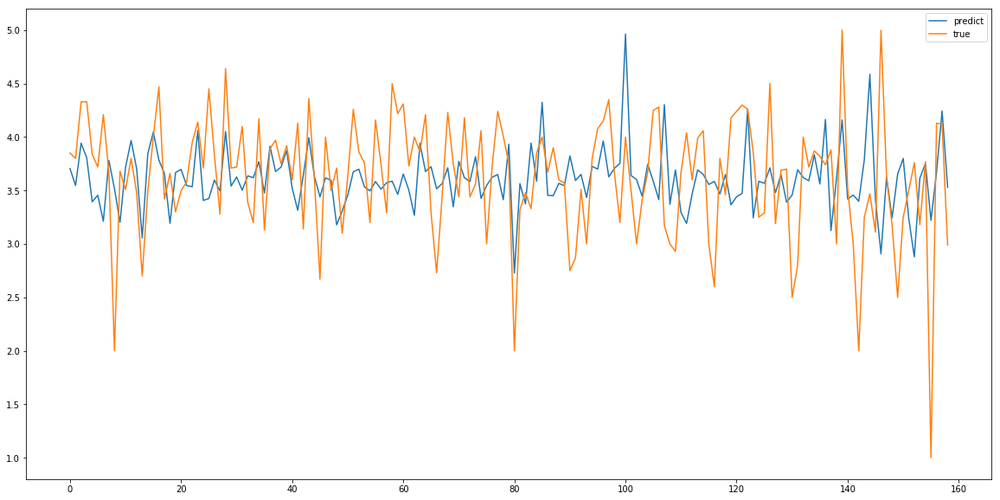

In [59]:
predict_out = model.predict(x_test_norm)
predict_out = [rating_back(x) for x in predict_out]
compare_rating = pd.DataFrame([predict_out, [rating_back(x) for x in y_test_norm]], index=["predict","true"])
compare_rating = compare_rating.astype(float).T
compare_rating.plot(figsize=(20,10))

# PCA

In [4]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
pcaOut = pca.fit_transform(x_train_norm.reshape(-1,23))
pcaDF = pd.DataFrame(pcaOut, columns=['C2', 'C1'])
ax = pcaDF.plot.scatter(x="C2", y="C1", figsize=(10,10), c=list("r"*500+"m"*1200))

# for key, value in pcaDF.iterrows():
# ax.annotate(key, value)

NameError: name 'x_train_norm' is not defined

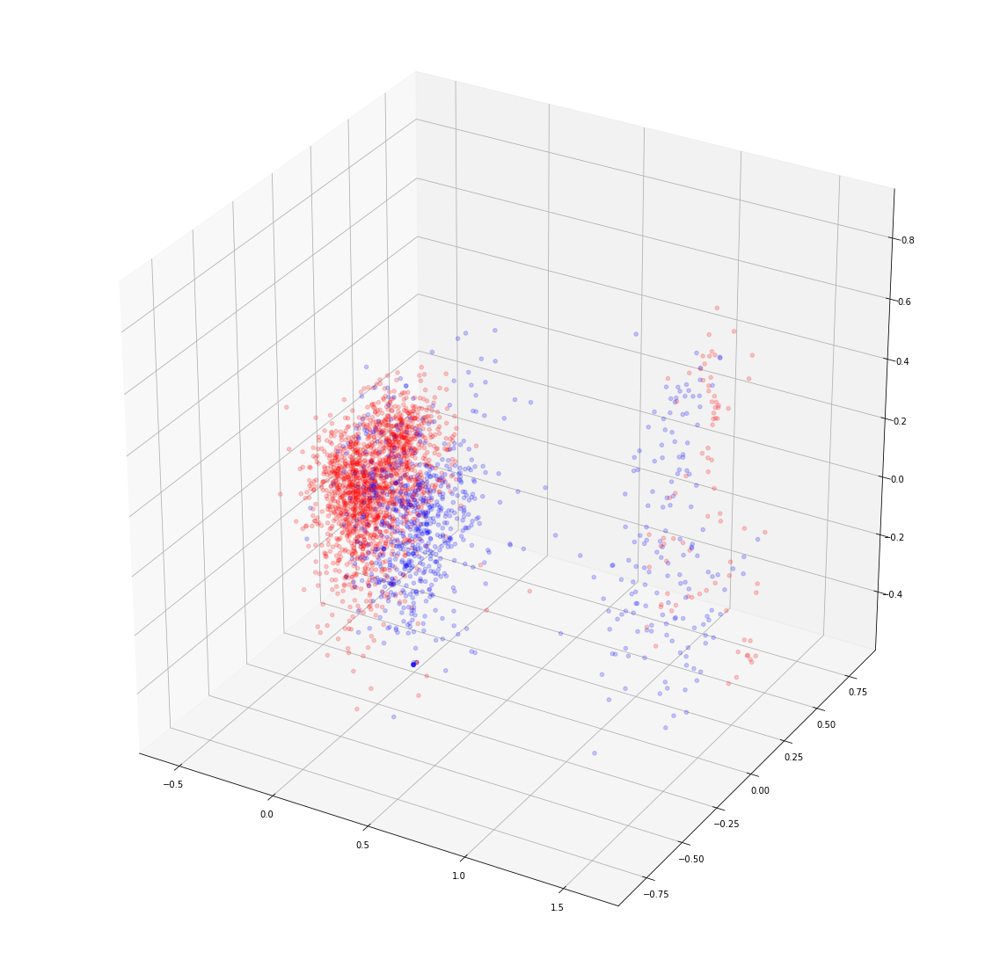

In [29]:
import numpy as np

choice = [x for x in range(1,24)]
array_love = df_love.iloc[:,choice]
array_love = array_love.values
# array_love = (array_love - array_love.min(axis=0)) / (array_love.max(axis=0) - array_love.min(axis=0))
array_science = df_science.iloc[:,choice]
array_science = array_science.values
# array_science = (array_science - array_science.min(axis=0)) / (array_science.max(axis=0) - array_science.min(axis=0))
array_poetry = df_poetry.iloc[:,choice]
array_poetry = array_poetry.values
# array_poetry = (array_poetry - array_poetry.min(axis=0)) / (array_poetry.max(axis=0) - array_poetry.min(axis=0))
array = np.append(np.append(array_love.reshape(-1,len(choice)), array_science.reshape(-1,len(choice)),axis=0),array_poetry.reshape(-1,len(choice)),axis=0)
array = (array - array.min(axis=0)) / (array.max(axis=0) - array.min(axis=0))
pca = PCA(n_components=3)

pcaOut = pca.fit_transform(array)
pcaDF = pd.DataFrame(pcaOut,columns=['C1','C2',"C3"])
fig = plt.figure(figsize=(20,20))
# ax = pcaDF.plot.scatter(x="C1", y="C2", figsize=(10,10), c=list("r"*len(array_love)+"r"*len(array_science)+"b"*len(array_poetry)),alpha=0.1)

ax = fig.add_subplot(111, projection="3d")
ax.scatter(pcaDF['C1'], pcaDF['C2'], pcaDF['C3'],c=list("r"*len(array_love)+"r"*len(array_science)+"b"*len(array_poetry)), alpha=0.2)


In [23]:
import matplotlib
from mpl_toolkits.mplot3d import Axes3D

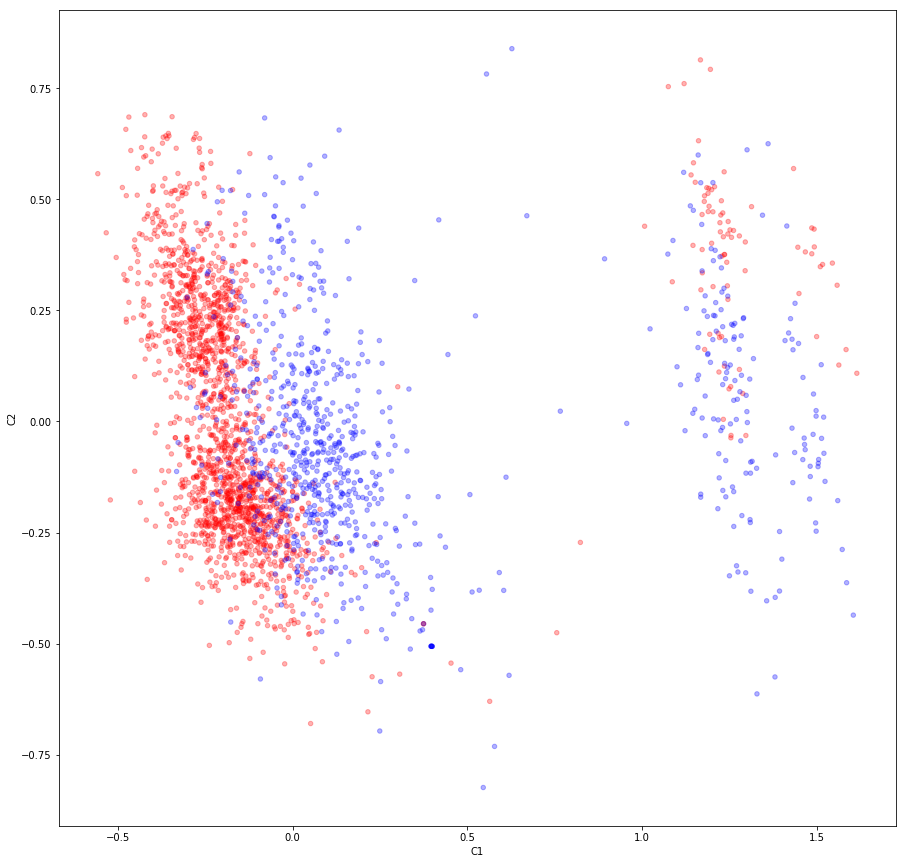

In [33]:
choice = [x for x in range(1,24)]
array_love = df_love.iloc[:,choice]
array_love = array_love.values
# array_love = (array_love - array_love.min(axis=0)) / (array_love.max(axis=0) - array_love.min(axis=0))
array_science = df_science.iloc[:,choice]
array_science = array_science.values
# array_science = (array_science - array_science.min(axis=0)) / (array_science.max(axis=0) - array_science.min(axis=0))
array_poetry = df_poetry.iloc[:,choice]
array_poetry = array_poetry.values
# array_poetry = (array_poetry - array_poetry.min(axis=0)) / (array_poetry.max(axis=0) - array_poetry.min(axis=0))
array = np.append(np.append(array_love.reshape(-1,len(choice)), array_science.reshape(-1,len(choice)),axis=0),array_poetry.reshape(-1,len(choice)),axis=0)
array = (array - array.min(axis=0)) / (array.max(axis=0) - array.min(axis=0))
pca = PCA(n_components=2)

pcaOut = pca.fit_transform(array)
pcaDF = pd.DataFrame(pcaOut,columns=['C1','C2'])
# fig = plt.figure(figsize=(20,20))
ax = pcaDF.plot.scatter(x="C1", y="C2", figsize=(15,15), c=list("r"*len(array_love)+"r"*len(array_science)+"b"*len(array_poetry)),alpha=0.3)

# ax = fig.add_subplot(111, projection="3d")
# ax.scatter(pcaDF['C1'], pcaDF['C2'], pcaDF['C3'],c=list("r"*len(array_love)+"r"*len(array_science)+"b"*len(array_poetry)), alpha=0.2)
